In [1]:
#In this file, I would like to develop a model that can predict intervened points+interventions

In [2]:
import math
import random
from datetime import datetime, timedelta
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
#from pandas.core import datetools
import scipy
from scipy.stats.stats import pearsonr
import pickle
from sklearn.cluster import DBSCAN
import random
import matplotlib.dates as md
import datetime as dt
import time
#from sklearn.neural_network import MLPRegressor, MLPClassifier
#from sklearn.linear_model import LogisticRegression

### Read the Data

In [3]:
# Reading data

def READ(filename):
    df=pd.read_excel(filename)
    # Remove rows with type str in ChartValue
    #df=df.convert_objects(convert_numeric=True)
    return df

# What variables do we have+creating vector of patient ID

def Remove(duplicate): 
    final_list = [] 
    for num in duplicate: 
        if num not in final_list: 
            final_list.append(num) 
    return final_list

def dt_frame_coll(filename):

    df=READ(filename)
    variables=Remove(df.loc[:]['ParameterName'])
    patients=Remove(df.loc[:]['Record_ID'])
    k=-1

    dataframe_collection = {}
    
    for i in patients:
        k=k+1
        l=-1
        p=df.loc[df['Record_ID'] == i]

        #####################################
        ######## Instead of 'variables', I only put HR so that it can read only 'HR'
        # variables
        for j in ['Heart Rate']:
            l=l+1
        
            v=p.loc[p['ParameterName'] == j]
            np_array=np.array(v[:]['ChartValue'])
            x_df=pd.DataFrame(np_array, columns=[j])
            if l==0:
                ID=pd.DataFrame(np.array(v[:]['Record_ID']), columns=['Record_ID'])
                time=pd.DataFrame(np.array(v[:]['ChartDate']), columns=[j+' ChartDate'])
                variable_time0=pd.concat([time,x_df], axis=1)
                variable_time=variable_time0.sort_values(j+' ChartDate')
                variable_time2=pd.DataFrame(np.array(variable_time), columns=[j+' ChartDate', j])
                p_matrix= pd.concat([ID,variable_time2], axis=1)
            
            else:   
                time=pd.DataFrame(np.array(v[:]['ChartDate']), columns=[j+' ChartDate'])
                variable_time0=pd.concat([time,x_df], axis=1)
                variable_time=variable_time0.sort_values(j+' ChartDate')
                variable_time2=pd.DataFrame(np.array(variable_time), columns=[j+' ChartDate', j])
                p_matrix= pd.concat([p_matrix,variable_time2], axis=1)
            

   
        dataframe_collection[k]=p_matrix
    return dataframe_collection, variables, patients

### generate the entire data_frame_collection
filenames = ['Alarm Data 20191121 Patients 1-10.xlsx','Alarm Data 20191121 Patients 11-30.xlsx','Alarm Data 20191121 Patients 31-44.xlsx',
           'Alarm Data 20191121 Patients 45-50.xlsx', 'DH_ALL_PCTL_1-20.xlsx', 'DH_ALL_PCTL_21-32.xlsx',
           'DH_ALL_PCTL_33-50.xlsx', 'DH_ALL_PCTL_51-65.xlsx','DH_ALL_PCTL_66-75.xlsx',
             'DH_ALL_PCTL_76-92.xlsx','DH_ALL_PCTL_93-100.xlsx' ]
dataframe_collection = {}
patients=[]
variables=[]
k=-1
for filename in filenames: 
    collection=dt_frame_coll(filename)
    current_patients=collection[2]
    patients=patients+current_patients
    variables=variables+collection[1]
    
    
    for patient_number in np.arange(np.size(current_patients)):
        k=k+1
        dataframe_collection[k]=collection[0][patient_number]

#### A function to calculate errors

In [7]:
def error(ytest,yhat):
    err=0
    ter=0
    for i in np.arange(np.size(yhat)):
        if ytest[i]>yhat[i]:
            err=err+1
        if yhat[i]>ytest[i]:
            ter=ter+1
        
    error=np.mean(np.abs(ytest-yhat))
    FN=err/max(1,np.sum(ytest)  )     
    FP=ter/(np.size(ytest)-np.sum(ytest))
    return error, FN,FP

### Generate Plots for annotation, round2

In [6]:
patient_numbers=[1,3,7,8,11,14,18,20,27,32,33,34,38,40,48,50,55,56, 57,58,59,66,72,75,78,80,85,91,94,97]

## Patient 82 has stayed 42 days
loc_x=.15
loc_y=0.36
e=0.04


day=0.5

num_plots=0
#selection1+selection2
for patient_number in patient_numbers:

    aa=dataframe_collection[patient_number]
    values=aa['Heart Rate'].dropna()
    time=aa['Heart Rate ChartDate'].dropna()
    
    i=0
    for index in np.arange(50):
        m=int(24*60*day)*index
        k=int(24*60*day)*(index+1)
        
        if m<=np.size(values): 
            i=i+1
            num_plots=num_plots+1

            #fig= plt.figure(figsize=(20,6))
            #plt.plot(time[m:k],values[m:k], color='blue')

            #plt.title('Patient# %d' %patient_number , size=15)


            #plt.xlabel('time (mm-dd-hh)', size=15)
            #plt.xticks( rotation=90 )
            #plt.ylabel('Heart rate (bpm)', size=15)
            #plt.savefig('zpatient%d' %patient_number+'-%d'%i)
            #plt.show()
        else:
            break
            
print('Number of plots in total is %d' %num_plots)

Number of plots in total is 237


### Chunks of abnormal Data from Darren's annotation, round2

In [8]:
patient_numbers=[1,3,7,8,11,14,18,20,27,32,33,34,38,40,48,50,55,56, 57,58,59,66,72,75,78,80,85,91,94,97]

### No. annotation on patient 72, plot 0; patinet 91, plots 1,12,13




patient1=[[140,143],[152,157],[238,268],[807,883],[2309,2328],
          [2417,2446],[2469,2552],[2621,2633],[2660,2663],[2975,2978],[3256,3265],[3454,3460],[3495,3553],[3784,3787],[3993,3998],[4014,4017]]

patient3=[ [251,269], [281,296], [412,428], [753,773], [1634,1656], [1847,1908], [1944,1976],[2985,3000], [3128,3144], [3155,3174], [3249,3262],
         [3295,3305], [3379,3391], [3629,3641], [3856,3863], [4015,4027], [4409,4427], [4597,4608], [4739,4754],[4824, 4836], [4851, 4884],
         [5070, 5088], [5241,5258], [6255, 6335],[7221,7239],[7529,7572],[7660,7686],[7716,7732],[7903,7919],[8598,8618], [8727,8746],[8987,8999],
         [9037,9058], [9071,9089],[10526,10562],[11156,11167],[11319,11325], [11886,11891]]

patient7=[ [1020,1060],[1452,1458],[1519,1527], [1615,1618],[1652,1655],[1685,1690],[2026,2032],[2106,2113],[2563,2577],[3407,3411],[4402,4435],
          [4581,4608],[4986,5010],[5387,5424],[5524,5570],[5637,5660],[6078,6081],[6112,6115],[6157,6162],[6180,6183],[6231,6234],[6266,6270],
         [6316,6320],[6391,6406],[6422,6425],[6693,6696],[6744,6772],[6816,6819],[7044,7047],[7148,7151]  ]

patient8=[[84,107],[181,194],[271,298],[389,392],[777,898],[1008,1048],[1244,1277],[1416,1432]  ]

patient11=[[132,176],[660,693],[811,833],[958,991],[1095,1136],[1193,1223],[1238,1255],[1313,1356],[1419,1440],[1443,1466],[1487,1573],[1643,1673],
          [1795,1818],[1876,1897],[1980,2004],[2037,2050],[2150,2166],[2258,2279],[2280,2296],[2309,2324],[2379,2407],[2488,2506],[2519,2530],
           [2632,2661],[2674,2684],[2703,2719],[2744,2764],[2864,2878],[2793,2800],[2881,2904],[2923,2931],[2970,2982],[3067,3089],[3110,3133],
          [3221,3843]]

patient14=[[0,3],[4,21],[165,184],[243,260],[835,872],[895,905] ]

patient18=[[12,124],[623,648],[666,677],[775,849],[923,960],[986,1021],[1085,1140],[1186,1258],[1305,1344],[1363,1386],[1618,1651],
          [2828,2880],[2991, 3026],[3086,3108],[3258,3270],[3887,3954],[4061,4076],[4224,4250],[4474,4491],[4499,4534],[4635,4674],[4898,4913],
          [5095,5119],[5202,5230]]

patient20=[[156,171],[277,294],[846,849],[865,868] ]

patient27=[[238,346],[859,862],[1169,1173],[1240,1288],[1746,1857],[1988,2045],[2220,2261],[2381,2392],[3110,3157],[3826,3837],[3846,3920],
          [4070,4078],[4450,4458]]

patient32=[[138,143],[338,341],[750,763],[903,917],[943,956],[976,993],[1007,1045],[1052,1085],[1097,1122],[1252,1265],[1266,1279],[1324,1381],
          [1674,1704],[2554,2571],[2605,2617],[2625,2639],[2656,2673],[2681,2702],[3377,3566],[4341,4349],[4436,4482],[4490,4507],[4525,4537],
          [4538,4573],[4600,4627],[4653,4667],[4711,4734],[4749,4786],[4801,4825],[4849,4869],[6425,6444],[6629,6647],[7006,7015],[7061,7092],
          [7116,7280],[8050,8067],[8365,8369],[8775,8779],[9390,9404],[9417,9433],[9440,9454],[10670,10673],[12319,12338],[12601,12666],
           [13892,13910] ]

patient33=[[41,44]]

patient34=[[119,217],[477,480],[518,538],[813,816],[846,855],[916,920],[1063,1066],[1194,1197],[1267,1270],[1429,1434],[1464,1469]]

patient38=[[158,210],[242,264],[302,338],[374,409],[535,546],[752,768],[826,830],[925,929],[1262,1266],[1284,1295],[1300,1306],[1338,1359],
          [1455,1480],[1532,1559],[1982,1988],[2484,2500],[2620,2633]]

patient40=[[290,435],[437,460],[567,587],[588,623]]

patient48=[[0,15],[15,30],[36,47],[46,54],[116,119],[222,233],[841,866],[1079,1083],[1563,1580],[1935,1959],[2178,2182],[2185,2199],[2272,2280],
          [2280,2287],[2286,2293],[2292,2300],[2346,2354],[2355,2360],[2377,2383],[2382,2388],[2537,2559],[2675,2689]]

patient50=[[632,653],[662,686],[761,775],[860,898],[1056,1064],[1065,1102],[1218,1239],[1781,1791],[2004,2019],[2246,2269],[2458,2469],[2651,2673],
          [2905,2921],[3145,3160],[3159,3181],[3199,3236],[3283,3306],[3307,3355],[3400,3414],[3441,3470],[3507,3530],[3617,3639],[4234,4277],
          [4276,4320],[4431,4460],[4712,4769],[5013,5031],[5338,5348],[5372,5406],[5482,5498],[5733,5758],[5830,5836],[5962,5967],[6011,6044]]
          
patient55=[[207,351],[532,548],[567,576],[1000,1008],[1195,1226],[1282,1308],[1368,1392],[1393,1411],[1420,1431],[1460,1479],[1480,1500],[1822,1833],
          [1854,1866],[1865,1880],[1901,1912],[2011,2021],[2046,2056],[2073,2084],[2090,2097],[2101,2105],[2151,2155],[2645,2661],[2676,2680],
          [2686,2727],[3143,3150],[3495,3511],[3654,3678],[3757,3770],[3829,3848],[3926,3937],[4005,4016],[4089,4101],[4107,4114],[4147,4159],
          [4177,4192],[4193,4202],[4201,4220],[4849,4862],[4877,4884],[5157,5170],[5540,5552],[5575,5604],[5935,5957],[6095,6108],[6154,6159],
          [6193,6196],[6222,6235],[6372,6393],[6434,6459],[6521,6543],[6662,6687],[6747,6766],[6800,6831],[6931,6974],[7087,7108],[7107,7137],
          [7597,7600]]

patient56=[[26,42],[183,208],[317,335],[567,611],[635,715],[909,971],[980,1011],[1133,1163],[1270,1320],[1406,1437],[1454,1467],[1529,1540],
           [1578,1584],[1620,1627],[1642,1651],[1704,1718],[1737,1765],[1766,1800],[1873,1935],[2181,2188],[2334,2349]]


patient57=[[764,770],[823,830],[961,986],[994,1003],[1155,1162],[1166,1173],[1186,1193],[1217,1220],[1229,1234],[1245,1253],[1271,1279],[1281,1304],
          [1303,1318],[1335,1355],[1372,1396],[1419,1438],[1447,1453],[1455,1463],[1734,1739],[1740,1744],[1749,1766],[1856,1944],[2322,2347],
          [2353,2373],[2795,2812],[2840,2860],[2880,2936],[3144,3175],[3210,3235],[3254,3286],[3304,3352],[3760,3763],[4189,4193],[4222,4225],
          [4664,4667],[5200,5205],[5765,5769],[6238,6242],[6101,6104],[7327,7352],[7488,7502],[7508,7524],[8359,8362],[8498,8501],[8519,8522],
          [9215,9218],[10304,10307],[10882,10885],[10884,10888]]

patient58=[[0,10],[12,32],[42,57],[94,107],[120,139],[140,161],[744,761],[800,828],[925,943],[1189,1204],[1222,1242],[1245,1282],[1446,1491],
          [1658,1670],[1965,2000],[2092,2130],[2329,2351],[2390,2409],[2498,2540],[2546,2559],[2564,2587],[2621,2639],[2670,2783],[2828,2859],
          [3047,3097],[3122,3151],[3333,3484],[3994,4029],[4147,4176],[4206,4243],[4260,4283],[4397,4402],[5471,5515],[5537,5669],[7358,7361],
          [8782,8814],[9864,9890],[9900,9925],[9941,9990],[9993,10080],[11405,11459],[11722,11779],[11842,11871],[11886,11934],[12058,12122],
          [13821,13826]]

patient59=[[20,39],[113,126],[184,194],[201,216],[342,368],[427,443],[512,548],[575,592],[617,649],[796,820],[821,831],[904,935],[998,1027],
          [1057,1077],[1171,1190],[1327,1340],[1516,1537],[1592,1643],[1848,1875],[1955,2035],[2377,2469],[2538,2601]]

patient66=[[120,144],[222,240],[1039,1061],[1474,1504],[1574,1594],[1607,1625],[1758,1810],[2013,2048],[2492,2527],[2686,2689]]

patient72=[[1344,1375],[1397,1428],[1486,1528],[1528,1557],[1682,1727],[1832,1854]]

patient75=[[224,373],[1188,1243],[1365,1440],[2598,2790],[3423,3497],[4895,4968],[5004,5133],[5171,5174],[5259,5262],[5341,5344],[5981,6041],
          [6168,6220],[6239,6416],[8100,8125],[8292,8303],[8371,8376],[8389,8395],[8425,8428],[8910,8913],[9315,9530],[10361,10398] ]

#Hamed
patient78=[[752,982],[1478,1547],[1816,1819],[2647,2654]]

patient80=[]

patient85=[[134,137],[188,193],[202,205],[352,361],[402,405],[422,425],[426,428],[431,434],[533,539],[619,623],[639,713],[844,875],
           [960,977],[1007,1012],[1026,1035],[1169,1174],[1232,1256],[1339,1349],[1462,1471],[1512,1525],[1718,1795],[2125,2133],[3063,3066]]

patient91=[[56,60],[65,72],[78,85],[90,93],[101,104],[103,107],[106,112],[112,117],[116,119],[137,141],[159,167],[166,169],[173,178],
           [1476,1481],[5548,5609],[6115,6117],[6299,6301],[6629,6751],[6755,6763],[6893,6896],[6950,6953],[6956,6959],[6997,7000],[7110,7113],
           [8242,8245],[8368,8371],[8412,8415],[8454,8457],[8464,8467],[8475,8475],[8493,8495],[11652,11655],[11665,11668],[11681,11684],
           [11700,11703],[11728,11731],[11878,11881],[11893,11896],[11916,11919],[11960,11963],[12018,12021],[12049,12052]]

patient94=[[14,16],[29,37],[47,53],[116,119],[223,233],[841,866],[1079,1083],[1570,1572],[1573,1577],[2179,2182],[2190,2197],[2272,2294],
           [2346,2351],[2355,2360],[2379,2388],[2546,2550],[2675,2679],[2680,2683]]

patient97=[[177,199],[417,449],[1354,1569],[3757,3801],[4250,4260],[5287,5460],[5485,5593],[5634,5709],[5788,5791],[7739,7914],[8443,8520],
           [9163,9263],[9881,9994],[10625,10723],[11206,11251],[11323,11425],[11485,11496],[11982,12098],[12659,12807]]


patient_group=[patient1,patient3,patient7,patient8,patient11,patient14,patient18,patient20,patient27,patient32,patient33,patient34,patient38,patient40,patient48,patient50,patient55,patient56,patient57,patient58,patient59,patient66,patient72,patient75,patient78,
              patient80,patient85,patient91,patient94,patient97]

### Put all intervention lengths in the intervene vector
interventions=np.zeros(10000)
k=-1

for i in np.arange(np.size(patient_numbers)):
    #print('patient%d' %patient_numbers[i])
    for chunk in patient_group[i]:
        k=k+1
        interventions[k]=chunk[1]-chunk[0] 

intervene=interventions[interventions>0]
print('mean length of intervention is %d minutes' %np.mean(intervene))
print('total number of annotations is %d'%np.size(intervene))
np.quantile(intervene,0.75)

mean length of intervention is 26 minutes
total number of annotations is 645


30.0

### What fraction is intervention and artifacts?

In [ ]:
A=0
B=0

for i in np.arange(np.size(patient_numbers)):
        
    patient_num=patient_numbers[i]
    aa=dataframe_collection[patient_num]
    values=aa['Heart Rate'].dropna()
    A=A+np.size(values)
    for chunk in patient_group[i]:
        B=B+chunk[1]-chunk[0]
c=B/A
print('The fraction of intervened data points is %f' %c)

### Print all annotation for stoare purpose

In [82]:
print('patient1')
print(patient1)
print('patient3')
print(patient3)
print('patient7')
print(patient7)
print('patient8')
print(patient8)
print('patient11')
print(patient11)
print('patient14')
print(patient14)
print('patient18')
print(patient18)
print('patient20')
print(patient20)
print('patient27')
print(patient27)
print('patient32')
print(patient32)
print('patient33')
print(patient33)
print('patient34')
print(patient34)
print('patient38')
print(patient38)
print('patient40')
print(patient40)
print('patient48')
print(patient48)
print('patient50')
print(patient50)
print('patient55')
print(patient55)
print('patient56')
print(patient56)
print('patient57')
print(patient57)
print('patient58')
print(patient58)
print('patient59')
print(patient59)
print('patient66')
print(patient66)
print('patient72')
print(patient72)
print('patient75')
print(patient75)
print('patient78')
print(patient78)
print('patient85')
print(patient85)
print('patient91')
print(patient91)
print('patient94')
print(patient94)
print('patient97')
print(patient97)

patient1
[[140, 143], [152, 157], [238, 268], [807, 883], [2309, 2328], [2417, 2446], [2469, 2552], [2621, 2633], [2660, 2663], [2975, 2978], [3256, 3265], [3454, 3460], [3495, 3553], [3784, 3787], [3993, 3998], [4014, 4017]]
patient3
[[251, 269], [281, 296], [412, 428], [753, 773], [1634, 1656], [1847, 1908], [1944, 1976], [2985, 3000], [3128, 3144], [3155, 3174], [3249, 3262], [3295, 3305], [3379, 3391], [3629, 3641], [3856, 3863], [4015, 4027], [4409, 4427], [4597, 4608], [4739, 4754], [4824, 4836], [4851, 4884], [5070, 5088], [5241, 5258], [6255, 6335], [7221, 7239], [7529, 7572], [7660, 7686], [7716, 7732], [7903, 7919], [8598, 8618], [8727, 8746], [8987, 8999], [9037, 9058], [9071, 9089], [10526, 10562], [11156, 11167], [11319, 11325], [11886, 11891]]
patient7
[[1020, 1060], [1452, 1458], [1519, 1527], [1615, 1618], [1652, 1655], [1685, 1690], [2026, 2032], [2106, 2113], [2563, 2577], [3407, 3411], [4402, 4435], [4581, 4608], [4986, 5010], [5387, 5424], [5524, 5570], [5637, 5660]

### Create TPM

In [684]:
variable_of_interest='Heart Rate'
states=[3*i+46 for i in np.arange(37)]
header=[str(i) for i in states]
variable_of_interest='Heart Rate'
 

def bin(x):
    
    #if x<=40:
        #return int(40)
    #if x>=160:
        #return int(160)    
    if x%3==0:
        return int(x+1)
    if x%3==1:
        return int(x)
    if x%3==2:
        return int(x-1)

initial=[]

for i in np.arange(np.size(header)):
    initial=initial+[0]
    
TPM_coll={}

TPM={i:initial for i in header} 
TPM=pd.DataFrame(TPM,index=header,columns=header)

pd.set_option('display.max_columns', 60)


aa=dataframe_collection[2]
values=aa['Heart Rate']
n=np.size(values)
one_minute=(aa['Heart Rate ChartDate'][11]-aa['Heart Rate ChartDate'][10])

#test_patients
#patient_numbers

desired_patient_set=patient_numbers
#test_patients

for patient_num in desired_patient_set:
    
    aa=dataframe_collection[patient_num]
    values=aa['Heart Rate'].dropna()
    time=aa['Heart Rate ChartDate'].dropna()
        
    values=np.array(values)
    time=np.array(time)

             
    ### Calculate number of transitions between states
    
    for q in np.arange(np.size(values)-1):
        if (values[q]<=155)&(values[q]>=45)&(values[q+1]<=155)&(values[q+1]>=45):
            i=str(bin(values[q]))
            j=str(bin(values[q+1]))
            TPM.loc[[i],[j]]=TPM.loc[[i],[j]]+1

            
TPM_counts=TPM
for l in header:
    a=TPM.loc[[l]]
    TPM.loc[[l]]=a/max(1,np.sum(np.array(a)))


#%store TPM

### Create TPMR

In [685]:
variable_of_interest='Heart Rate'

header=[str(i) for i in states]

initial=[]

for i in np.arange(np.size(header)):
    initial=initial+[0]
    
TPMR_coll={}

TPMR={i:initial for i in header} 
TPMR=pd.DataFrame(TPMR,index=header,columns=header)

pd.set_option('display.max_columns', 60)


aa=dataframe_collection[2]
values=aa['Heart Rate']
time=aa['Heart Rate ChartDate']
time=np.array(time)
one_minute=(time[11]-time[10])


#test_patients
#patient_numbers

desired_patient_set=patient_numbers

for patient_num in desired_patient_set:
    aa=dataframe_collection[patient_num]
    values=aa['Heart Rate'].dropna()
    time=aa['Heart Rate ChartDate'].dropna()
    
    values=np.array(values)
    time=np.array(time)
    
    ### remove the abnormal chunks
    for chunk in patient_group[ np.where(np.array(patient_numbers)==patient_num)[0][0] ]:
        values[range(chunk[0],chunk[1])]=-1  

             
    ### Calculate number of transitions between states
    
    for q in np.arange(np.size(values)-1):

        if time[q+1]-time[q]<=one_minute:
            if (values[q]<=155)&(values[q]>=45)&(values[q+1]<=155)&(values[q+1]>=45):
                i=str(bin(values[q]))
                j=str(bin(values[q+1]))
                TPMR.loc[[i],[j]]=TPMR.loc[[i],[j]]+1

            
TPMR_counts=TPMR
for l in header:
    a=TPMR.loc[[l]]
    TPMR.loc[[l]]=a/max(1,np.sum(np.array(a)))


#%store TPMR  

In [ ]:
pd.DataFrame(store_matrix)

### Create TPM_ML

In [189]:
states=[3*i+46 for i in np.arange(37)]
header=[str(i) for i in states]

def bin(x):
    
    #if x<=40:
        #return int(40)
    #if x>=160:
        #return int(160)    
    if x%3==0:
        return int(x+1)
    if x%3==1:
        return int(x)
    if x%3==2:
        return int(x-1)
    
initial=[]

for i in np.arange(np.size(header)):
    initial=initial+[0]
    
TPMML_coll={}

TPMML={i:initial for i in header} 
TPMML=pd.DataFrame(TPMML,index=header,columns=header)

pd.set_option('display.max_columns', 60)

### generate one_minute
aa=dataframe_collection[2]
values=aa['Heart Rate']
time=aa['Heart Rate ChartDate']
time=np.array(time)
one_minute=(time[11]-time[10])


#test_patients
#patient_numbers

desired_patient_set=np.arange(1,100)
#test_patients

errors=np.zeros((3,len(desired_patient_set)))
lens=np.zeros(len(desired_patient_set))
ki=-1

for patient_num in desired_patient_set:
    ki=ki+1
    
    aa=dataframe_collection[patient_num]
    values=aa['Heart Rate'].dropna()
    time=aa['Heart Rate ChartDate'].dropna()
    
    values=np.array(values)
    time=np.array(time)
    
    ### remove the abnormal chunks
    #all_predictions[patient_num]
    #labe=np.zeros(len(values))
    #for chunk in patient_group[ np.where(np.array(patient_numbers)==patient_num)[0][0] ]:
        #labe[range(chunk[0],chunk[1])]=1
    
    #################
    ### which data to exclude
    pred=all_predictions[patient_num]
    
    ########################
    ##### If you wana predict labels from scratch, activate this part
    #pred=np.zeros(current_size)
    #k=15
    #pred[k+1:current_size-k]=model_NN.predict(Xtest)
    ###########################
    ###########################
    
    values[pred>0]=-1 
    
    
    #ee=error(labe,pred)
    #errors[0,ki]=ee[0]
    #errors[1,ki]=ee[1]
    #errors[2,ki]=ee[2]
    #lens[ki]=len(values)
    #print(ee)

             
    ### Calculate number of transitions between states
    
    for q in np.arange(np.size(values)-1):
        if time[q+1]-time[q]<=one_minute:
            if (values[q]<=155)&(values[q]>=45)&(values[q+1]<=155)&(values[q+1]>=45):
                i=str(bin(values[q]))
                j=str(bin(values[q+1]))
                TPMML.loc[[i],[j]]=TPMML.loc[[i],[j]]+1

            
TPMML_counts=TPMML
for l in header:
    a=TPMML.loc[[l]]
    TPMML.loc[[l]]=a/max(1,np.sum(np.array(a)))


%store TPMML 


#lens=lens/np.sum(lens)
#t_er=np.dot(lens,errors[0,:])
#fn_er=np.dot(lens,errors[1,:])
#fp_er=np.dot(lens,errors[2,:])
#print('error is:%f'%t_er)
#print('FN error is:%f'%fn_er)
#print('FP error is:%f'%fp_er)

Stored 'TPMML' (DataFrame)


In [242]:
TPMML.to_excel (r'TPMML_july.xlsx', index = False, header=True)

### Compare TPM and TPMR

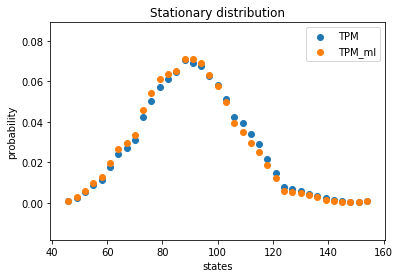

In [192]:
#### startionary distribution
P=pd.DataFrame(np.linalg.matrix_power(TPM, 600))
#P_r=pd.DataFrame(np.linalg.matrix_power(TPMR, 600))
P_ml=pd.DataFrame(np.linalg.matrix_power(TPMML, 600))

plt.scatter(states,P.iloc[0,:], label='TPM')
#plt.scatter(states,P_r.iloc[0,:], label='TPM_r')
plt.scatter(states,P_ml.iloc[0,:], label='TPM_ml')
plt.title('Stationary distribution')
plt.xlabel('states')
plt.ylabel('probability')
plt.legend()
plt.show()

In [195]:
#dist = np.linalg.norm(TPMR-TPM)
#dist
n=len(states)
delta_p=np.zeros((n,n))
delta_p_ml=np.zeros((n,n))
delta_p_total=np.zeros((n,n))
for i in range(n):
    for j in range(n):
        #delta_p[i,j]=np.abs(np.array(TPMR)[i][j]-np.array(TPM)[i][j])
        #delta_p_ml[i,j]=np.abs(np.array(TPMR)[i][j]-np.array(TPMML)[i][j])
        delta_p_total[i,j]=np.abs(np.array(TPM)[i][j]-np.array(TPMML)[i][j])
        
#dist=np.linalg.norm(delta_p)
#dist_ml=np.linalg.norm(delta_p_ml)
dist_total=np.linalg.norm(delta_p_total)
#print('distance between TPM and TPMR is: %f'%dist)
#print('distance between TPMML and TPMR is: %f'%dist_ml)
print('distance between TPMML and TPM is: %f'%dist_total)

#delta=pd.DataFrame(100*delta_p)

#np.round(delta[delta>1],3).to_excel (r'delta.xlsx', index = True, header=True)
#delta[delta>1]

distance between TPMML and TPM is: 0.259871


In [718]:
d=0
for i in range(n):
    for j in range(n):
        dist=(np.abs(np.array(TPMR)[i][j]-np.array(TPM)[i][j]))
        d=d+dist
        
np.linalg.norm(delta_p, ord=2)

0.1424092210549144

In [716]:
d

2.2053228967829184

In [705]:
for i in range(n):
    for j in range(n):
        if np.abs(np.array(TPM)[i,j]-np.array(TPM)[i][j])>1e-6:
            print('Hi')

In [704]:
np.array(TPM)[1][1]

0.5379213483146067

### Create a loop that drops out 1 patinet at a time to calculate distances bet

In [415]:
from sklearn.neural_network import MLPRegressor, MLPClassifier
from sklearn.linear_model import LogisticRegression
pd.set_option('display.max_columns', 60)

#XX=pd.DataFrame(X)
#XX['label']=y

data_lengths=np.zeros(len(patient_numbers))
for i in np.arange(len(patient_numbers)):
  patient_num=patient_numbers[i]
  aa=dataframe_collection[patient_num]
  values=aa[['Heart Rate']].dropna()
  data_lengths[i]=int(len(values))

half_of_prediction={}
mat_distances={}
errors=np.zeros((3,len(patient_numbers)))
ki=-1
for i in range(8,len(patient_numbers)):
  ki=ki+1
  test_patients=patient_numbers[0:i+1]
  patient_num=patient_numbers[i]
  print('patient number:%d'%patient_num)
  index=i

  loc1=int( np.sum(data_lengths[0:index])-31*np.size(data_lengths[0:index]) )
  loc2=int( np.sum(data_lengths[0:index+1])-31*np.size(data_lengths[0:index+1]) )

  test_set=XX[loc1:loc2]
  train_set=XX.drop(range(loc1,loc2))
  #############
  ##### Shuffle
  train_set = train_set.sample(frac=1).reset_index(drop=True)
  Xtrain=np.array(train_set.loc[:,train_set.columns != 'label'])
  ytrain = np.array(train_set['label'])

  Xtest=np.array( test_set.loc[:,test_set.columns != 'label'])
  ytest = np.array(test_set['label'])
  ### Neural network model
  model_NN = MLPClassifier(hidden_layer_sizes=(100,90),alpha=0.0001,max_iter=400,solver='adam')
  model_NN.fit( Xtrain ,ytrain  )
  
  current_size=int(data_lengths[index])
  ypred=np.zeros(current_size)
  k=15
  ypred[k+1:current_size-k]=model_NN.predict(Xtest)
  half_of_prediction[patient_num]=ypred
  ######################
  ##### Create TPM's
  initial=[]
  for mm in np.arange(np.size(header)):
    initial=initial+[0]
    
  TPM_coll={}
  TPM={m1:initial for m1 in header} 
  TPM=pd.DataFrame(TPM,index=header,columns=header)

  TPMR_coll={}
  TPMR={m2:initial for m2 in header} 
  TPMR=pd.DataFrame(TPMR,index=header,columns=header)

  TPMML_coll={}
  TPMML={m3:initial for m3 in header} 
  TPMML=pd.DataFrame(TPMML,index=header,columns=header)
    
  aa=dataframe_collection[patient_num]
  values=aa['Heart Rate'].dropna()
  time=aa['Heart Rate ChartDate'].dropna()
  values=np.array(values)
  values2=np.copy(values)
  values3=np.copy(values)
  time=np.array(time)

  labe=np.zeros(len(values))        
  for chunk in patient_group[index]:
    labe[range(chunk[0],chunk[1])]=1
    values2[range(chunk[0],chunk[1])]=-1 

  values3[ypred>0]=-1 
  ##################
  #### Calculate error
  ee=error(labe,ypred)
  errors[0,ki]=ee[0]
  errors[1,ki]=ee[1]
  errors[2,ki]=ee[2]
  print('Errors:')
  print(ee)
  
  for q in np.arange(np.size(values)-1):
    if (values[q]<=155)&(values[q]>=45)&(values[q+1]<=155)&(values[q+1]>=45):
      i1=str(bin(values[q]))
      j1=str(bin(values[q+1]))
      TPM.loc[[i1],[j1]]=TPM.loc[[i1],[j1]]+1

    if time[q+1]-time[q]<=np.timedelta64(60000000000,'ns'):
      if (values2[q]<=155)&(values2[q]>=45)&(values2[q+1]<=155)&(values2[q+1]>=45):
        i2=str(bin(values[q]))
        j2=str(bin(values[q+1]))
        TPMR.loc[[i2],[j2]]=TPMR.loc[[i2],[j2]]+1
      if (values3[q]<=155)&(values3[q]>=45)&(values3[q+1]<=155)&(values3[q+1]>=45):
        i3=str(bin(values[q]))
        j3=str(bin(values[q+1]))
        TPMML.loc[[i3],[j3]]=TPMML.loc[[i3],[j3]]+1
          
  TPM_counts=TPM
  for l in header:
      a=TPM.loc[[l]]
      TPM.loc[[l]]=a/max(1,np.sum(np.array(a)))
  #############
  TPMR_counts=TPMR
  for l in header:
      a=TPMR.loc[[l]]
      TPMR.loc[[l]]=a/max(1,np.sum(np.array(a)))
  ##################
  TPMML_counts=TPMML
  for l in header:
      a=TPMML.loc[[l]]
      TPMML.loc[[l]]=a/max(1,np.sum(np.array(a)))
  ###################
  ####### calculate differences
  nn=len(states)
  delta_p=np.zeros((nn,nn))
  delta_p_ml=np.zeros((nn,nn))
  for ii in range(nn):
    for jj in range(nn):
      delta_p[ii,jj]=np.abs(np.array(TPMR)[ii][jj]-np.array(TPM)[ii][jj])
      delta_p_ml[ii,jj]=np.abs(np.array(TPMR)[ii][jj]-np.array(TPMML)[ii][jj])
        
  dist=np.linalg.norm(delta_p)
  dist_ml=np.linalg.norm(delta_p_ml)
  result=np.array([dist,dist_ml])
  print('matrix distances')
  print(result)
  mat_distances[patient_num]=result

###############
##### Print summary of results
lens=np.copy(data_lengths)
lens=lens/np.sum(lens) ### I edited this later
t_er=np.dot(lens,errors[0,:])
fn_er=np.dot(lens,errors[1,:])
fp_er=np.dot(lens,errors[2,:])

print('average error is:%f'%t_er)
print('average FN error is:%f'%fn_er)
print('average FP error is:%f'%fp_er)

dist_tpm=0
dist_tpmml=0
for h in np.arange(len(patient_numbers)):
  patient_num=patient_numbers[h]
  dist_tpm=dist_tpm+mat_distances[patient_num][0]
  dist_tpmml=dist_tpmml+mat_distances[patient_num][1]

print('average distance between TPM and TPMR:')
print(dist_tpm/len(patient_numbers))

print('average distance between TPMML and TPMR:')
print(dist_tpmml/len(patient_numbers))
print(np.shape(X))

patient number:27
Errors:
(0.14436387607119314, 0.7024482109227872, 0.07064676616915423)
matrix distances
[2.2777678  1.58623725]
patient number:32
Errors:
(0.13397975794465283, 0.5654664484451718, 0.09312776013016193)
matrix distances
[1.024991   0.50578233]
patient number:33
Errors:
(0.14882506527415143, 1.0, 0.14659685863874344)
matrix distances
[1.00449668 1.02329148]
patient number:34
Errors:
(0.12701149425287356, 0.8141025641025641, 0.059343434343434344)
matrix distances
[1.18087276 1.25254891]
patient number:38
Errors:
(0.13824534751234333, 0.8964401294498382, 0.037435456110154905)
matrix distances
[0.38877742 0.39187926]
patient number:40
Errors:
(0.16417910447761194, 0.7085201793721974, 0.04069175991861648)
matrix distances
[1.75436859 1.73627611]
patient number:48
Errors:
(0.04998175848230573, 0.5126050420168067, 0.0059928086296444265)
matrix distances
[1.74016642 1.69351756]
patient number:50
Errors:
(0.12175324675324675, 0.49445129469790383, 0.06524584034398953)
matrix dist

KeyError: 1

In [ ]:
patient number:1
Errors:
(0.11174713787954206, 0.829971181556196, 0.04385725960228821)
[2.17639085 1.283186  ]
patient number:3
Errors:
(0.0825953819415708, 0.7224383916990921, 0.038985148514851485)
[2.01607206 1.80110327]
patient number:7
Errors:
(0.06673168013374199, 0.7723577235772358, 0.02849170215890733)
[0.19547913 1.15979405]
patient number:8
Errors:
(0.1099290780141844, 0.5942028985507246, 0.03121319199057715)
[1.69476077 1.44670308]
patient number:11
Errors:
(0.2621827411167513, 0.5881533101045296, 0.07544910179640718)
[2.27442227 2.00313241]
patient number:14
Errors:
(0.10707269155206287, 0.44660194174757284, 0.06885245901639345)
[2.4669372  0.97038622]
patient number:18
Errors:
(0.1615614493836384, 0.6013289036544851, 0.07234329364187823)
[1.55669575 1.038017  ]
patient number:20
Errors:
(0.051329055912007336, 0.9210526315789473, 0.019943019943019943)
[1.00252841 0.75487573]
patient number:27

In [436]:
dist_tpm=0
dist_tpmml=0
for h in np.arange(len(patient_numbers)):
    patient_num=patient_numbers[h]
    dist_tpm=dist_tpm+mat_distances[patient_num][0]
    dist_tpmml=dist_tpmml+mat_distances[patient_num][1]

print('average distance between TPM and TPMR:')
print(dist_tpm/len(patient_numbers))

print('average distance between TPMML and TPMR:')
print(dist_tpmml/len(patient_numbers))
print(np.shape(X))

average distance between TPM and TPMR:
1.4651962439308706
average distance between TPMML and TPMR:
1.337901786381983
(159447, 320)


### Compare the output under TPM and TPM_r

Average FP difference is :0.084450
Average FN difference is :0.006883
Difference of false negatives is:
[0.    0.    0.    0.    0.    0.    0.    0.001 0.002 0.001 0.    0.001
 0.001 0.001 0.003 0.002 0.002 0.002 0.002 0.001 0.001 0.002 0.002 0.001
 0.001 0.001 0.001 0.001 0.    0.    0.    0.003 0.004 0.003 0.003 0.022
 0.02  0.016 0.013 0.01 ]
Difference of false positive is:
[ 0.    -0.    -0.016 -0.01  -0.023 -0.03  -0.006 -0.014 -0.045 -0.012
 -0.015 -0.018 -0.023 -0.02  -0.036 -0.049 -0.041 -0.047 -0.019 -0.014
 -0.013 -0.012 -0.011 -0.011 -0.016 -0.013 -0.018 -0.012 -0.006 -0.006
 -0.    -0.03  -0.037 -0.038 -0.05  -0.191 -0.184 -0.186 -0.185 -0.158]


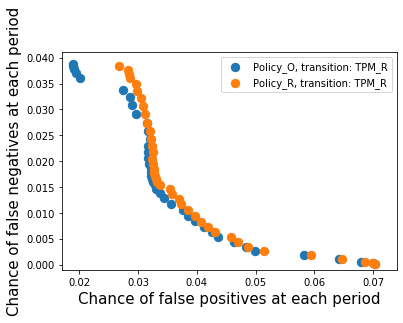

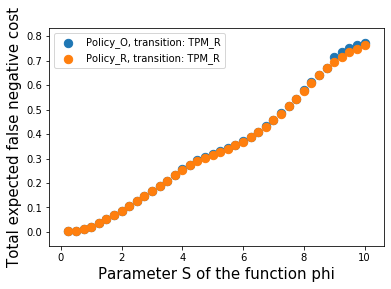

In [3]:
### I did the calculation in "https://colab.research.google.com/drive/1K4dli9n2txEGzQ3bTcrcAjNVrzLfDUtQ?authuser=1#scrollTo=2JcQbtk_wSvt"
### I just include the results here





#FP_OO=np.array([1.41574514, 1.41104157, 1.3686572,  1.29446695, 1.1761055,  1.01527922,
 #0.98326756, 0.93943729, 0.88448887, 0.86461707, 0.83709083, 0.80785302,
 #0.78332524, 0.76337695, 0.72248892, 0.70125928, 0.68468153, 0.67179147,
 #0.66628342, 0.66213837])

FP_OR=np.array([1.39765772, 1.39300295, 1.34981527, 1.27560232, 1.15724984, 0.99379002,
 0.96258681, 0.91969631, 0.86555675, 0.84607981, 0.81936851, 0.79043279,
 0.76652221, 0.74719703, 0.70716069, 0.68575307, 0.66984586, 0.65762417,
 0.65232646,
 0.64843342, 0.64474184, 0.64123784, 0.6401724,  0.63981918, 0.63302695,
 0.63148011, 0.63100563, 0.63171946, 0.63531548, 0.63048346, 0.62613201,
 0.59088488, 0.57585835, 0.56760175, 0.54429737, 0.39862205, 0.38486444,
 0.38003648, 0.37738785, 0.37493055])


FN_OR=np.array([0.00303579, 0.00519462, 0.01149076, 0.02217235, 0.03596985, 0.05182819,
 0.06819784, 0.08691481, 0.10725286, 0.12648476, 0.14614396, 0.16656246,
 0.18793494, 0.21009258, 0.23460699, 0.25627884, 0.27557634, 0.29251813,
 0.30581262,
 0.31774564, 0.32946194, 0.3418618,  0.35527183, 0.37013316, 0.38807542,
 0.40863458, 0.43170779, 0.45739854, 0.4842902,  0.51411337, 0.54521417,
 0.58008329, 0.61311524, 0.64296717, 0.67172144, 0.71620615, 0.73510473,
 0.75010015, 0.76249098, 0.77272459])



FP_RR=np.array([1.39765772, 1.39323753, 1.36608754, 1.28529602, 1.18064082, 1.02406915,
 0.96892332, 0.93369428, 0.91084406, 0.85839325, 0.83392238, 0.80798731,
 0.78976706, 0.76669967, 0.74343271, 0.73488744, 0.71048413, 0.70432627,
 0.67166075, 
 0.66208772, 0.65732321, 0.65346118, 0.65109059, 0.65094752, 0.648587,
 0.64399785, 0.64855905, 0.64370717, 0.64139353, 0.63639387, 0.62662556,
 0.62046828, 0.61273171,0.60531914, 0.59426443, 0.58977616 ,0.56923459,
 0.56604223, 0.56276971, 0.53298329])






FN_RR=np.array([0.00303579, 0.00519436, 0.01143458, 0.02208662, 0.03583888, 0.05151346,
 0.06801993, 0.08635229, 0.10568381, 0.12581618, 0.14581349, 0.16566835,
 0.18668533, 0.20871747, 0.23152461, 0.2538557,  0.2734878,  0.29024188,
 0.30423374,
 0.31640393, 0.32805597, 0.34023973, 0.35361952, 0.3690263,  0.38691134,
 0.40773799, 0.431059,   0.45630749, 0.48382362, 0.51362092, 0.54520192,
 0.5775588,  0.60957781, 0.64028978, 0.66871576, 0.69386324, 0.71559615,
 0.73403244, 0.74957647, 0.76244514])




FN_OO=np.array([0.00324388, 0.00576203, 0.01290661, 0.02495582, 0.04017365, 0.05699342,
 0.07560269, 0.0961323,  0.11794364, 0.13976715, 0.16168865, 0.18406923,
 0.20760615, 0.23277789, 0.25833217, 0.28180546, 0.30231149, 0.32007254,
 0.33510443,
 0.34883578, 0.36241511, 0.37698701, 0.39341045, 0.412253,   0.43407756,
 0.45931286, 0.48808452, 0.52000584, 0.55377344, 0.58941039, 0.62645136,
 0.66399442, 0.70039672, 0.73479807, 0.76567789, 0.79134894, 0.81088906,
 0.82744445, 0.84125127, 0.85264492])



alpha=0.95
T=100
my_list=np.arange(1,41)*0.25 
beta=(1-alpha)/(1-alpha**T)

print('Average FP difference is :%f' %np.mean([np.abs(FP_OR[i]-FP_RR[i])/FP_OR[i]  for i in range(len(FP_OR))] )) 
print('Average FN difference is :%f' %np.mean([np.abs(FN_OR[i]-FN_RR[i])/FN_RR[i]  for i in range(len(FN_OR))] )) 

print('Difference of false negatives is:')
print( np.round([FN_OR[i]-FN_RR[i] for i in range(len(FN_OR))],3) ) 

print('Difference of false positive is:')
print( np.round([FP_OR[i]-FP_RR[i] for i in range(len(FN_OR))],3) ) 




plt.scatter(beta*FP_OR, beta*FN_OR, label='Policy_O, transition: TPM_R', s=70)
plt.scatter(beta*FP_RR, beta*FN_RR, label='Policy_R, transition: TPM_R', s=70)
#plt.scatter(beta*np.array(FP_OO), beta*np.array(FN_OO), label='policy_O, transition: TPM_O', s=70)

plt.xlabel('Chance of false positives at each period', size=15)
plt.ylabel('Chance of false negatives at each period', size=15)
plt.legend()
plt.ylim([-0.001,0.041])
plt.xlim([0.017,0.074])
plt.show()

plt.scatter(my_list, FN_OR, label='Policy_O, transition: TPM_R', s=70)
plt.scatter(my_list, FN_RR, label='Policy_R, transition: TPM_R', s=70)
plt.xlabel('Parameter S of the function phi', size=15)
plt.ylabel('Total expected false negative cost', size=15)
plt.legend()
plt.show()

### Translate Darren's annotation

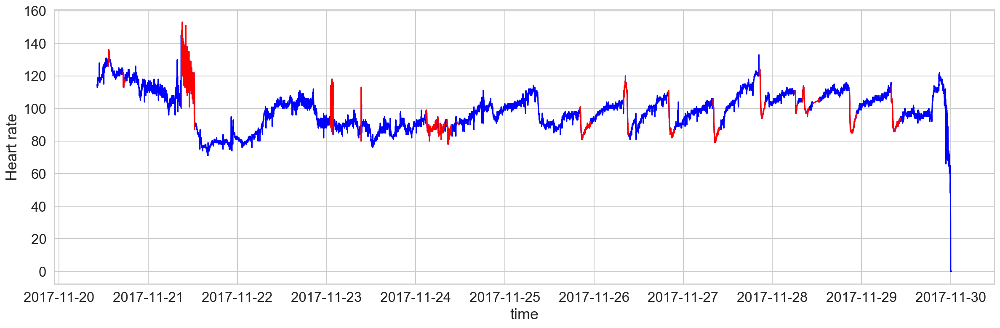

In [135]:
patient_numbers=[1,3,7,8,11,14,18,20,27,32,33,34,38,40,48,50,55,56, 57,58,59,66,72,75,78,80,85,91,94,97]

## Patient 82 has stayed 42 days
loc_x=.15
loc_y=0.36
e=0.04


day=0.5


patient_number=97

aa=dataframe_collection[patient_number]
values=aa['Heart Rate'].dropna()
time=aa['Heart Rate ChartDate'].dropna()
    

    
index=5

m=int(24*60*day)*index
k=int(24*60*day)*(index+1)
        

m=0
k=100000000
    
num_plots=num_plots+1

fig= plt.figure(figsize=(20,6))
plt.plot(time[m:k],values[m:k], color='blue')


for chunk in patient_group[29]:
    if (chunk[0]> m) & (chunk[1]<k):
        plt.plot(time[chunk[0]:chunk[1]],values[chunk[0]:chunk[1]], color='red')
        
        
plt.ylabel('Heart rate')
plt.xlabel('time') 
plt.show()


### Extract plots in excel files

In [853]:
import xlsxwriter

day=0.5
for patient_number in [97]:

    aa=dataframe_collection[patient_number]
    values=aa['Heart Rate'].dropna()
    time=aa['Heart Rate ChartDate'].dropna()
    
    text='aa_patinet%d.xlsx'%patient_number
    workbook = xlsxwriter.Workbook(text)
    
    
    for index in np.arange(50):
        m=int(24*60*day)*index
        k=int(24*60*day)*(index+1)
        
        if m<=np.size(values):
            
            worksheet = workbook.add_worksheet('%d'%index)

            for i in np.arange(np.size(values[m:k])):
    
                j=m+i
    
                worksheet.write(i, 0, time[j])
                worksheet.write(i, 1,j)
                worksheet.write(i, 2, values[j])    

        else:
            break

### Plot whole trajectory of a sample patient

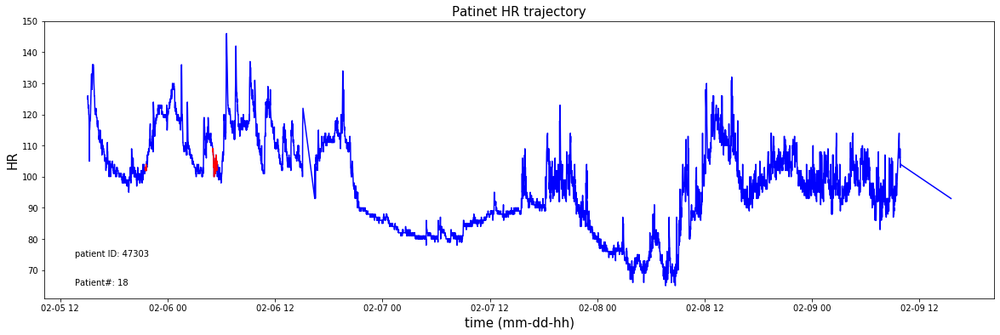

In [11]:
patient_number=18
aa=dataframe_collection[patient_number]
values=aa['Heart Rate']
time=aa['Heart Rate ChartDate']

loc_x=.15
loc_y=0.36
e=0.04

m=0
k=-1

fig= plt.figure(figsize=(20,6))
plt.plot(time[m:k],values[m:k], color='blue')

chunk1=[385,395]
chunk=chunk1
plt.plot(time[chunk[0]:chunk[1]],values[chunk[0]:chunk[1]], color='red')

chunk2=[838,870]
chunk=chunk2
plt.plot(time[chunk[0]:chunk[1]],values[chunk[0]:chunk[1]], color='red')

#plt.axhline(y=120, color='red', linestyle='--',linewidth=1)
plt.title('Patinet HR trajectory', size=15)

text2='patient ID: %s'%(patients[patient_number])
plt.figtext(loc_x, loc_y-3*e,text2)
#text6='LOS: %s'%(np.ptp(time))
#plt.figtext(loc_x, loc_y-4*e, text6)
text7='Patient#: %s'%(patient_number)
plt.figtext(loc_x, loc_y-5*e, text7)

plt.xlabel('time (mm-dd-hh)', size=15)
#plt.xticks( rotation=90 )
plt.ylabel('HR', size=15)
plt.show()

### Plot the trajectories of annotated patients

In [81]:
variable_of_interest='Heart Rate'


### Create 1 minute
aa=dataframe_collection[2]
values=aa['Heart Rate']
n=np.size(values)
one_minute=(aa['Heart Rate ChartDate'][11]-aa['Heart Rate ChartDate'][10])


for i in np.arange(np.size(patient_numbers)):

    patient_num=patient_numbers[i]
    aa=dataframe_collection[patient_num]
    values=aa[variable_of_interest]
    text=variable_of_interest+' ChartDate'
    time=aa[text]
    
    fig= plt.figure(figsize=(20,6))
    plt.plot(time,values, color='blue')
    text7='Patient#: %s'%(patient_num)
    plt.figtext(loc_x, loc_y-5*e, text7)



    
    ### remove the abnormal chunks
    for chunk in patient_group[i]:
        an_values=values[chunk[0]:chunk[1]]
        an_time=time[chunk[0]: chunk[1]]
        plt.plot(an_time,an_values, color='red')
    
    
    #plt.show()

/Users/hosseinpiri/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


### DTW+KNN

In [20]:
pip install fastdtw

     |████████████████████████████████| 103 kB 2.5 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [26]:
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean

kapa=30
x = np.array([[1], [2], [3], [3], [7]])
y = np.array([[1], [2], [2], [2], [2], [2], [2], [4]])

distance=fastdtw(x, y, dist=euclidean)[0]
distance

5.0

In [53]:
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean

##########################
#### Create pattern set

kapa=30

patient_set=patient_numbers[0:2]

patterns={}
counter=-1

for i in np.arange(len(patient_set)):

    patient_num=patient_set[i]
    num=np.where(np.array(patient_numbers)==patient_num)[0][0]

    print(patient_num)
    aa=dataframe_collection[patient_num]
    values=scaler.transform(aa[['Heart Rate']].dropna())
    time=aa['Heart Rate ChartDate'].dropna()
    
    for chunk in patient_group[num]:
        counter=counter+1
        patterns[counter]=np.array(values[chunk[0]:chunk[1]])
        

##########################
#### Calculate distances

test_set=patient_numbers[2:5]
all_dists={}

for i in np.arange(len(test_set)):

    patient_num=test_set[i]
    num=np.where(np.array(patient_numbers)==patient_num)[0][0]

    print(patient_num)

    aa=dataframe_collection[patient_num]
    values=scaler.transform(aa[['Heart Rate']].dropna())
    dists=np.zeros(np.size(values))+999
    time=aa['Heart Rate ChartDate'].dropna()
    
    for n in np.arange(np.size(values)):
        #print(n)
        if (n>kapa)&(n+kapa<np.size(values)):
            y=values[n-k1:n+k1+1]
            
            mapping=np.zeros(len(patterns))+999
            for j in range(len(patterns)):
                x=patterns[j]
                distance= fastdtw(x,y , dist=euclidean)[0]
                mapping[j]=distance
            dists[n]=np.min(mapping)
            
    all_dists[patient_num]=dists
    
###################
### Calculate error
n=100
tre_set=np.arange(n)/n
n=len(tre_set)

errors=np.zeros((n,len(test_set)))
FN=np.zeros((n,len(test_set)))
FP=np.zeros((n,len(test_set)))
length=np.zeros(len(test_set))

length=np.zeros(len(test_set))

for i in np.arange(len(test_set)):

    patient_num=test_set[i]
    num=np.where(np.array(patient_numbers)==patient_num)[0][0]
    print(patient_num)
    aa=dataframe_collection[patient_num]
    values=aa[['Heart Rate']].dropna()
    length[i]=len(values)
    labels=np.zeros(len(values))
    for chunk in patient_group[num]:
        labels[chunk[0]:chunk[1]]=int(1) 
    darren=labels
    k=-1

    for threshold in tre_set:
        k=k+1   
        predict=[all_dists[patient_num]<threshold]                        
        er=np.mean(np.abs(darren-predict))
        errors[k,i]=er
        
        fn=0
        fp=0
        for r in np.arange(np.size(predict)):
            if darren[r]>predict[r]:
                fn=fn+1
            if predict[r]>darren[r]:
                fp=fp+1
        FN[k,i]=fn/max(1,np.sum(darren))
        FP[k,i]=fp/(np.size(darren)-np.sum(darren))

length=length/np.sum(length)

FN_vec=np.zeros(n)
FP_vec=np.zeros(n)
errors_vec=np.zeros(n)

k=-1
for THRESHOLD in np.arange(n)/n:
    k=k+1
    FN_vec[k]=np.dot(FN[k,:],length)
    FP_vec[k]=np.dot(FP[k,:],length)
    errors_vec[k]=np.dot(errors[k,:],length)
    
plt.plot(np.arange(n)/n,errors_vec, label='total error')
plt.plot(np.arange(n)/n,FN_vec, label='FN error')
plt.plot(np.arange(n)/n,FP_vec, label='FP error')
plt.legend()
plt.show() 
print('min error is %f' %min(errors_vec))    

1
3
7
8
11
7


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

7
8
11


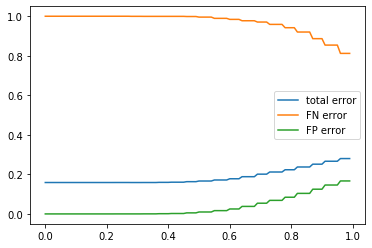

min error is 0.158799


In [59]:
    
###################
### Calculate error
n=100
tre_set=np.arange(n)/n
n=len(tre_set)

errors=np.zeros((n,len(test_set)))
FN=np.zeros((n,len(test_set)))
FP=np.zeros((n,len(test_set)))
length=np.zeros(len(test_set))

length=np.zeros(len(test_set))

for i in np.arange(len(test_set)):

    patient_num=test_set[i]
    num=np.where(np.array(patient_numbers)==patient_num)[0][0]
    print(patient_num)
    aa=dataframe_collection[patient_num]
    values=aa[['Heart Rate']].dropna()
    length[i]=len(values)
    labels=np.zeros(len(values))
    for chunk in patient_group[num]:
        labels[chunk[0]:chunk[1]]=int(1) 
    darren=labels
    k=-1

    for threshold in tre_set:
        k=k+1   
        predict=all_dists[patient_num]<threshold                       
        er=np.mean(np.abs(darren-predict))
        errors[k,i]=er
        
        fn=0
        fp=0
        for r in np.arange(np.size(predict)):
            if darren[r]>predict[r]:
                fn=fn+1
            if predict[r]>darren[r]:
                fp=fp+1
        FN[k,i]=fn/max(1,np.sum(darren))
        FP[k,i]=fp/(np.size(darren)-np.sum(darren))

length=length/np.sum(length)

FN_vec=np.zeros(n)
FP_vec=np.zeros(n)
errors_vec=np.zeros(n)

k=-1
for threshold in np.arange(n)/n:
    k=k+1
    FN_vec[k]=np.dot(FN[k,:],length)
    FP_vec[k]=np.dot(FP[k,:],length)
    errors_vec[k]=np.dot(errors[k,:],length)
    
plt.plot(np.arange(n)/n,errors_vec, label='total error')
plt.plot(np.arange(n)/n,FN_vec, label='FN error')
plt.plot(np.arange(n)/n,FP_vec, label='FP error')
plt.legend()
plt.show() 
print('min error is %f' %min(errors_vec)) 

### Hand crafted feature

In [5]:
def hand_crafted(k1,k2,patient_number):
    
    patient_num=patient_number
    aa=dataframe_collection[patient_num]
    values=scaler.transform(aa[['Heart Rate']].dropna())
    time=aa['Heart Rate ChartDate'].dropna()
    
    
    V_back=np.array(values)
    V_forward=np.array(values)
    
    for l in np.arange(len(V_back)-1)+1:
        V_back[l]=beta*V_back[l-1]+(1-beta)*V_back[l]
        
    for ll in np.arange(len(V_forward)-1):
        V_forward[ll]=beta*V_forward[ll+1]+(1-beta)*V_forward[ll]
    
    counter=-1
    for n in np.arange(np.size(values)):
        if (n>k2)&(n+k2<np.size(values)):
            counter=counter+1
            #a=values[n-k:n+k+1]
            #b=np.concatenate([a, [ labels[n] ] ])
            average1=np.mean(values[n-k1:n+k1+1]) 
            cov1=np.std(values[n-k1:n+k1+1])/max(0.001,np.mean(values[n-k1:n+k1+1]))
            average2=np.mean(values[n-k2:n+k2+1]) 
            cov2=np.std(values[n-k2:n+k2+1])/max(0.001,np.mean(values[n-k2:n+k2+1]))
            
            mini1=values[n]-np.min(values[n-k1:n+k1+1])
            mini2=values[n]-np.min(values[n-k2:n+k2+1])

            maxi1=np.max(values[n-k1:n+k1+1])-values[n]
            maxi2=np.max(values[n-k2:n+k2+1])-values[n]
            
            crossing=np.sum(values[n-k2:n+k2+1]-values[n])
            crossing_forward=np.sum(values[n:n+k2+1]-values[n])
            crossing_backward=np.sum(values[n-k2:n]-values[n])
            
            # Forward derivatives  
            h=1  
            d1f=(values[n+h]-values[n])/(h)  
            h=2  
            d2f=(values[n+h]-values[n])/(h) 
            h=3  
            d3f=(values[n+h]-values[n])/(h)               
            h=4  
            d4f=(values[n+h]-values[n])/(h) 
            h=5  
            d5f=(values[n+h]-values[n])/(h)
            h=10  
            d10f=(values[n+h]-values[n])/(h)
            h=20  
            d20f=(values[n+h]-values[n])/(h)
            h=30  
            d30f=(values[n+h]-values[n])/(h)
            ### Backward derivatives  
            h=-1  
            d1b=(values[n+h]-values[n])/(h)  
            h=-2  
            d2b=(values[n+h]-values[n])/(h) 
            h=-3  
            d3b=(values[n+h]-values[n])/(h)               
            h=-4  
            d4b=(values[n+h]-values[n])/(h) 
            h=-5  
            d5b=(values[n+h]-values[n])/(h)
            h=-10  
            d10b=(values[n+h]-values[n])/(h)
            h=-20  
            d20b=(values[n+h]-values[n])/(h) 
            h=-30  
            d30b=(values[n+h]-values[n])/(h)
            #ft=np.mean(np.fft.fft(values[n-k:n+k+1]).real)
              
 
            c=np.concatenate([[values[n][0]],[average1],[average2],[V_forward[n][0]],[V_back[n][0]] ,[cov1],[cov2],
                              [crossing],[crossing_forward],[crossing_backward],
                              [mini1][0],[mini2][0],[maxi1][0],[maxi2][0],
                              [d1f][0],[d2f][0],[d3f][0],[d4f][0],[d5f][0],[d10f][0],[d20f][0],[d30f][0],
                              [d1b][0],[d2b][0],[d3b][0],[d4b][0],[d5b][0],[d10b][0],[d20b][0],[d30b][0],
                              [values[n][0]*d1f[0]], [values[n][0]*d1b[0]] ])
            
           
            if counter==0:
                hand_crafted_X=c
            else:
                hand_crafted_X=np.vstack((hand_crafted_X,c))
            
            

           
    y=np.zeros(np.size(values))
    pred=model2.predict(hand_crafted_X)
    y[k2+1:np.size(values)-k2]=pred
    
    return y



In [22]:
counter=-1
for i in patient_numbers[0:33]:
    aa=dataframe_collection[i]
    new_values=np.array(aa['Heart Rate'].dropna())
    
    counter=counter+1
    if counter==0:
        values=np.array(aa['Heart Rate'].dropna())
        tt=np.size(values)
    else:
        tt=tt+np.size(new_values)
        values=np.append(values,new_values)

mean=np.mean(values)
std=np.std(values)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler = scaler.fit(pd.DataFrame(values))

In [24]:
def sec_der(S):
    n=len(S)
    vec=np.zeros(n)
    for i in np.arange(len(vec)-2)+1:
        vec[i]=0.5*(S[i-1][0]-2*S[i][0]+S[i+1][0])
        
    vec=vec[1:len(S)-1]
    return np.mean(vec)/(n-2)

In [25]:
k1=3
k2=30
beta=0.9


#len(patient_numbers)
counter=-1
for i in np.arange(len(patient_numbers)):

    patient_num=patient_numbers[i]
    print(patient_num)
    aa=dataframe_collection[patient_num]
    values=scaler.transform(aa[['Heart Rate']].dropna())
    time=aa['Heart Rate ChartDate'].dropna()
    
    
    V_back=np.array(values)
    V_forward=np.array(values)
    
    for l in np.arange(len(V_back)-1)+1:
        V_back[l]=beta*V_back[l-1]+(1-beta)*V_back[l]
        
    for ll in np.arange(len(V_forward)-1):
        V_forward[ll]=beta*V_forward[ll+1]+(1-beta)*V_forward[ll]
    
    
    ### Create labels
    labels=np.zeros(np.size(values))
    for chunk in patient_group[i]:
        labels[chunk[0]:chunk[1]]=int(1)
        
    #RNN_labels=all_predictions[patient_num]
    
    for n in np.arange(np.size(values)):
        if (n>k2)&(n+k2<np.size(values)):
            counter=counter+1
            #a=values[n-k:n+k+1]
            #b=np.concatenate([a, [ labels[n] ] ])
            
            average1=np.mean(values[n-k1:n+k1+1]) 
            average2=np.mean(values[n-k2:n+k2+1]) 
            
            cov1=np.std(values[n-k1:n+k1+1])
            #/max(0.001,np.mean(values[n-k1:n+k1+1]))
            cov2=np.std(values[n-k2:n+k2+1])
            #/max(0.001,np.mean(values[n-k2:n+k2+1]))
            skew1=scipy.stats.skew(values[n-k1:n+k1+1])
            skew2=scipy.stats.skew(values[n-k2:n+k2+1])
            
            kurt1=scipy.stats.kurtosis(values[n-k1:n+k1+1])
            kurt2=scipy.stats.kurtosis(values[n-k1:n+k1+1])
            
            med1=np.median(values[n-k1:n+k1+1])
            med2=np.median(values[n-k2:n+k2+1])
            
            mini1=values[n]-np.min(values[n-k1:n+k1+1])
            mini2=values[n]-np.min(values[n-k2:n+k2+1])

            maxi1=np.max(values[n-k1:n+k1+1])-values[n]
            maxi2=np.max(values[n-k2:n+k2+1])-values[n]
            
            second_derivative1=sec_der(values[n-k1:n+k1+1])
            second_derivative2=sec_der(values[n-k2:n+k1+2])
            
            crossing=np.sum(values[n-k2:n+k2+1]-values[n])
            crossing_forward=np.sum(values[n:n+k2+1]-values[n])
            crossing_backward=np.sum(values[n-k2:n]-values[n])
            
            # Forward derivatives  
            h=1  
            d1f=(values[n+h]-values[n])/(h)  
            h=2  
            d2f=(values[n+h]-values[n])/(h) 
            h=3  
            d3f=(values[n+h]-values[n])/(h)               
            h=4  
            d4f=(values[n+h]-values[n])/(h) 
            h=5  
            d5f=(values[n+h]-values[n])/(h)
            h=10  
            d10f=(values[n+h]-values[n])/(h)
            h=20  
            d20f=(values[n+h]-values[n])/(h)
            h=30  
            d30f=(values[n+h]-values[n])/(h)
            ### Backward derivatives  
            h=-1  
            d1b=(values[n+h]-values[n])/(h)  
            h=-2  
            d2b=(values[n+h]-values[n])/(h) 
            h=-3  
            d3b=(values[n+h]-values[n])/(h)               
            h=-4  
            d4b=(values[n+h]-values[n])/(h) 
            h=-5  
            d5b=(values[n+h]-values[n])/(h)
            h=-10  
            d10b=(values[n+h]-values[n])/(h)
            h=-20  
            d20b=(values[n+h]-values[n])/(h) 
            h=-30  
            d30b=(values[n+h]-values[n])/(h)
            #ft=np.mean(np.fft.fft(values[n-k:n+k+1]).real)
              
              
            c=np.concatenate([[1],[values[n][0]],[average1],[average2],[V_forward[n][0]],[V_back[n][0]] ,[cov1],[cov2],
                              [med1],[med2],
                              [crossing],[crossing_forward],[crossing_backward],
                              [skew1][0],[skew2][0],[kurt1][0],[kurt2][0],
                              [mini1][0],[mini2][0],[maxi1][0],[maxi2][0],
                              [second_derivative1], [second_derivative2],
                              [d1f][0],[d2f][0],[d3f][0],[d4f][0],[d5f][0],[d10f][0],[d20f][0],[d30f][0],
                              [d1b][0],[d2b][0],[d3b][0],[d4b][0],[d5b][0],[d10b][0],[d20b][0],[d30b][0],
                              [values[n][0]*d1f[0]], [values[n][0]*d1b[0]],
                              [ labels[n] ] ])
            
            
            
            if counter==0:
                hand_crafted_X=c
            else:
                hand_crafted_X=np.vstack((hand_crafted_X,c))
print(np.shape(hand_crafted_X))       

1
3
7
8
11
14
18
20
27
32
33
34
38
40
48
50
55
56
57
58
59
66
72
75
78
80
85
91
94
97
(158547, 42)


### Train NN based on hand crafted X

In [27]:
portion_train=0.8

from sklearn.neural_network import MLPRegressor, MLPClassifier
from sklearn.linear_model import LogisticRegression

#XX=X.astype(float)

XX=np.array(pd.DataFrame(hand_crafted_X).dropna())

#np.random.shuffle(XX)

n=np.shape(XX)[0]
m=np.shape(XX)[1]
print('n: %d' %n)

b=int(portion_train*n)


Xtrain=XX[0:b,0:m-1]
ytrain = XX[0:b,-1]


Xtest=XX[b:-1,0:m-1]
ytest = XX[b:-1,-1]

#28,20,15,10,15
#28,25,20,15,10
### Neural network model
model2 = MLPClassifier(hidden_layer_sizes=(35,30,25,15,10),alpha=0.0001,learning_rate='adaptive',
                       learning_rate_init =0.001, solver='adam')

### Logit model

#model3= LogisticRegression()

model2.fit( Xtrain ,ytrain  )
#model3.fit( Xtrain ,ytrain )

# Compute training error
yhat = model2.predict(Xtrain)
trainError = np.mean(yhat != ytrain)
print("Training error = ", trainError)

        
# Compute test error
yhat = model2.predict(Xtest)
testError = np.mean(yhat != ytest)
print("Test error     = ", testError)


err=0
ter=0
for i in np.arange(np.size(yhat)):
    if ytest[i]>yhat[i]:
        err=err+1
    if yhat[i]>ytest[i]:
        ter=ter+1
        
FN=err/np.sum(ytest)       
print('false negative predictions are %f percent' %FN)
FP=ter/(np.size(ytest)-np.sum(ytest))
print('false positive predictions are %f percent' %FP)

np.sum(yhat)

n: 158547


/Users/hosseinpiri/opt/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Training error =  0.05269755670663923
Test error     =  0.1317291620675518
false negative predictions are 0.707598 percent
false positive predictions are 0.083829 percent


3166.0

### Visualize performance of hand crafted X

false negative predictions are 0.524496 percent
false positive predictions are 0.048216 percent


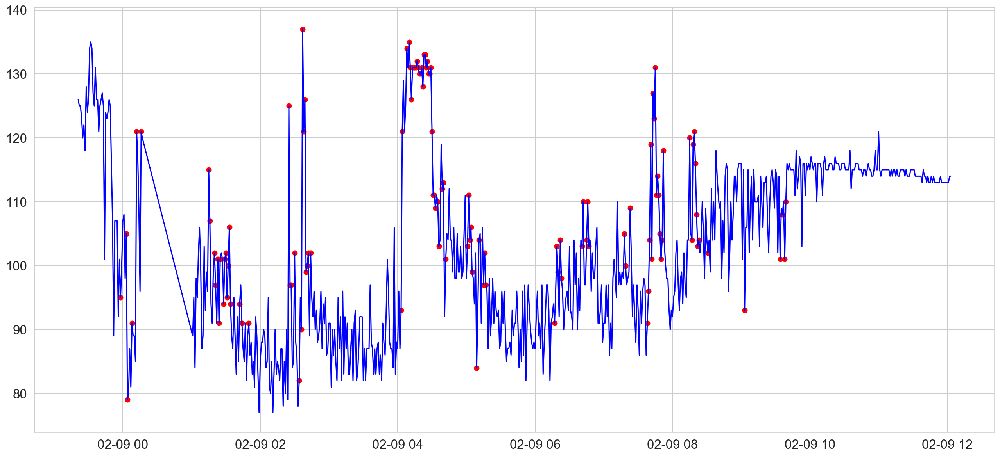

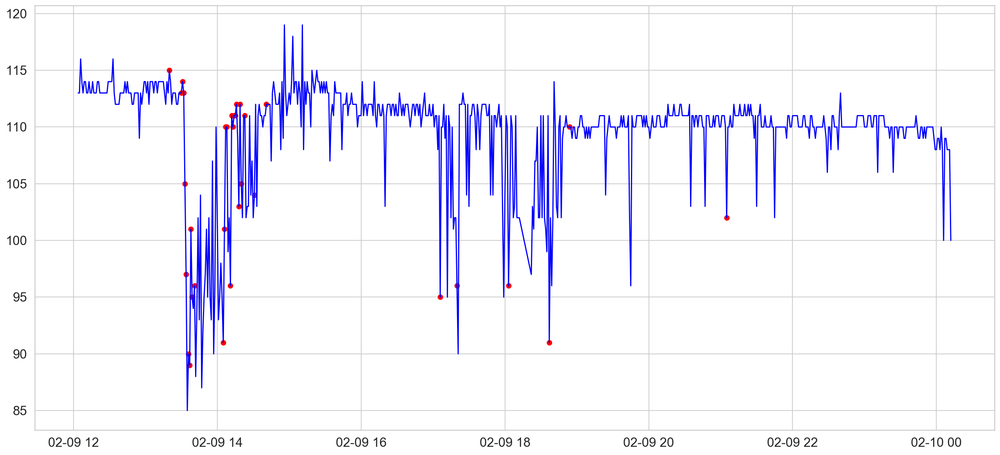

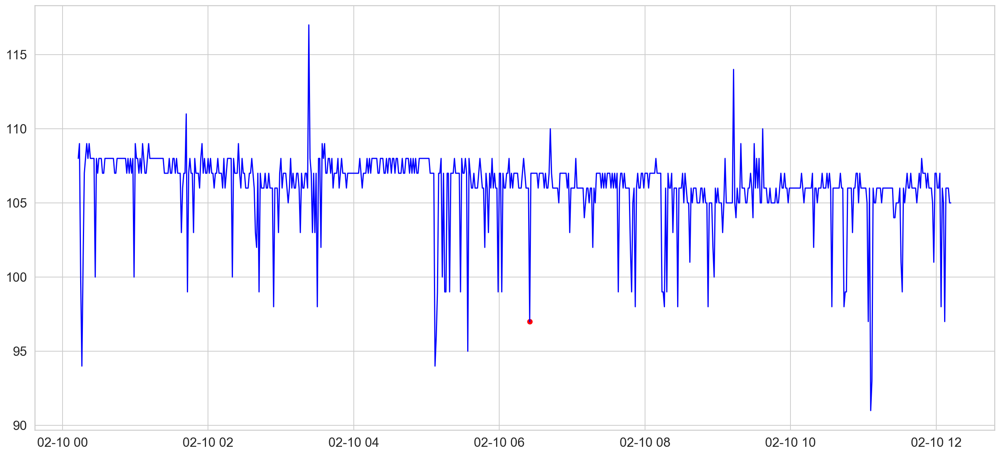

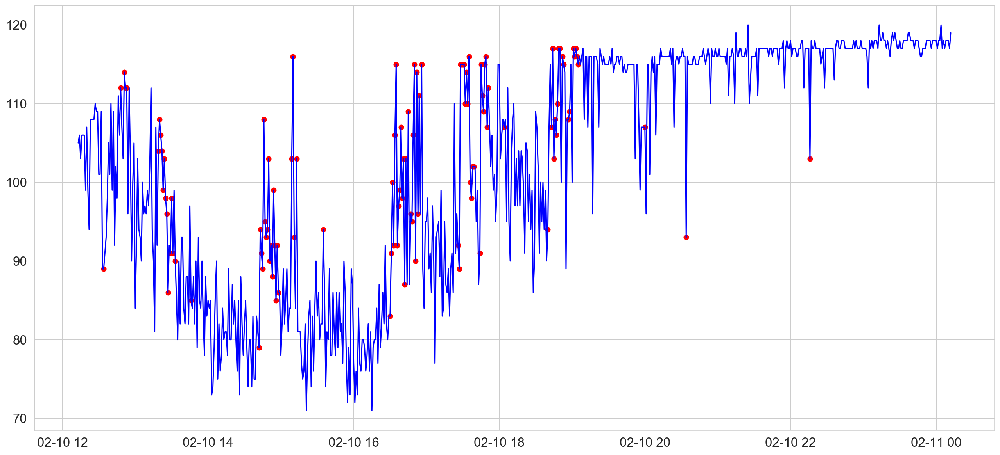

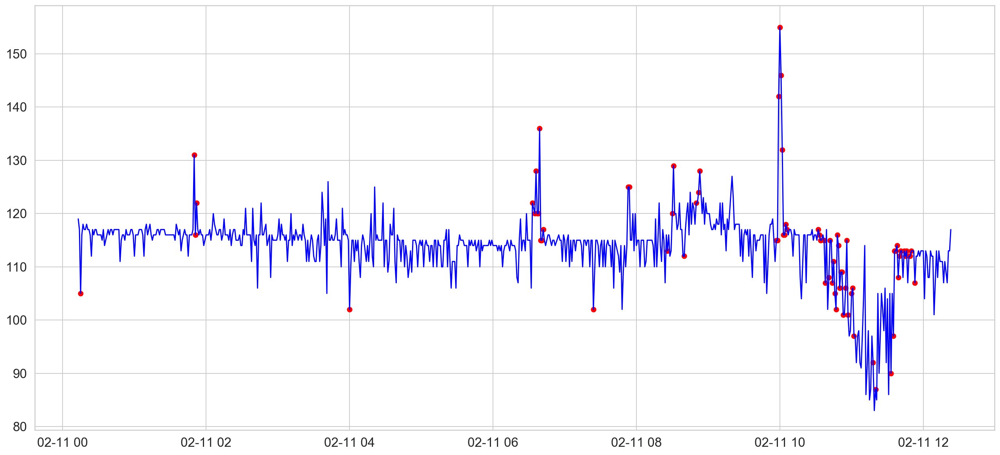

KeyError: 4320

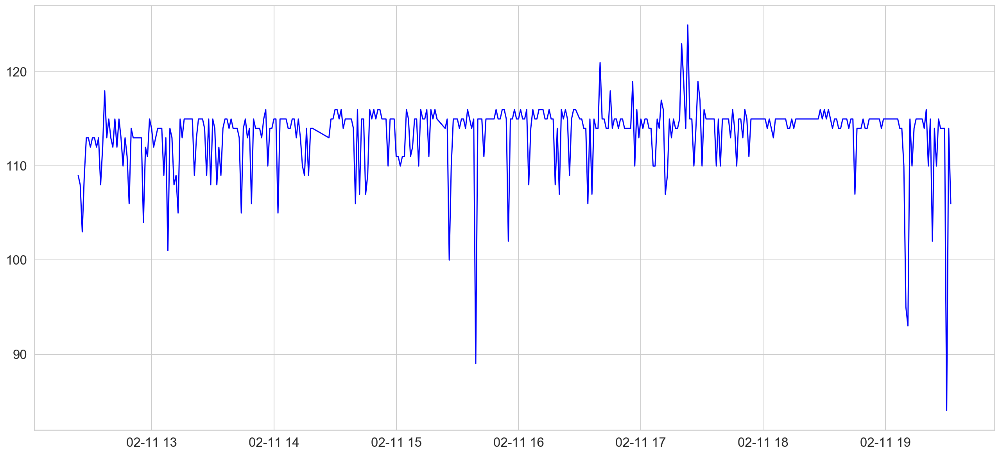

In [246]:
patient_number=1
#y_predict_sample=hand_crafted(5,30,patient_number)


patient_num=patient_number
aa=dataframe_collection[patient_num]
values=aa['Heart Rate'].dropna()
time=aa['Heart Rate ChartDate'].dropna()

labels=np.zeros(np.size(values))
i=np.where(np.array(patient_numbers)==patient_number)[0][0]
for chunk in patient_group[i]:
    labels[chunk[0]:chunk[1]]=int(1)

err=0
ter=0
for i in np.arange(np.size(labels)):
    if labels[i]>y_predict_sample[i]:
        err=err+1
    if y_predict_sample[i]>labels[i]:
        ter=ter+1
        
FN=err/np.sum(labels)       
print('false negative predictions are %f percent' %FN)
FP=ter/(np.size(labels)-np.sum(labels))
print('false positive predictions are %f percent' %FP)

np.sum(yhat)
    
        
for plot_num in [0,1,2,3,4,5]:
    day=0.5
    mm=int(24*60*day)*plot_num
    kk=int(24*60*day)*(plot_num+1)

    plot_time=time[y_predict_sample>0]
    plot_values=values[y_predict_sample>0]

    plt.plot(time[mm:kk],values[mm:kk], color='blue')
    plt.scatter(plot_time[(plot_time>time[mm])& (plot_time<time[kk]) ],    
            plot_values[(plot_time>time[mm])& (plot_time<time[kk]) ], color='red')
    plt.show()

false negative predictions are 0.561608 percent
false positive predictions are 0.020774 percent
0


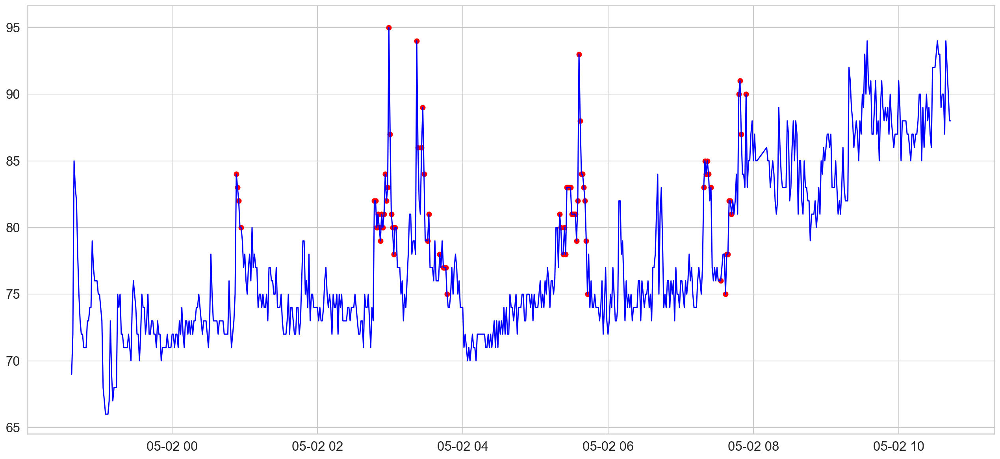

1


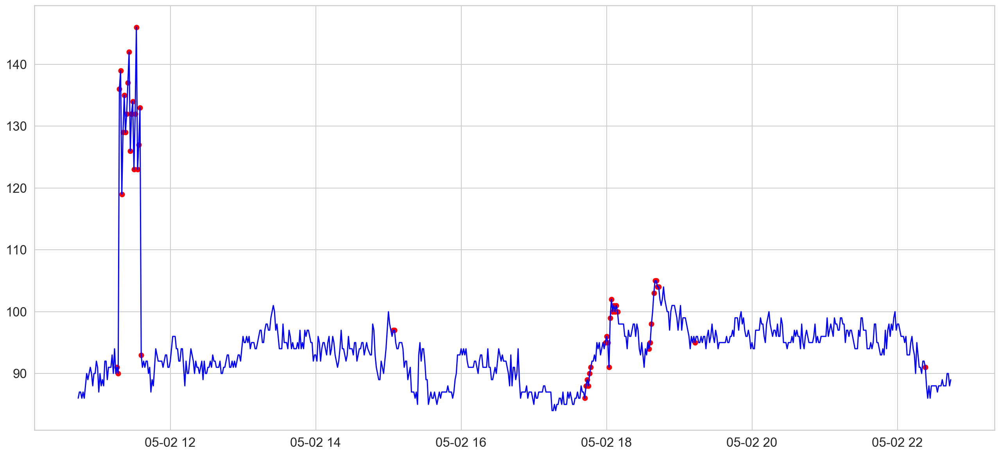

2


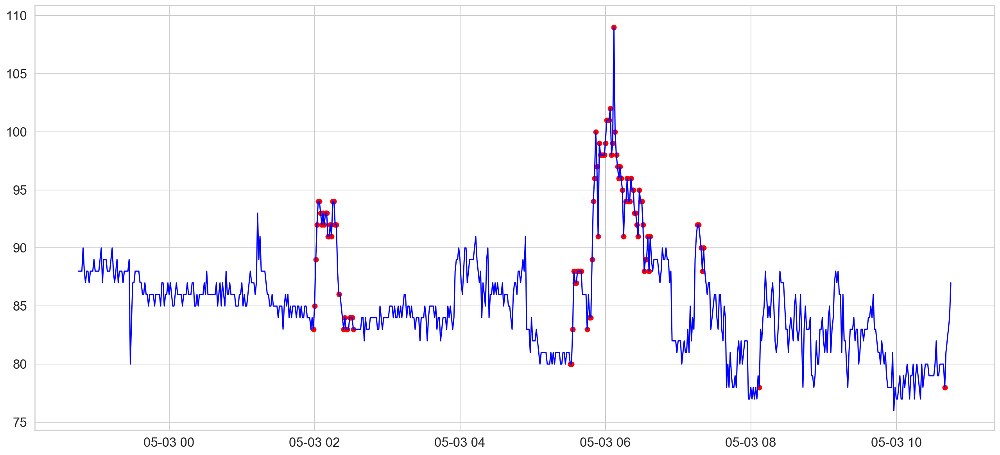

3


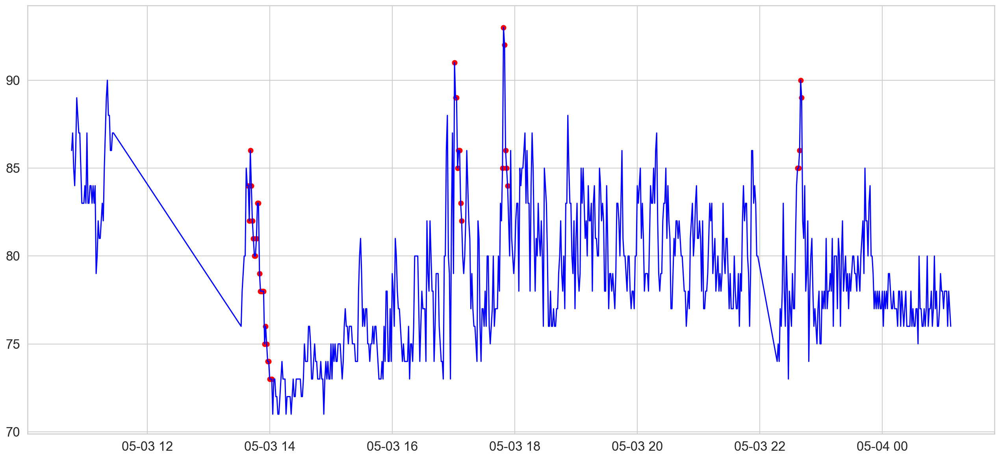

4


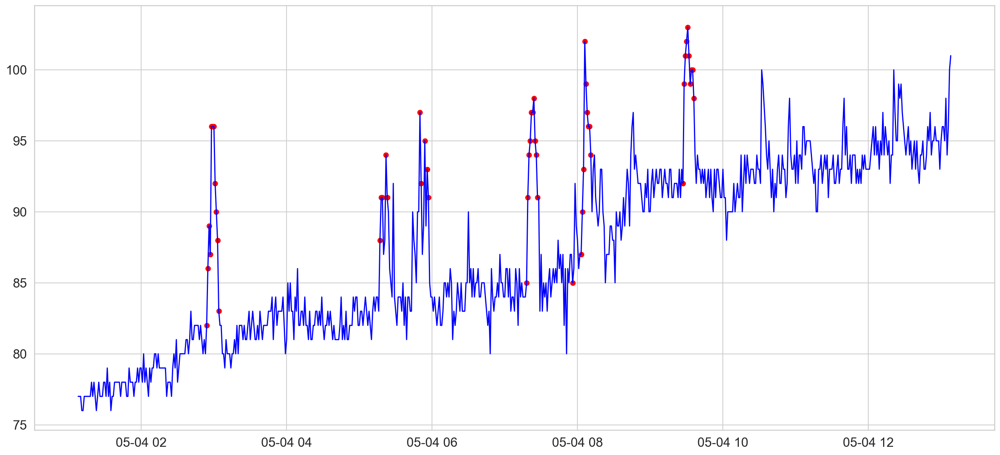

5


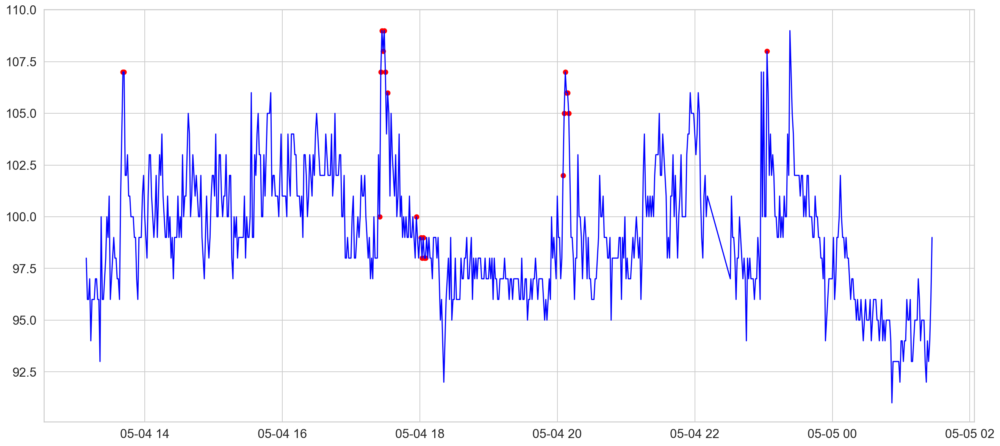

6


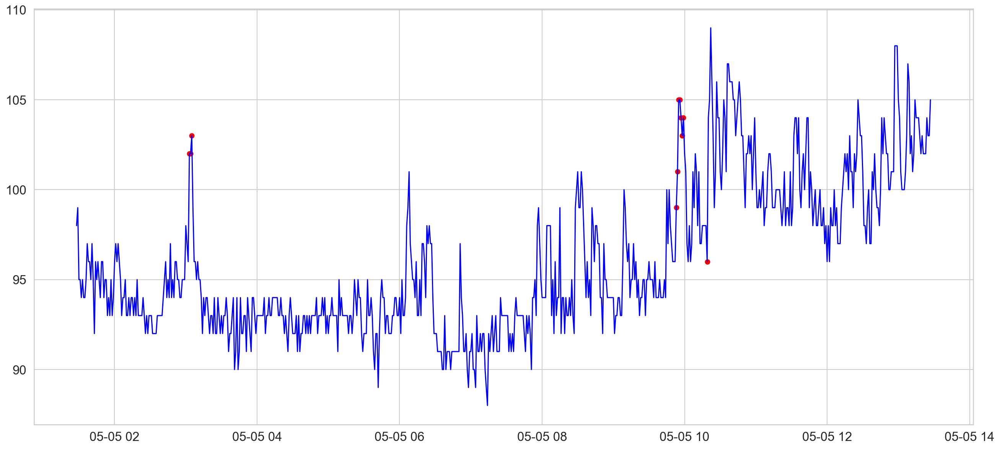

7


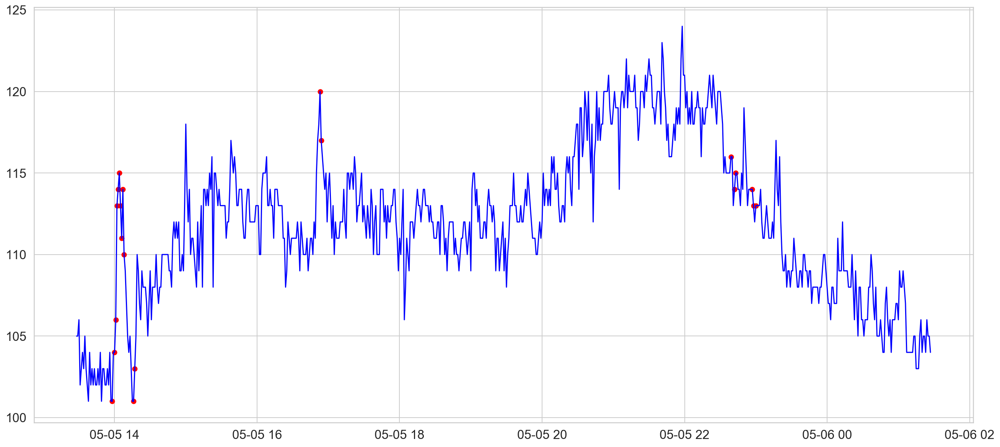

8


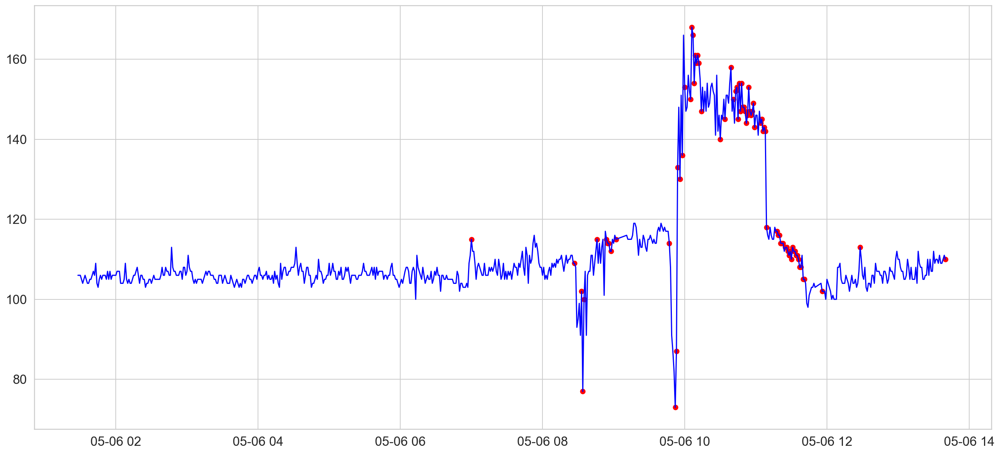

9


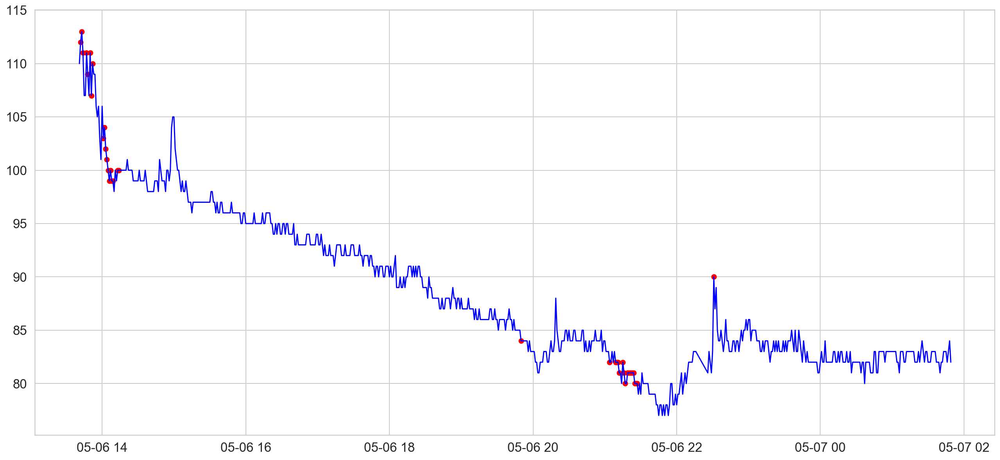

10


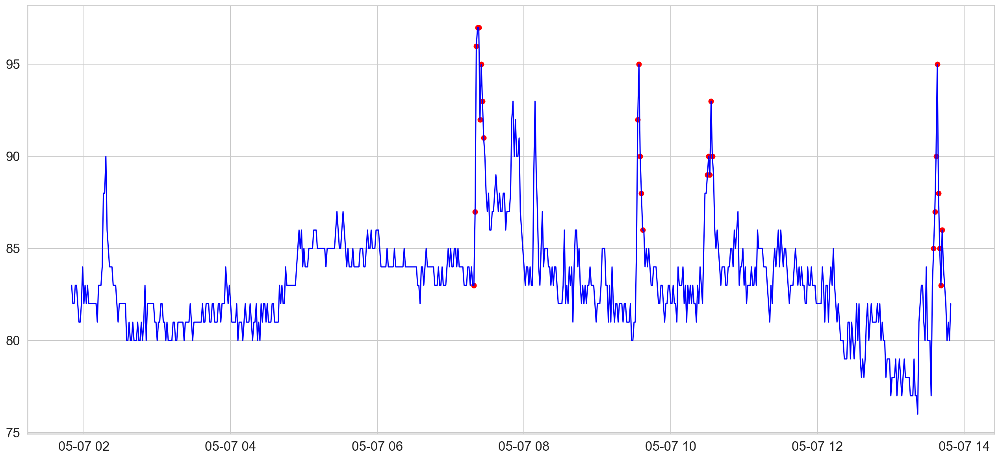

11


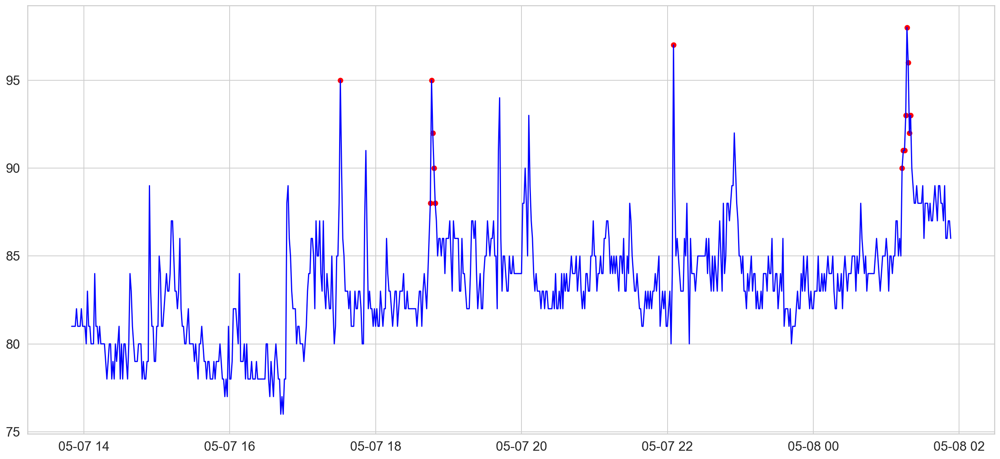

12


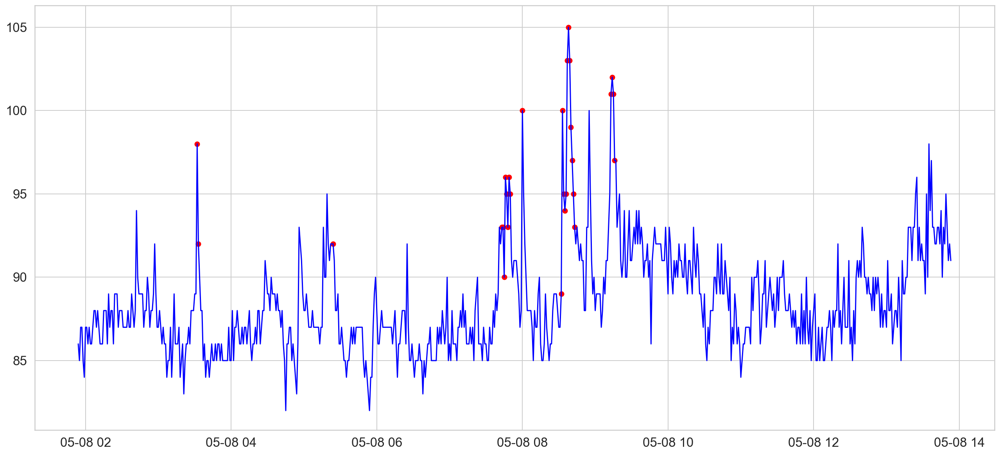

13


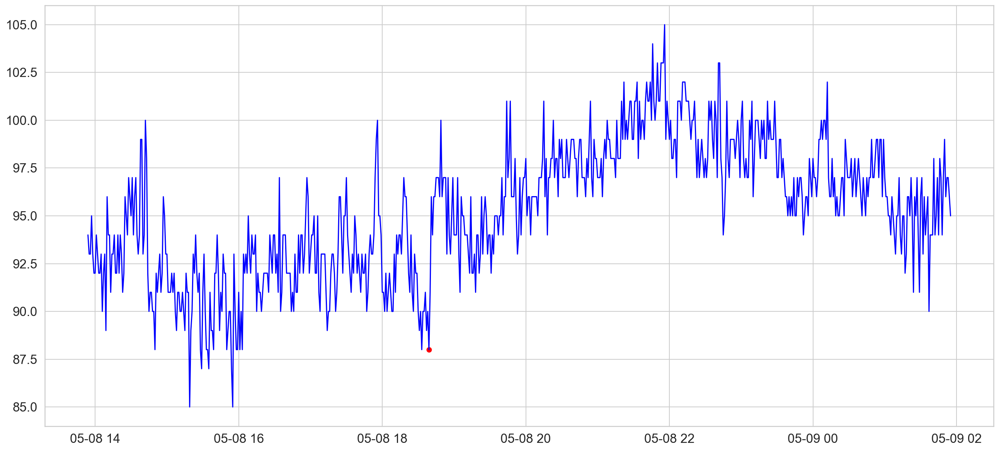

14


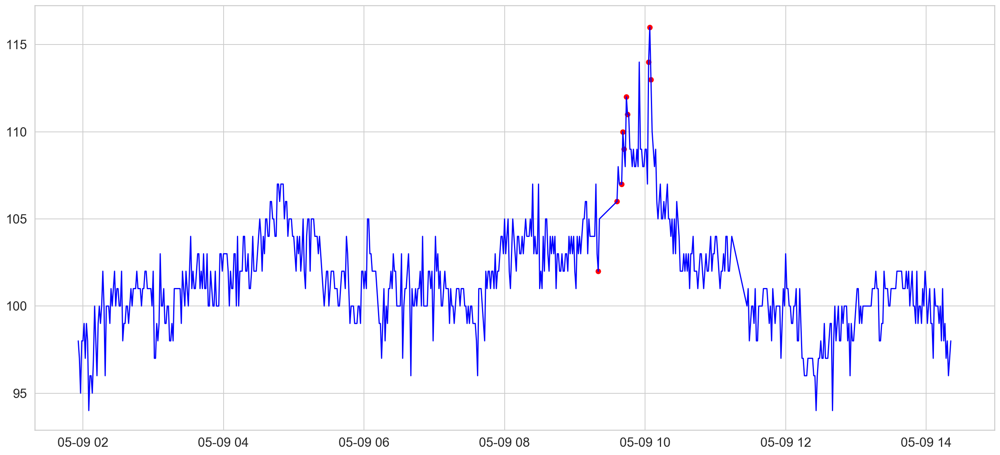

15


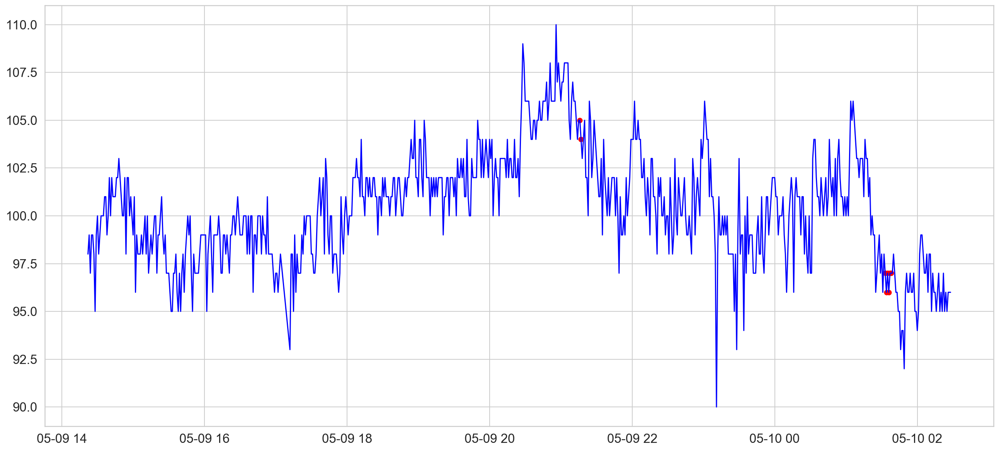

16


KeyError: 12240

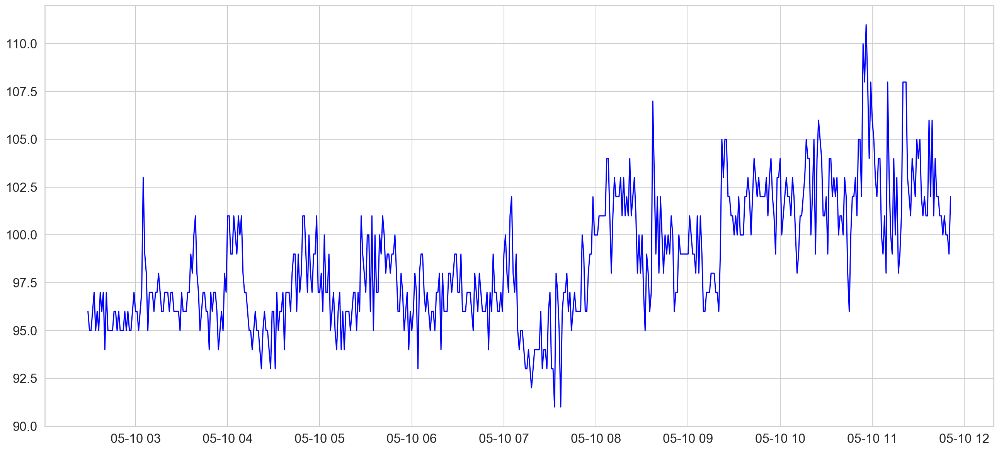

In [250]:
patient_number=3
y_predict_sample=hand_crafted(5,30,patient_number)


patient_num=patient_number
aa=dataframe_collection[patient_num]
values=aa['Heart Rate'].dropna()
time=aa['Heart Rate ChartDate'].dropna()

labels=np.zeros(np.size(values))
i=np.where(np.array(patient_numbers)==patient_number)[0][0]
for chunk in patient_group[i]:
    labels[chunk[0]:chunk[1]]=int(1)

err=0
ter=0
for i in np.arange(np.size(labels)):
    if labels[i]>y_predict_sample[i]:
        err=err+1
    if y_predict_sample[i]>labels[i]:
        ter=ter+1
        
FN=err/np.sum(labels)       
print('false negative predictions are %f percent' %FN)
FP=ter/(np.size(labels)-np.sum(labels))
print('false positive predictions are %f percent' %FP)

np.sum(yhat)
    
        
for plot_num in range(17):
    print(plot_num)
    day=0.5
    mm=int(24*60*day)*plot_num
    kk=int(24*60*day)*(plot_num+1)

    plot_time=time[y_predict_sample>0]
    plot_values=values[y_predict_sample>0]

    plt.plot(time[mm:kk],values[mm:kk], color='blue')
    plt.scatter(plot_time[(plot_time>time[mm])& (plot_time<time[kk]) ],    
            plot_values[(plot_time>time[mm])& (plot_time<time[kk]) ], color='red')
    plt.show()

### Use TSFRESH for feature extraction

In [9]:
################
#### Normalize 
counter=-1
for i in patient_numbers[0:33]:
    aa=dataframe_collection[i]
    new_values=np.array(aa['Heart Rate'].dropna())
    
    counter=counter+1
    if counter==0:
        values=np.array(aa['Heart Rate'].dropna())
        tt=np.size(values)
    else:
        tt=tt+np.size(new_values)
        values=np.append(values,new_values)

mean=np.mean(values)
std=np.std(values)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler = scaler.fit(pd.DataFrame(values))

### Define X0
from tsfresh import extract_features
from tsfresh import select_features
from tsfresh.utilities.dataframe_functions import impute

k=15

t_counter=-1
p_counter=-1
pipi=-1
#len(patient_numbers)
for i in np.arange(len(patient_numbers)):
    p_counter=p_counter+1
    inter_counter=-1
    
    patient_num=patient_numbers[i]
    print(patient_num)
    aa=dataframe_collection[patient_num]
    values=scaler.transform(aa[['Heart Rate']].dropna())
    time=aa['Heart Rate ChartDate'].dropna()
    
    values=np.array(values)
    time=np.array(time)
    
    ### Create labels
    labels=np.zeros(np.size(values))
    for chunk in patient_group[i]:
        labels[chunk[0]:chunk[1]]=int(1)
    
    for n in np.arange(np.size(values)):
        if (n>k)&(n+k<np.size(values)):
            if i==18:
                pipi=pipi+1
            if pipi==0:
                split_index=int(t_counter)

            a=values[n-k:n+k+1]
            #b=np.concatenate([a, [ labels[n] ] ])
            
            t_counter=t_counter+1
            inter_counter=inter_counter+1
            
            df1=pd.DataFrame(columns = ["id", "time", "time_seris"])
            df1['id']=[int(t_counter)]*(2*k+1)
            df1['time']=range(2*k+1)
            df1['time_seris']=a.astype(float)  
            
             
            if t_counter==0:
                vay=labels[n]
            else:
                vay=np.append(vay,[labels[n]])
            
            if inter_counter==0:
                my_df=df1
            else:
                my_df=my_df.append(df1, ignore_index=True, sort=False)                                
    
    extracted_features = extract_features(my_df, column_id="id", column_sort="time") 
    
    if p_counter==0:
        X0=extracted_features
    else:
        X0=X0.append(extracted_features, ignore_index=True, sort=False)   
    
impute(X0)
X= select_features(X0, vay)

1


Feature Extraction: 100%|██████████| 10/10 [01:22<00:00,  8.29s/it]


3


Feature Extraction: 100%|██████████| 10/10 [04:30<00:00, 27.03s/it]


7


Feature Extraction: 100%|██████████| 10/10 [02:50<00:00, 17.03s/it]


8


Feature Extraction: 100%|██████████| 10/10 [00:47<00:00,  4.77s/it]


11


Feature Extraction: 100%|██████████| 10/10 [01:28<00:00,  8.88s/it]


14


Feature Extraction: 100%|██████████| 10/10 [00:21<00:00,  2.15s/it]


18


Feature Extraction: 100%|██████████| 10/10 [02:10<00:00, 13.07s/it]


20


Feature Extraction: 100%|██████████| 10/10 [00:24<00:00,  2.44s/it]


27


Feature Extraction: 100%|██████████| 10/10 [01:42<00:00, 10.22s/it]


32


Feature Extraction: 100%|██████████| 10/10 [05:56<00:00, 35.64s/it]


33


Feature Extraction: 100%|██████████| 10/10 [00:26<00:00,  2.68s/it]


34


Feature Extraction: 100%|██████████| 10/10 [00:37<00:00,  3.79s/it]


38


Feature Extraction: 100%|██████████| 10/10 [00:59<00:00,  5.94s/it]


40


Feature Extraction: 100%|██████████| 10/10 [00:25<00:00,  2.58s/it]


48


Feature Extraction: 100%|██████████| 10/10 [01:03<00:00,  6.37s/it]


50


Feature Extraction: 100%|██████████| 10/10 [02:28<00:00, 14.82s/it]


55


Feature Extraction: 100%|██████████| 10/10 [03:11<00:00, 19.13s/it]


56


Feature Extraction: 100%|██████████| 10/10 [01:02<00:00,  6.21s/it]


57


Feature Extraction: 100%|██████████| 10/10 [04:07<00:00, 24.79s/it]


58


Feature Extraction: 100%|██████████| 10/10 [05:17<00:00, 31.76s/it]


59


Feature Extraction: 100%|██████████| 10/10 [01:09<00:00,  6.93s/it]


66


Feature Extraction: 100%|██████████| 10/10 [01:08<00:00,  6.85s/it]


72


Feature Extraction: 100%|██████████| 10/10 [00:48<00:00,  4.82s/it]


75


Feature Extraction: 100%|██████████| 10/10 [03:51<00:00, 23.14s/it]


78


Feature Extraction: 100%|██████████| 10/10 [00:57<00:00,  5.71s/it]


80


Feature Extraction: 100%|██████████| 10/10 [00:22<00:00,  2.26s/it]


85


Feature Extraction: 100%|██████████| 10/10 [01:07<00:00,  6.76s/it]


91


Feature Extraction: 100%|██████████| 10/10 [04:31<00:00, 27.12s/it]


94


Feature Extraction: 100%|██████████| 10/10 [00:57<00:00,  5.75s/it]


97


Feature Extraction: 100%|██████████| 10/10 [04:56<00:00, 29.61s/it]
/Users/hosseinpiri/opt/anaconda3/lib/python3.7/site-packages/tsfresh/utilities/dataframe_functions.py:173: RuntimeWarning: The columns ['time_seris__agg_linear_trend__attr_"intercept"__chunk_len_50__f_agg_"max"'
 'time_seris__agg_linear_trend__attr_"intercept"__chunk_len_50__f_agg_"mean"'
 'time_seris__agg_linear_trend__attr_"intercept"__chunk_len_50__f_agg_"min"'
 'time_seris__agg_linear_trend__attr_"intercept"__chunk_len_50__f_agg_"var"'
 'time_seris__agg_linear_trend__attr_"rvalue"__chunk_len_50__f_agg_"max"'
 'time_seris__agg_linear_trend__attr_"rvalue"__chunk_len_50__f_agg_"mean"'
 'time_seris__agg_linear_trend__attr_"rvalue"__chunk_len_50__f_agg_"min"'
 'time_seris__agg_linear_trend__attr_"rvalue"__chunk_len_50__f_agg_"var"'
 'time_seris__agg_linear_trend__attr_"slope"__chunk_len_50__f_agg_"max"'
 'time_seris__agg_linear_trend__attr_"slope"__chunk_len_50__f_agg_"mean"'
 'time_seris__agg_linear_trend__attr_"slope"

In [10]:
np.shape(X0)

(159447, 763)

In [15]:
np.shape(X)

(159447, 320)

### Use TSFRESH to extract features of all 100 patients

In [ ]:
################
#### Normalize 

### Since the model is trained on 30 patients, I normalize on 30 patients
counter=-1
for i in patient_numbers[0:33]:
    aa=dataframe_collection[i]
    new_values=np.array(aa['Heart Rate'].dropna())
    
    counter=counter+1
    if counter==0:
        values=np.array(aa['Heart Rate'].dropna())
        tt=np.size(values)
    else:
        tt=tt+np.size(new_values)
        values=np.append(values,new_values)

mean=np.mean(values)
std=np.std(values)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler = scaler.fit(pd.DataFrame(values))


### Define all predictions
k=15
columns= X.loc[:,X.columns != 'label'].columns

all_predictions={}
t_counter=-1
p_counter=-1
for i in np.arange(1,100):
    inter_counter=-1
    
    patient_num=i
    print(patient_num)
    aa=dataframe_collection[patient_num]
    values=scaler.transform(aa[['Heart Rate']].dropna())
    time=aa['Heart Rate ChartDate'].dropna()
    
    values=np.array(values)
    time=np.array(time)
    
    for n in np.arange(np.size(values)):
        if (n>k)&(n+k<np.size(values)):
            
            a=values[n-k:n+k+1]
            
            t_counter=t_counter+1
            inter_counter=inter_counter+1
            
            df1=pd.DataFrame(columns = ["id", "time", "time_seris"])
            df1['id']=[int(t_counter)]*(2*k+1)
            df1['time']=range(2*k+1)
            df1['time_seris']=a.astype(float)  
            
            if inter_counter==0:
                my_df=df1
            else:
                my_df=my_df.append(df1, ignore_index=True, sort=False)                                
    
    extracted_features = extract_features(my_df, column_id="id", column_sort="time") 
    impute(extracted_features)
    Xhere=extracted_features[columns]
    
    vay_pred=np.zeros(len(values))

    vay_pred[k+1:len(values)-k]=model_NN.predict(Xhere)
    all_predictions[patient_num]=vay_pred

In [81]:
####### sanity check for using TSFRESH for all 100 patients
patient_num=3
np.sum([np.abs(all_predictions[patient_num]-my_prediction[patient_num])])

31.0

### Save output as Excel file

In [113]:
#X.to_excel (r'features_15.xlsx', index = True, header=True)

### Train neural network with TSFRESH

In [269]:
portion_train=0.9


from sklearn.neural_network import MLPRegressor, MLPClassifier
from sklearn.linear_model import LogisticRegression

#XX=X.astype(float)

#XX=np.array(pd.DataFrame(X).dropna())

#XX.sample(n=b)
XX=pd.DataFrame(X)
XX['label']=vay

############
#### Shuffle
XX = XX.sample(frac=1).reset_index(drop=True)
#np.random.shuffle(XX)

n,d=np.shape(XX)
print('n: %d' %n)
print('d: %d' %d)

b=int(portion_train*n  )
#b=split_index

my_X= XX.loc[:,XX.columns != 'label']
my_y= XX['label']



######################################################################################################
### Exchange the active rows of code in this section to change between shuffle mode and unshuffle mode

#train_set=pd.DataFrame()
#train_set=my_X[0:b]
#train_set['Y']=my_y[0:b]
#train_set = train_set.sample(frac=1).reset_index(drop=True)
#Xtrain=np.array(train_set.loc[:, train_set.columns != 'Y'] )
#ytrain = np.array(train_set['Y'] )

Xtrain=np.array(my_X[0:b])
ytrain = np.array(my_y[0:b])

############################################################################################################
############################################################################################################

#XX[b:-1,0:2*k+1]
Xtest=np.array(my_X[b:])
ytest = np.array(my_y[b:])


### Neural network model
model_NN = MLPClassifier(hidden_layer_sizes=(100,90),alpha=0.001,max_iter=400,solver='adam', learning_rate='adaptive')

### Logit model



#model2.fit( Xtrain ,ytrain  )
model_NN.fit( Xtrain ,ytrain.transpose()  )

# Compute training error
yhat = model_NN.predict(Xtrain)
trainError = np.mean(yhat != ytrain)
print("Training error = ", trainError)

        
# Compute test error
yhat = model_NN.predict(Xtest)
testError = np.mean(yhat != ytest)
print("Test error     = ", testError)


err=0
ter=0
for i in np.arange(np.size(yhat)):
    if ytest[i]>yhat[i]:
        err=err+1
    if yhat[i]>ytest[i]:
        ter=ter+1
        
FN=err/np.sum(ytest)       
print('false negative predictions are %f percent' %FN)
FP=ter/(np.size(ytest)-np.sum(ytest))
print('false positive predictions are %f percent' %FP)

np.sum(yhat)

n: 159447
d: 320
Training error =  0.022020599016041587
Test error     =  0.049043587331451866
false negative predictions are 0.277233 percent
false positive predictions are 0.021182 percent


1555.0

#### Results by performing the above experimnt 10 times with using 90% of data

In [165]:
#### Results of different tests with 90% data and shuffle
##########
#### summary of below results

fp_error=np.array([0.293660,0.244354,0.282311,0.272408, 0.222682, 0.251605, 0.277064, 0.271463, 0.236842, 0.239090])
fn_error=np.array([0.021509,0.018146,0.026637, 0.020438, 0.021401, 0.028387, 0.018379, 0.019523, 0.024868, 0.025423])

##########
#### test1
n: 159447
d: 320
Training error =  0.014355200624381542
Test error     =  0.050047036688617125
false negative predictions are 0.293660 percent
false positive predictions are 0.021509 percent
[64]:
1488.0

##########
#### test2
n: 159447
d: 320
Training error =  0.011609594291368762
Test error     =  0.04264659767952336
false negative predictions are 0.244354 percent
false positive predictions are 0.018146 percent
[159]:
1563.0

##########
#### test3
n: 159447
d: 320
Training error =  0.015602569999024403
Test error     =  0.05355910943869552
false negative predictions are 0.282311 percent
false positive predictions are 0.026637 percent
[160]:
1585.0

############
#### Test 4

n: 159447
d: 320
Training error =  0.014180987024571086
Test error     =  0.04741298212605832
false negative predictions are 0.272408 percent
false positive predictions are 0.020438 percent
[161]:
1533.0

############
#### Test 5
n: 159447
d: 320
Training error =  0.01373500020905632
Test error     =  0.042772028849169016
false negative predictions are 0.222682 percent
false positive predictions are 0.021401 percent
[162]:
1621.0

############
#### Test 6
n: 159447
d: 320
Training error =  0.013163579601678025
Test error     =  0.05236751332706178
false negative predictions are 0.251605 percent
false positive predictions are 0.028387 percent
[163]:
1686.0

#################
####### test 7
n: 159447
d: 320
Training error =  0.014905715599782581
Test error     =  0.04490435873314519
false negative predictions are 0.277064 percent
false positive predictions are 0.018379 percent
[164]:
1445.0
#################
####### test 8

n: 159447
d: 320
Training error =  0.013128736881715935
Test error     =  0.045656945751019126
false negative predictions are 0.271463 percent
false positive predictions are 0.019523 percent
[166]:
1484.0


#################
####### test 9

n: 159447
d: 320
Training error =  0.013205390865632535
Test error     =  0.04760112888052681
false negative predictions are 0.236842 percent
false positive predictions are 0.024868 percent
[167]:
1659.0

#################
####### test 10

n: 159447
d: 320
Training error =  0.012522473554375548
Test error     =  0.04722483537158984
false negative predictions are 0.239090 percent
false positive predictions are 0.025423 percent
[168]:
1602.0


SyntaxError: invalid syntax (<ipython-input-165-5862dc559184>, line 9)

In [183]:
fn_error=np.array([0.293660,0.244354,0.282311,0.272408, 0.222682, 0.251605, 0.277064, 0.271463, 0.236842, 0.239090])
fp_error=np.array([0.021509,0.018146,0.026637, 0.020438, 0.021401, 0.028387, 0.018379, 0.019523, 0.024868, 0.025423])

print('Average TP accuracy with using 90% of dataset is:')
print(100*(1-np.mean(fn_error)))
print('Average TN accuracy with using 90% of dataset is %f')
print(100*(1-np.mean(fp_error)))

Average TP accuracy with using 90% of dataset is:
74.08521
Average TN accuracy with using 90% of dataset is %f
97.75289000000001


### Only use part of data for training TSFRESH

In [501]:
portion_train=0.9

from sklearn.neural_network import MLPRegressor, MLPClassifier
from sklearn.linear_model import LogisticRegression

#XX=X.astype(float)
#XX=np.array(pd.DataFrame(X).dropna())
#np.random.shuffle(XX)
#XX.sample(n=b)

XX=pd.DataFrame(X)
XX['label']=vay

n,d=np.shape(XX)
print('n: %d' %n)
print('d: %d' %d)

split_index=145844
# 145844  914%
#130805   82%
#143134  90%
#127770  80% 
#80883   50%
#b=int( portion_train*n  )
b=split_index

train_set=XX[0:b]
test_set=XX[b:]

#############
##### Shuffle
#XX = XX.sample(frac=1).reset_index(drop=True)
#train_set = train_set.sample(frac=1).reset_index(drop=True)


Xtrain=np.array(train_set.loc[:,train_set.columns != 'label'])
ytrain = np.array(train_set['label'])


#Xtest=np.array(my_X[b:])

#Xtest=np.array(my_X[b:])
#ytest = np.array(my_y[b:])


#test_set = test_set.sample(frac=1).reset_index(drop=True)
#my_X= test_set.loc[:,train_set.columns != 'label']
#my_y= test_set['label']

Xtest=np.array( test_set.loc[:,test_set.columns != 'label'])
ytest = np.array(test_set['label'])


### Neural network model
model_NN = MLPClassifier(hidden_layer_sizes=(100,90),alpha=0.0001,max_iter=400,solver='adam')
model_NN.fit( Xtrain ,ytrain  )




# Compute training error
yhat = model_NN.predict(Xtrain)
trainError = np.mean(yhat != ytrain)
print("Training error = ", trainError)

        
# Compute test error
yhat = model_NN.predict(Xtest)
testError = np.mean(yhat != ytest)
print("Test error     = ", testError)


err=0
ter=0
for i in np.arange(np.size(yhat)):
    if ytest[i]>yhat[i]:
        err=err+1
    if yhat[i]>ytest[i]:
        ter=ter+1
        
FN=err/np.sum(ytest)       
print('false negative predictions are %f percent' %FN)
FP=ter/(np.size(ytest)-np.sum(ytest))
print('false positive predictions are %f percent' %FP)

np.sum(yhat)

n: 159447
d: 320
Training error =  0.008893063821617619
Test error     =  0.11688598103359553
false negative predictions are 0.813437 percent
false positive predictions are 0.019605 percent


545.0

### Create inputs of TPM_ML

In [55]:
data_lengths=np.zeros(len(patient_numbers))
for i in np.arange(len(patient_numbers)):    
    patient_num=patient_numbers[i]
    aa=dataframe_collection[patient_num]
    values=aa[['Heart Rate']].dropna()
    data_lengths[i]=int(len(values))
#print(np.sum(data_lengths)-30*np.size(data_lengths)   ) 

my_prediction={}
###############
#### Define test patients
test_patients=patient_numbers[0:30]

for i in np.arange(len(test_patients)):
    patient_number=test_patients[i]
    index=np.where(np.array(patient_numbers)==patient_number)[0][0]
    #print(index)
    loc1=int( np.sum(data_lengths[0:index])-31*np.size(data_lengths[0:index]) )
    loc2=int( np.sum(data_lengths[0:index+1])-31*np.size(data_lengths[0:index+1]) )
    X_pre=X[loc1:loc2]
    Xhere=np.array(X_pre.loc[:,X_pre.columns != 'label'])
    yhere = np.array(X_pre['label'])
    
    current_size=int(data_lengths[index])
    
    y2pred=np.zeros(current_size)
    k=15
    y2pred[k+1:current_size-k]=model_NN.predict(Xhere)
    my_prediction[patient_number]=y2pred

In [438]:
#### determine split_index

test_patients=patient_numbers[0:31]

for i in np.arange(len(test_patients)):
    patient_number=test_patients[i]
    index=np.where(np.array(patient_numbers)==patient_number)[0][0]
    #print(index)
    loc1=int( np.sum(data_lengths[0:index])-31*np.size(data_lengths[0:index]) )
    loc2=int( np.sum(data_lengths[0:index+1])-31*np.size(data_lengths[0:index+1]) )
    
loc1/159447

0.9146863848175256

#### Visualize performance of TSFRESH

false negative predictions are 0.790642 percent
false positive predictions are 0.018802 percent
0


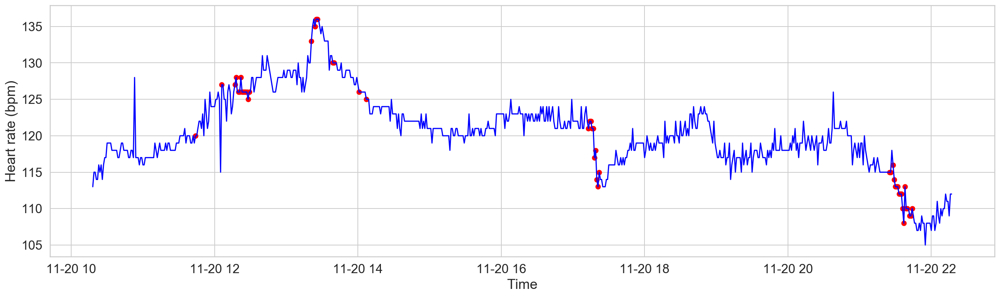

1


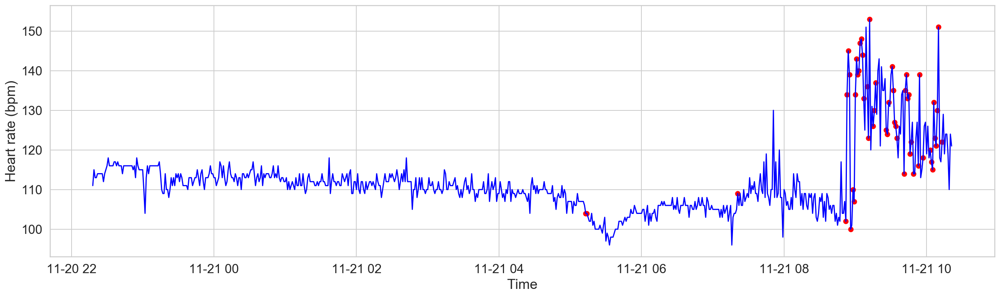

2


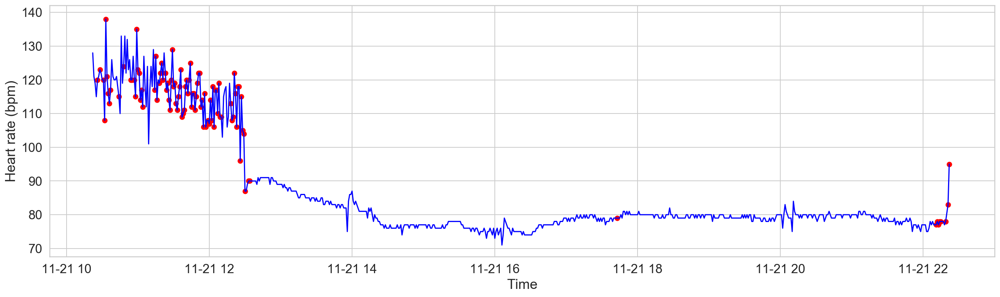

3


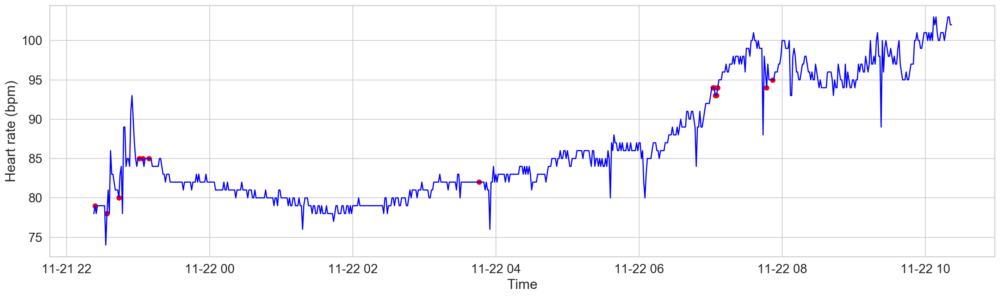

4


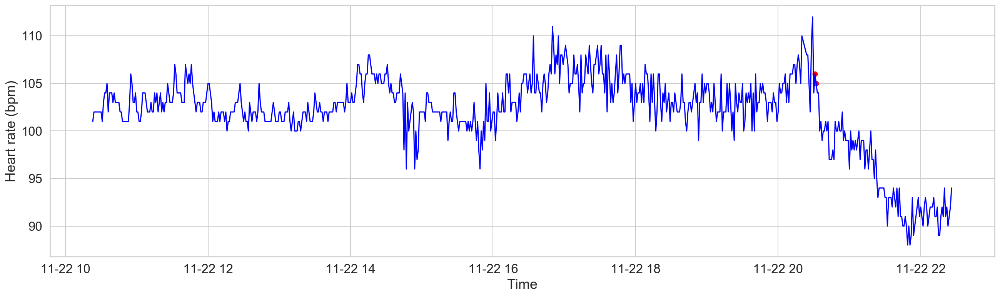

5


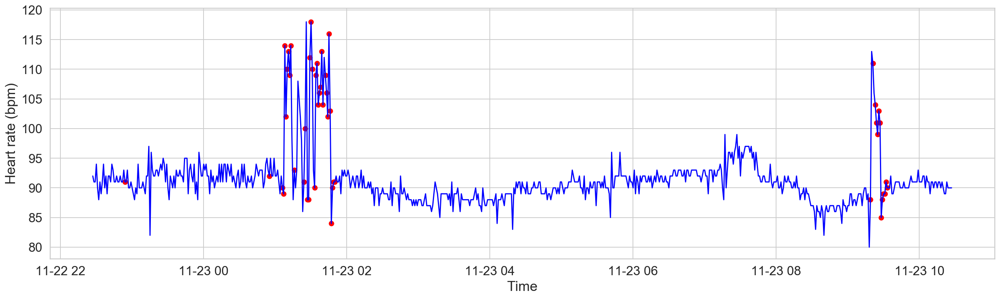

6


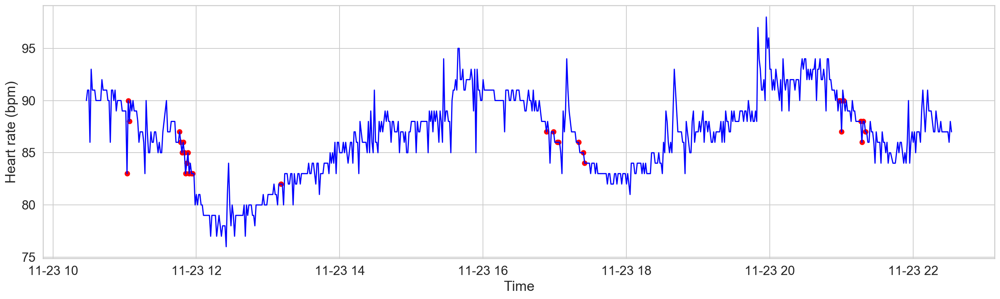

7


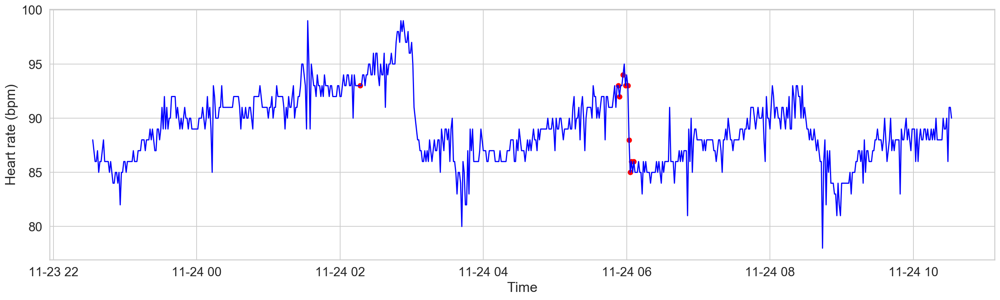

8


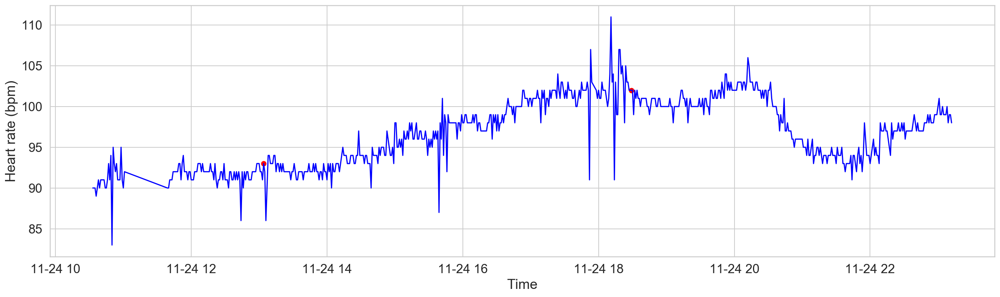

9


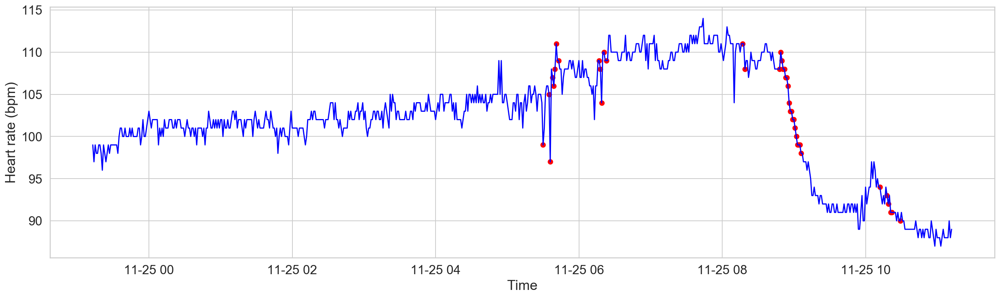

10


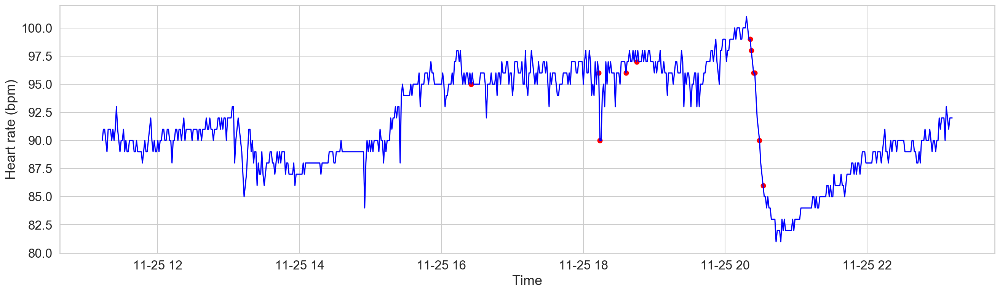

11


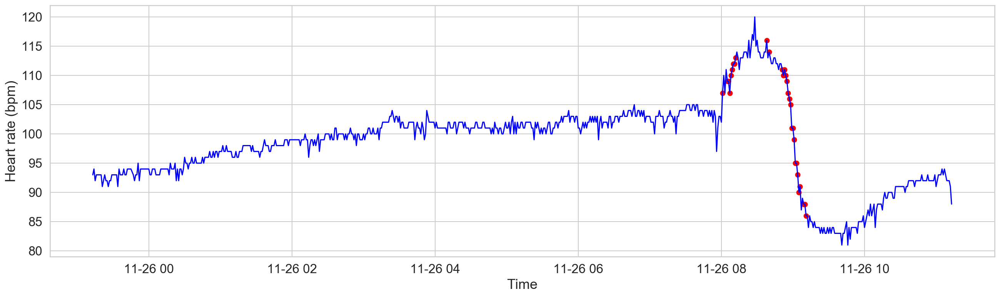

12


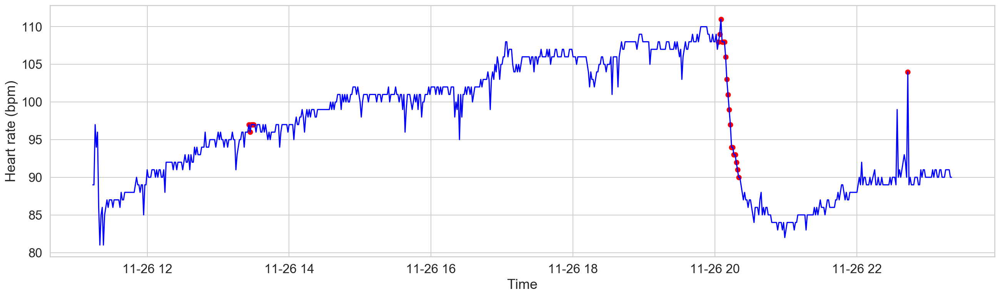

13


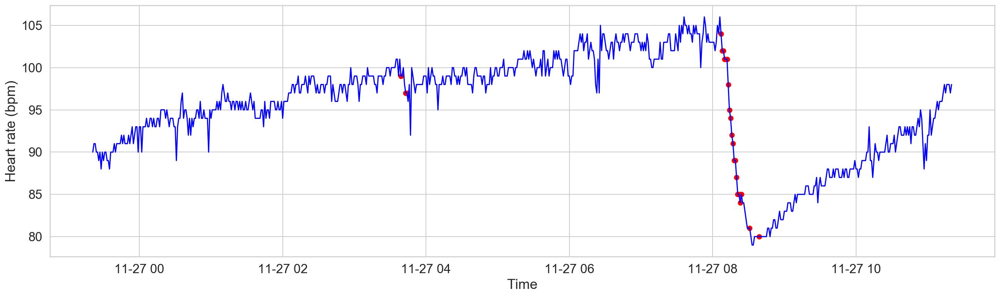

14


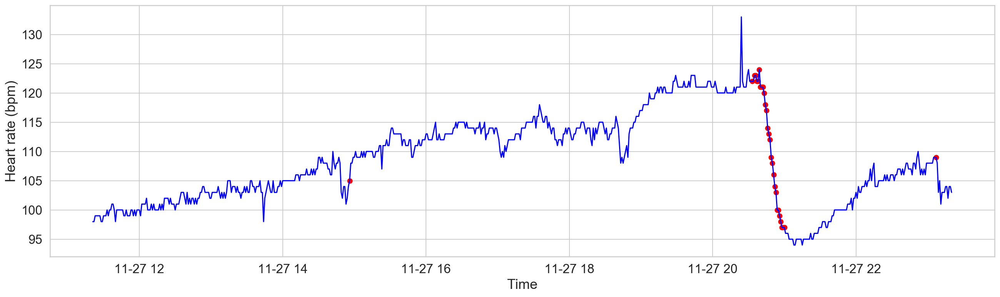

15


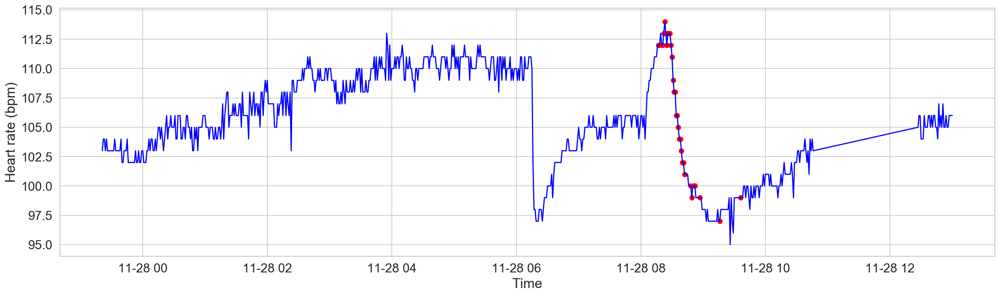

16


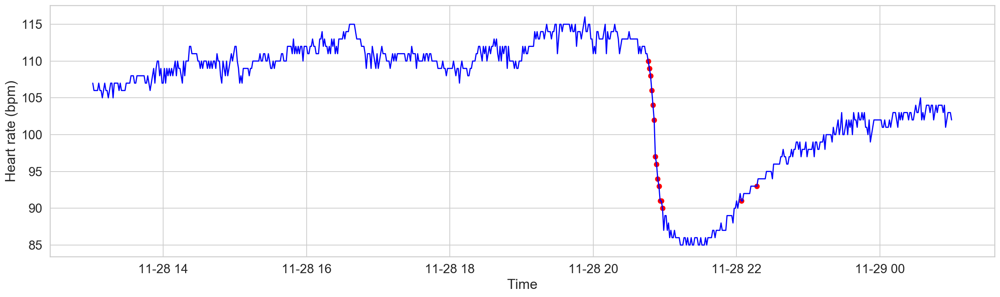

17


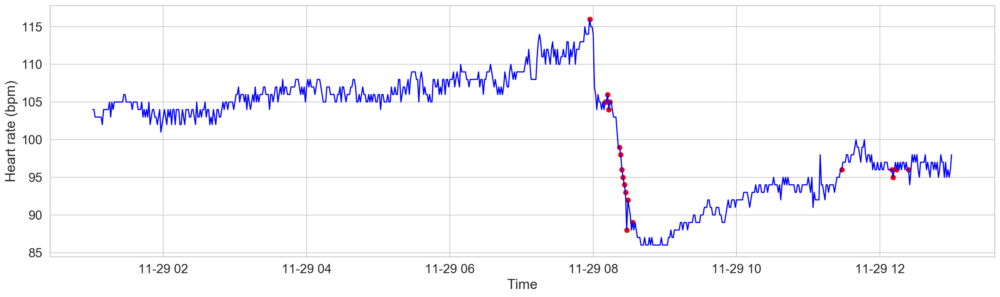

18


KeyError: 13680

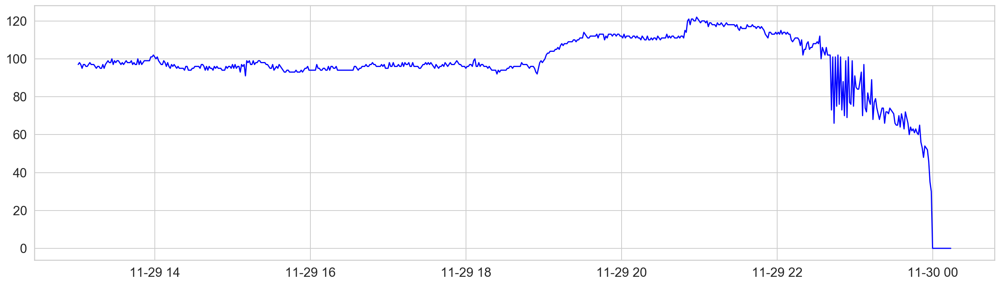

In [158]:
patient_number=97
y_predict_sample=my_prediction[patient_number]


patient_num=patient_number
aa=dataframe_collection[patient_num]
values=aa['Heart Rate'].dropna()
time=aa['Heart Rate ChartDate'].dropna()

labels=np.zeros(np.size(values))
i=np.where(np.array(patient_numbers)==patient_number)[0][0]
for chunk in patient_group[i]:
    labels[chunk[0]:chunk[1]]=int(1)

err=0
ter=0
for i in np.arange(np.size(labels)):
    if labels[i]>y_predict_sample[i]:
        err=err+1
    if y_predict_sample[i]>labels[i]:
        ter=ter+1
        
FN=err/np.sum(labels)       
print('false negative predictions are %f percent' %FN)
FP=ter/(np.size(labels)-np.sum(labels))
print('false positive predictions are %f percent' %FP)

np.sum(yhat)
    
rcParams['figure.figsize'] = 22, 6       
for plot_num in range(22):
    print(plot_num)
    day=0.5
    mm=int(24*60*day)*plot_num
    kk=int(24*60*day)*(plot_num+1)

    plot_time=time[y_predict_sample>0]
    plot_values=values[y_predict_sample>0]

    plt.plot(time[mm:kk],values[mm:kk], color='blue')
    plt.scatter(plot_time[(plot_time>time[mm])& (plot_time<time[kk]) ],    
            plot_values[(plot_time>time[mm])& (plot_time<time[kk]) ], color='red')
    plt.xlabel('Time')
    plt.ylabel('Heart rate (bpm)')
    plt.show()

# Implement RNN

In [254]:
!nvidia-smi

/bin/sh: nvidia-smi: command not found


In [260]:
!pip install gdown
!pip install tensorflow-gpu

import numpy as np
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters

%matplotlib inline
%config InlineBackend.figure_format='retina'

register_matplotlib_converters()
sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 22, 10

RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

You should consider upgrading via the '/Users/hosseinpiri/opt/anaconda3/bin/python -m pip install --upgrade pip' command.
ERROR: Could not find a version that satisfies the requirement tensorflow-gpu (from versions: none)
ERROR: No matching distribution found for tensorflow-gpu
You should consider upgrading via the '/Users/hosseinpiri/opt/anaconda3/bin/python -m pip install --upgrade pip' command.


### Normalize data and create training set

In [34]:
#patient_numbers[1:1000]
counter=-1
for i in np.arange(1,100):
    aa=dataframe_collection[i]
    new_values=np.array(aa['Heart Rate'].dropna())
    
    counter=counter+1
    if counter==0:
        values=np.array(aa['Heart Rate'].dropna())
        tt=np.size(values)
    else:
        tt=tt+np.size(new_values)
        values=np.append(values,new_values)

mean=np.mean(values)
std=np.std(values)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler = scaler.fit(pd.DataFrame(values))

def create_dataset(X, y,time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        
        #if np.sum(label.iloc[i:(i + time_steps+1)].values)<1:
        v = X.iloc[i:(i + time_steps)].values
        Xs.append(v)        
        ys.append(y.iloc[ i + time_steps])
            
    return np.array(Xs), np.array(ys)

In [35]:
time_steps=30
TIME_STEPS=time_steps

### Train set



#labels=np.zeros(np.size(df['HR']))
#for chunk in patient_group[0]:
#    labels[chunk[0]:chunk[1]]=int(1)        
#df['label']=labels



#np.delete(np.arange(98)+2,np.array(patient_numbers[24:30])-1)
#patient_numbers[1:25]
for j in np.arange(99)+1:
    if j==1:
        aa=dataframe_collection[j]
        df = pd.DataFrame()
        df['date'] =np.array(aa['Heart Rate ChartDate'].dropna())
        df['HR'] =np.array(aa['Heart Rate'].dropna())
        df['HR'] =scaler.transform(df[['HR']])
        X_train, y_train= create_dataset(df[['HR']],df.HR, TIME_STEPS)
    else:   
        aa=dataframe_collection[j]
        df = pd.DataFrame()
        df['date'] =np.array(aa['Heart Rate ChartDate'].dropna())
        df['HR'] =np.array(aa['Heart Rate'].dropna())
        df['HR'] =scaler.transform(df[['HR']])
        X_train_new, y_train_new = create_dataset(df[['HR']],df.HR, TIME_STEPS)
    
        X_train=np.append(X_train,X_train_new,axis=0)
        y_train=np.append(y_train,y_train_new,axis=0)
    
    ### Create labels
    #labels=np.zeros(np.size(df['HR']))
    #num=np.where(np.array(patient_numbers)==j)[0][0]
    #for chunk in patient_group[num]:
        #labels[chunk[0]:chunk[1]]=int(1)        
    #df['label']=labels
    
    
    #for plot_num in range(50):
        #mm=int(24*60*day)*plot_num
        #kk=int(24*60*day)*(plot_num+1)
        #if mm< len(df.HR):
            #fig= plt.figure(figsize=(20,6))

            #plt.plot(df[mm:kk].date, scaler.inverse_transform(df[mm:kk].HR), label='HR')

            #sns.scatterplot(df[mm:kk].date[df[mm:kk].label>0], scaler.inverse_transform(df[mm:kk].HR[df[mm:kk].label>0]),
                    #color=sns.color_palette()[3],s=52, label='anomaly' )
            #text='patient # %d '%j +'plot %d'%plot_num
            #plt.title(text)
            #plt.show()
    ### Plots checked, annotation translatio+implementation here are correcr   
    

        
print(np.shape(X_train))   

### Test set

#aa=dataframe_collection[patient_numbers[25]]
#df = pd.DataFrame()
#df['date'] =np.array(aa['Heart Rate ChartDate'].dropna())
#df['HR'] =np.array(aa['Heart Rate'].dropna())
#df['HR'] =scaler.transform(df[['HR']])

#labels=np.zeros(np.size(df['HR']))
#for chunk in patient_group[25]:
#    labels[chunk[0]:chunk[1]]=1        
#df['label']=labels

#X_test, y_test= create_dataset(df[['HR']],df.HR, df.label, TIME_STEPS)

#for j in patient_numbers[26:33]:
    
    #aa=dataframe_collection[j]
    #df = pd.DataFrame()
    #df['date'] =np.array(aa['Heart Rate ChartDate'].dropna())
    #df['HR'] =np.array(aa['Heart Rate'].dropna())
    #df['HR'] =scaler.transform(df[['HR']])
    ### Create labels
    #labels=np.zeros(np.size(df['HR']))
    #num=np.where(np.array(patient_numbers)==j)[0][0]
    #for chunk in patient_group[num]:
    #    labels[chunk[0]:chunk[1]]=1        
    #df['label']=labels
    
    #X_test_new, y_test_new = create_dataset(df[['HR']],df.HR,df.label, TIME_STEPS)
    
    #X_test=np.append(X_test,X_test_new,axis=0)
    #y_test=np.append(y_test,y_test_new,axis=0)
        
#print(np.shape(X_test))  

(686345, 30, 1)


In [36]:
model = keras.Sequential()
model.add(keras.layers.LSTM(
    units=64, 
    input_shape=(X_train.shape[1], X_train.shape[2])
))
model.add(keras.layers.Dropout(rate=0.2))
model.add(keras.layers.RepeatVector(n=X_train.shape[1]))
model.add(keras.layers.LSTM(units=64, return_sequences=True))
model.add(keras.layers.Dropout(rate=0.2))
model.add(keras.layers.TimeDistributed(keras.layers.Dense(units=X_train.shape[2])))
model.compile(loss='mae', optimizer='adam')

In [561]:
 .999888**2000

0.7993051070744976

In [37]:
history = model.fit(X_train, y_train,epochs=10,batch_size=32,
    v alidation_split=0.1,
    shuffle=False)

Epoch 1/10
19304/19304 [==============================] - 614s 32ms/step - loss: 0.1555 - val_loss: 0.2000
Epoch 2/10
19304/19304 [==============================] - 618s 32ms/step - loss: 0.1493 - val_loss: 0.1639
Epoch 3/10
19304/19304 [==============================] - 612s 32ms/step - loss: 0.1456 - val_loss: 0.1375
Epoch 4/10
19304/19304 [==============================] - 608s 31ms/step - loss: 0.1438 - val_loss: 0.1352
Epoch 5/10
19304/19304 [==============================] - 585s 30ms/step - loss: 0.1426 - val_loss: 0.1369
Epoch 6/10
19304/19304 [==============================] - 601s 31ms/step - loss: 0.1418 - val_loss: 0.1347
Epoch 7/10
19304/19304 [==============================] - 597s 31ms/step - loss: 0.1411 - val_loss: 0.1351
Epoch 8/10
19304/19304 [==============================] - 608s 31ms/step - loss: 0.1405 - val_loss: 0.1367
Epoch 9/10
19304/19304 [==============================] - 587s 30ms/step - loss: 0.1401 - val_loss: 0.1355
Epoch 10/10
19304/19304 [============

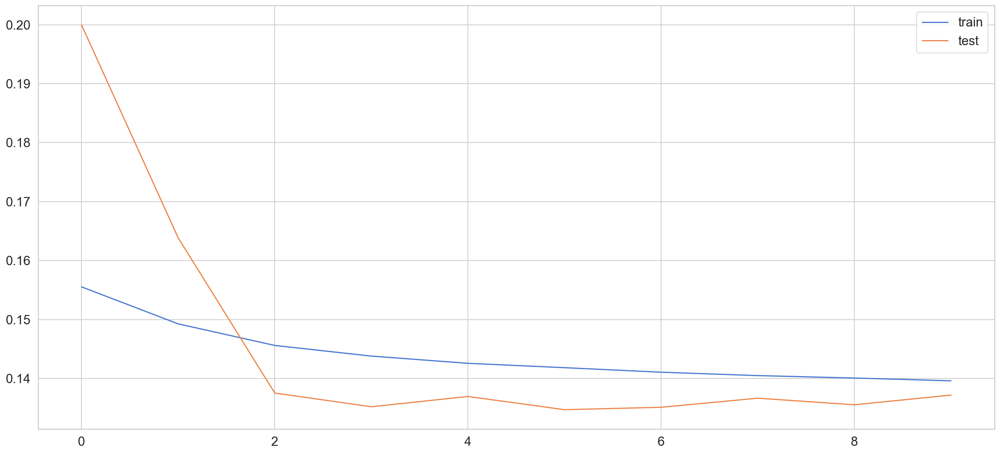

In [38]:
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend();

In [39]:
X_train_pred = model.predict(X_train)

train_mae_loss = np.mean(np.abs(X_train_pred - X_train), axis=1)

(0, 1)

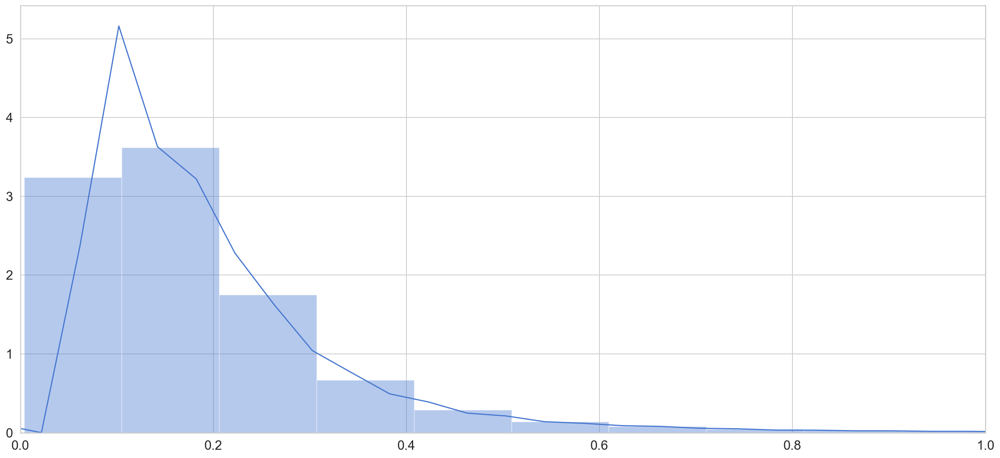

In [40]:
sns.distplot(train_mae_loss, bins=50, kde=True);
plt.xlim(0,1)

### detect anomalies for a sample patinet

In [83]:
patient_index=np.where(np.array(patient_numbers)==3)[0][0]

aa=dataframe_collection[patient_numbers[patient_index]]
test = pd.DataFrame()
test['date'] =np.array(aa['Heart Rate ChartDate'].dropna())
test['HR'] =np.array(aa['Heart Rate'].dropna())
test['HR'] =scaler.transform(test[['HR']])
#labels=np.zeros(np.size(test['HR']))       
#test['label']=labels

X_test, y_test= create_dataset(test[['HR']],test.HR, TIME_STEPS)

X_test_pred = model.predict(X_test)

test_mae_loss = np.mean(np.abs(X_test_pred - X_test), axis=1)

,loss,threshold,anomaly,HR
date,,,,
2015-05-01 23:07:00,0.202219,0.18,True,-1.212823
2015-05-01 23:08:00,0.222297,0.18,True,-1.167429
2015-05-01 23:09:00,0.225764,0.18,True,-0.895069
2015-05-01 23:10:00,0.199616,0.18,True,-1.076643
2015-05-01 23:11:00,0.200877,0.18,True,-1.167429


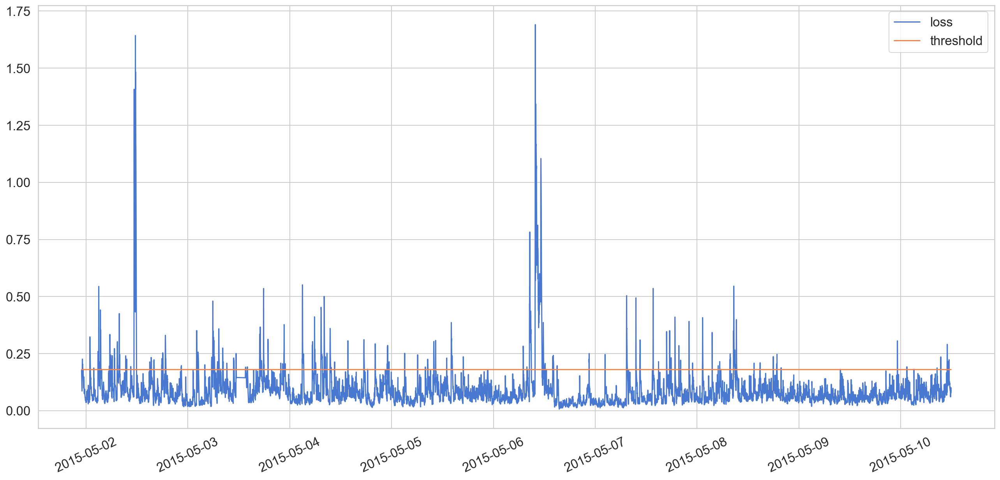

In [84]:
THRESHOLD = 0.18

test_score_df = pd.DataFrame(index=test[TIME_STEPS:].date)
test_score_df['loss'] = test_mae_loss
test_score_df['threshold'] = THRESHOLD
test_score_df['anomaly'] = test_score_df.loss > test_score_df.threshold
test_score_df['HR'] = np.array( test[TIME_STEPS:][['HR']] )

plt.plot(test_score_df.index, test_score_df.loss, label='loss')
plt.plot(test_score_df.index, test_score_df.threshold, label='threshold')
plt.xticks(rotation=25)
plt.legend();

anomalies = test_score_df[test_score_df.anomaly == True]
anomalies.head()

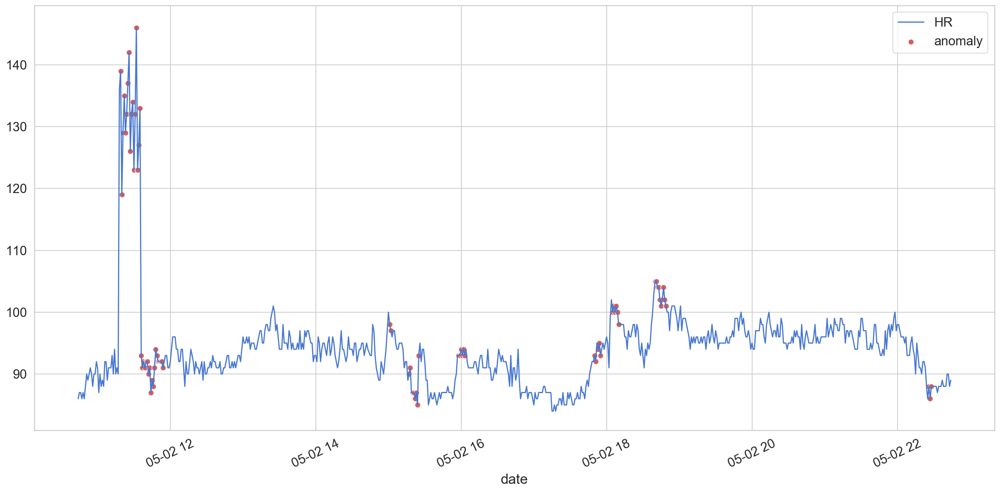

In [85]:
plot_num=1
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

#### Bunch of other plots

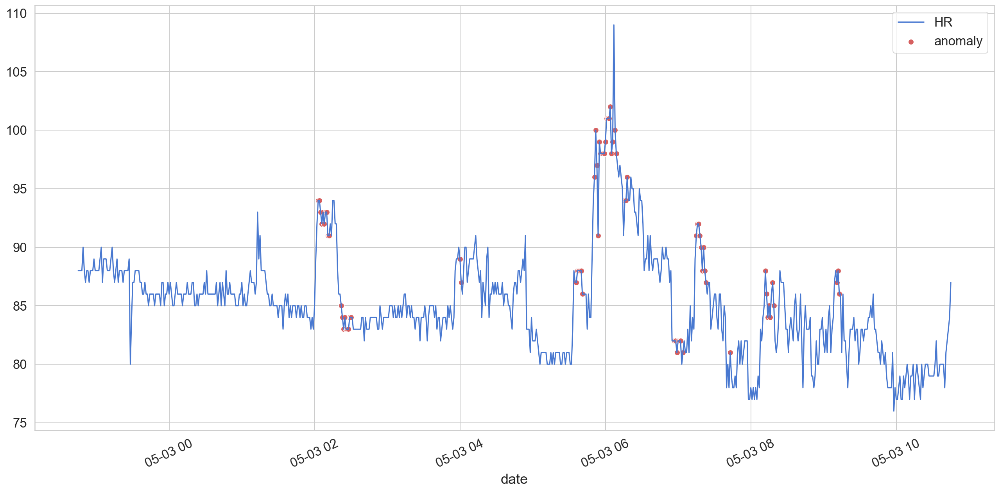

In [86]:
plot_num=2
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

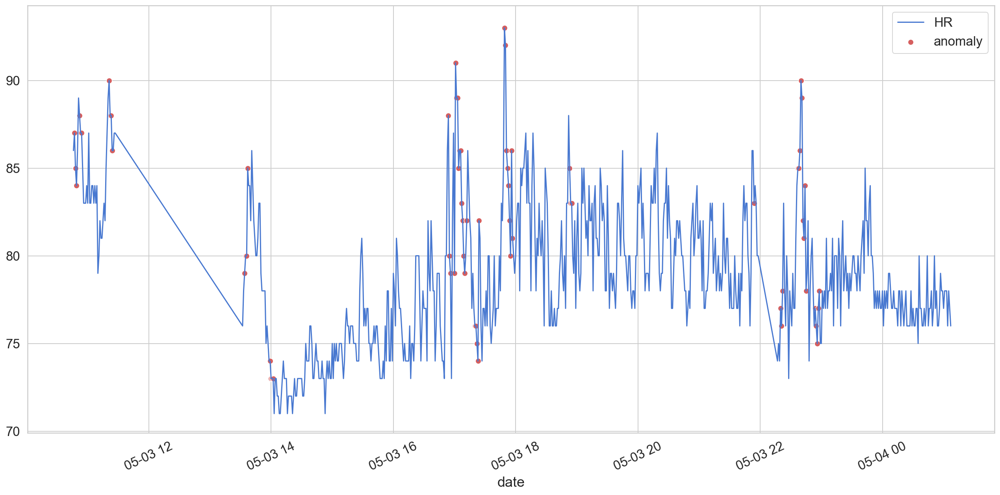

In [87]:
plot_num=3
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

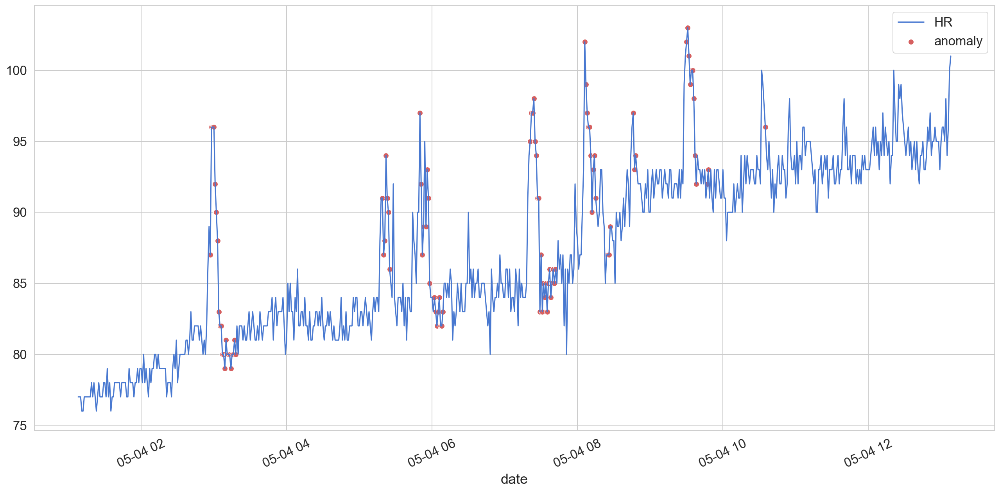

In [88]:
plot_num=4
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

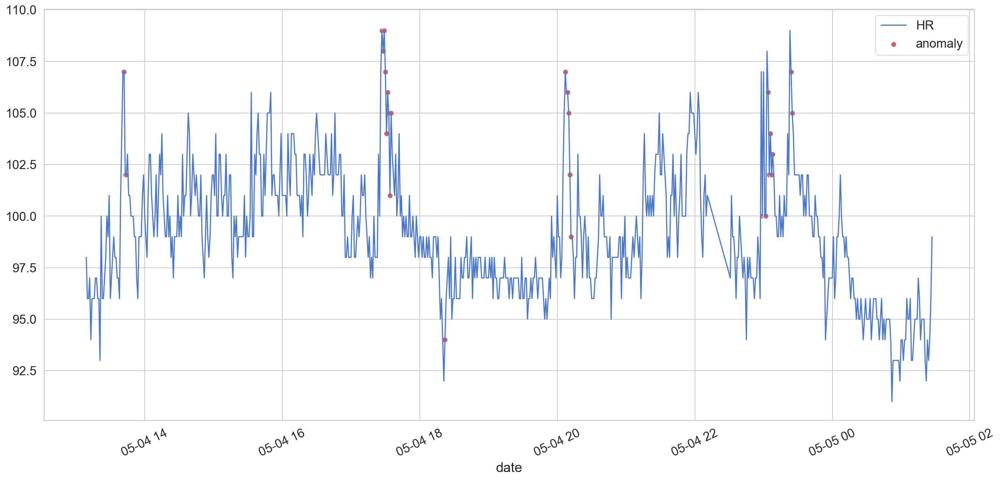

In [89]:
plot_num=5
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

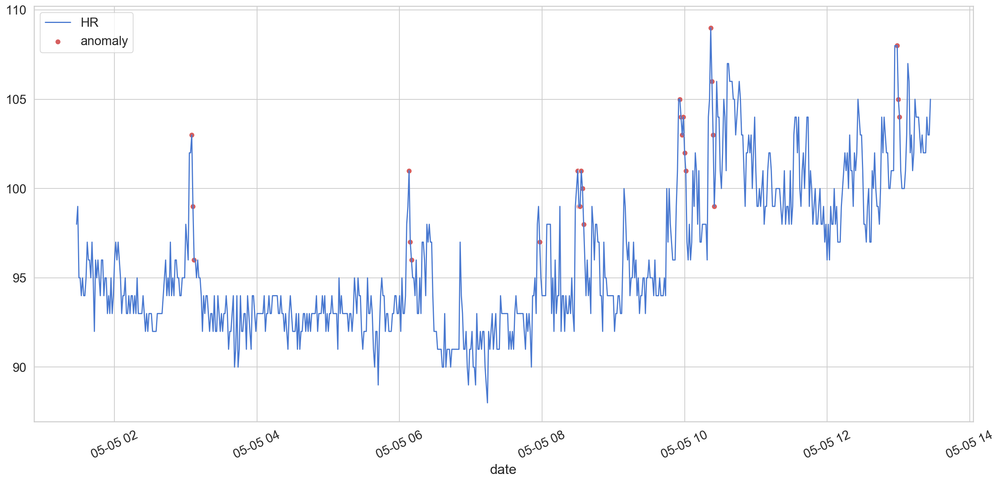

In [90]:
plot_num=6
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

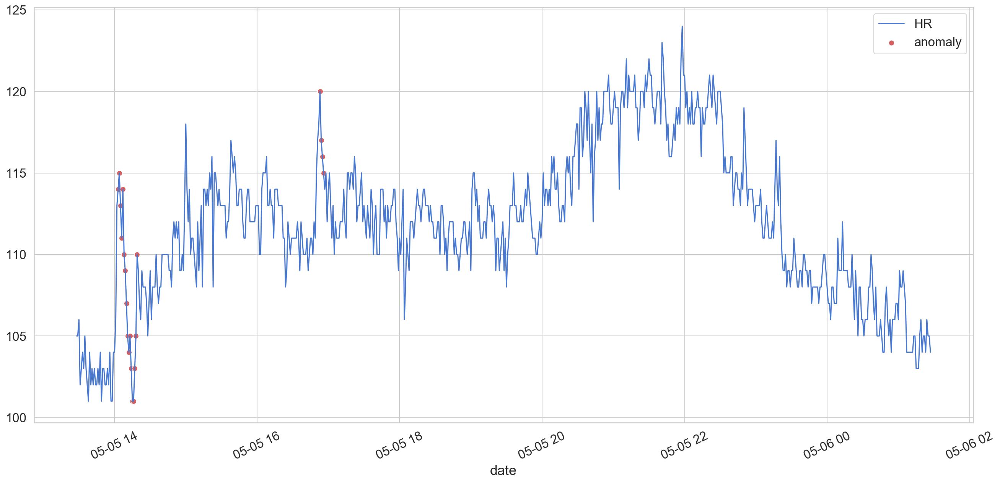

In [91]:
plot_num=7
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

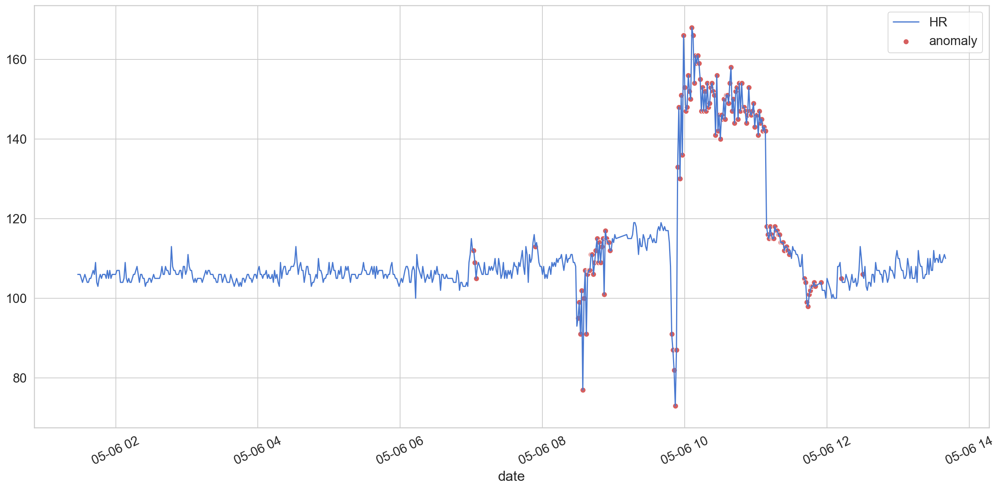

In [92]:
plot_num=8
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

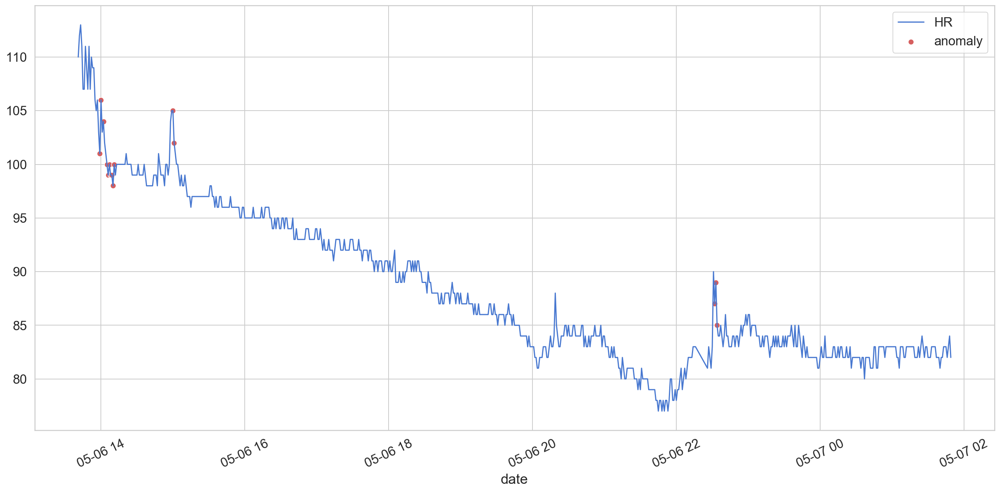

In [93]:
plot_num=9
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

plt.plot(
  test.date[mm:kk], 
  scaler.inverse_transform(test.HR[mm:kk]), 
  label='HR');

sns.scatterplot(
  anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
  scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
  color=sns.color_palette()[3],
  s=52, label='anomaly')
plt.xticks(rotation=25)
plt.legend();

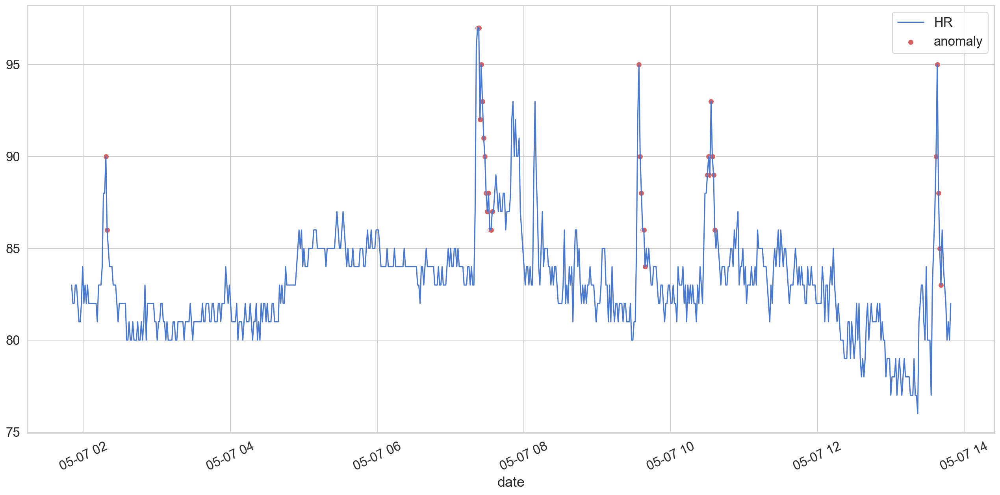

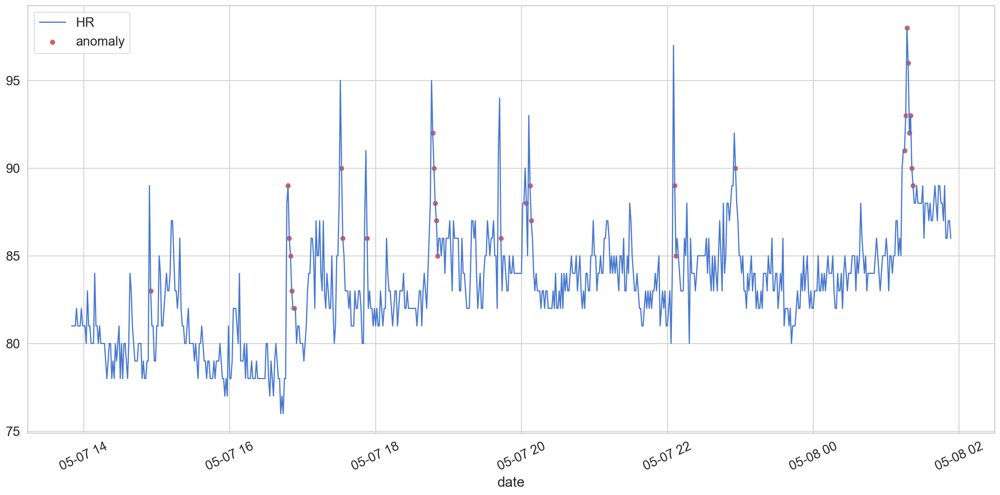

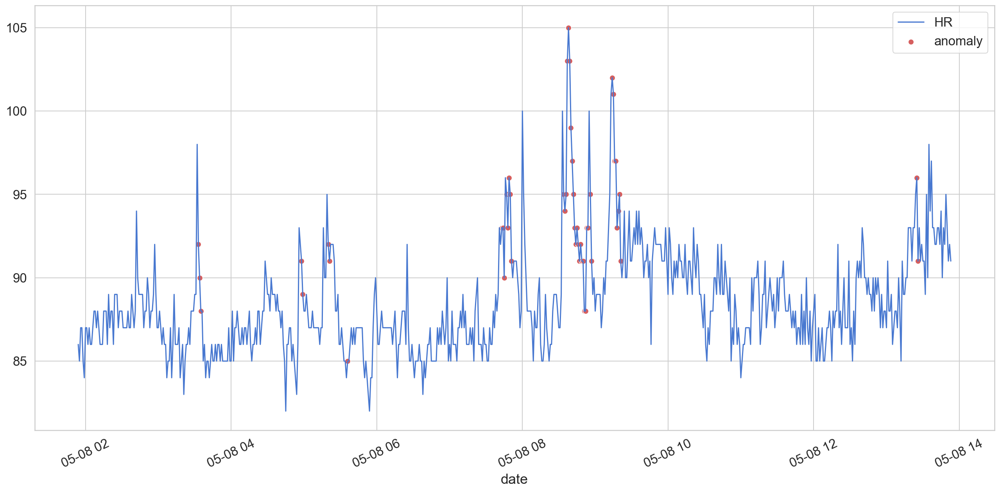

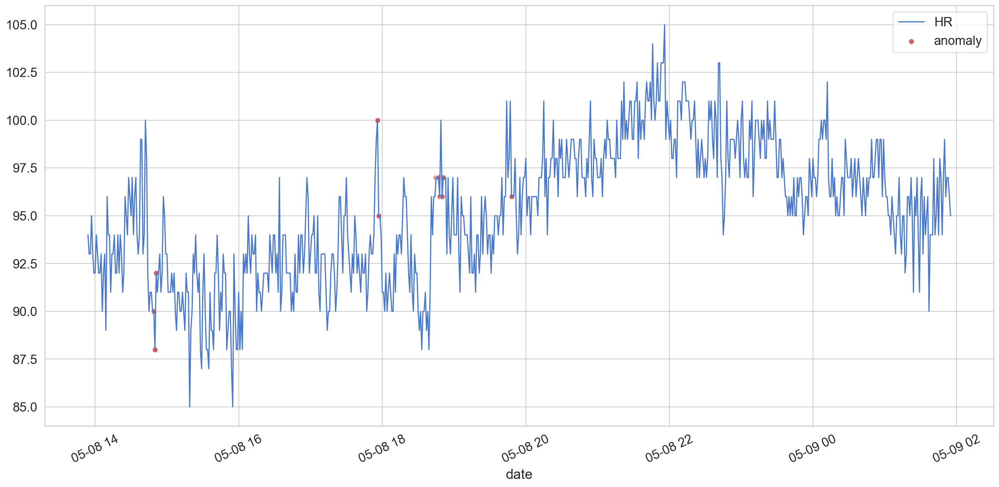

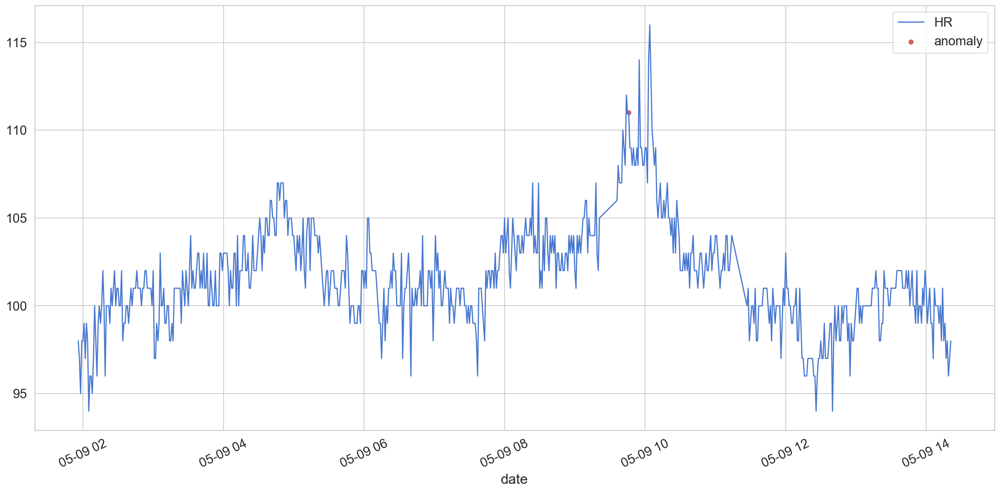

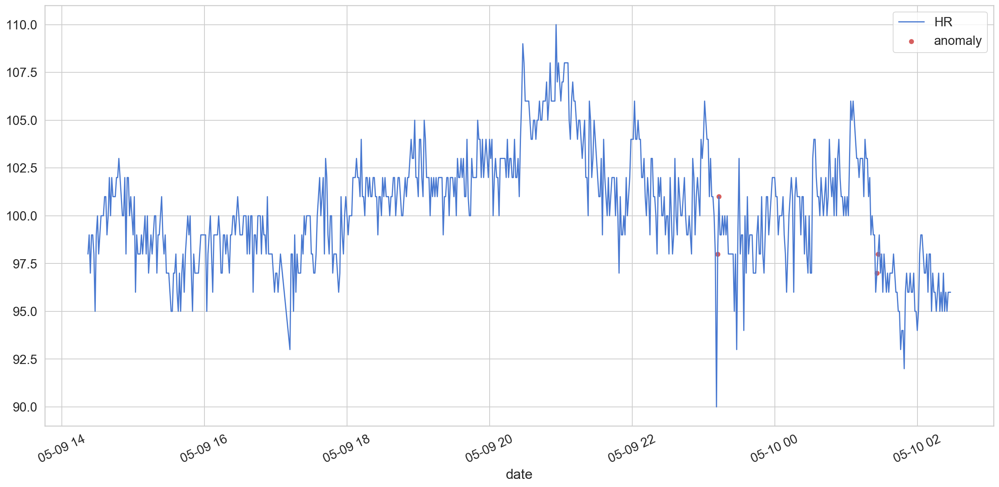

KeyError: 12240

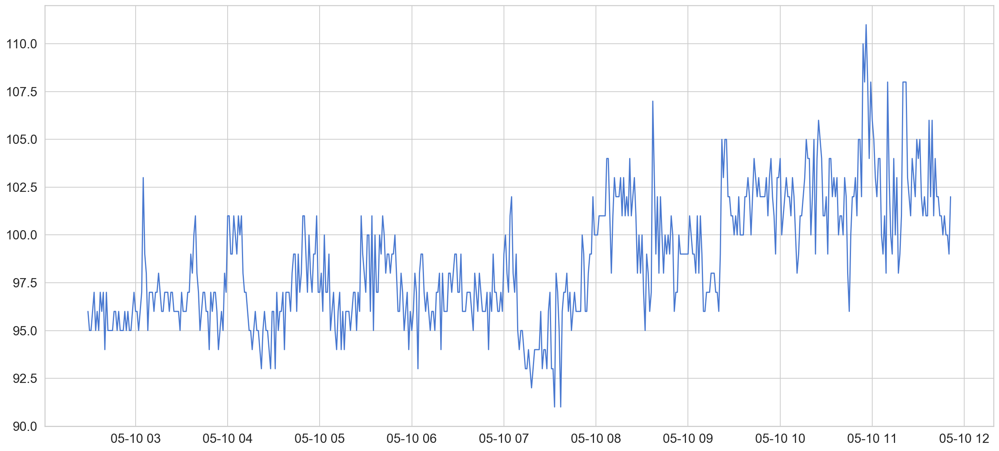

In [96]:
for plot_num in range(10,17):
    day=0.5
    mm=int(24*60*day)*plot_num
    kk=int(24*60*day)*(plot_num+1)

    plt.plot(
      test.date[mm:kk], 
      scaler.inverse_transform(test.HR[mm:kk]), 
      label='HR');

    sns.scatterplot(
      anomalies.index[(anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ],
      scaler.inverse_transform(anomalies.HR[ (anomalies.index>test.date[mm]) & (anomalies.index<test.date[kk]) ]),
      color=sns.color_palette()[3],
      s=52, label='anomaly')
    plt.xticks(rotation=25)
    plt.legend();
    plt.show()

### Calculate error for test patients

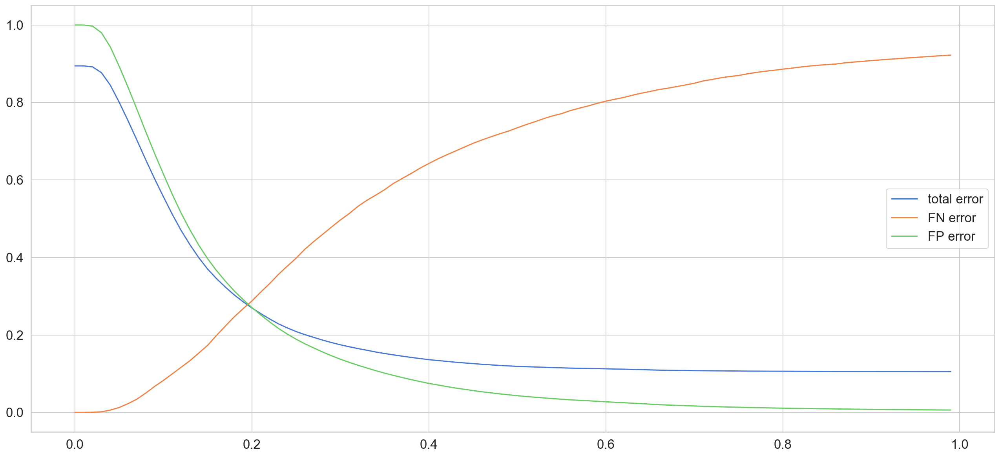

min error is 0.105227


In [41]:
n=100
patient_set=patient_numbers
#patient_numbers

errors=np.zeros((n,len(patient_set)))
FN=np.zeros((n,len(patient_set)))
FP=np.zeros((n,len(patient_set)))
length=np.zeros(len(patient_set))

all_predictions={}

for i in range(len(patient_set)):
    
    patient_num=patient_set[i]
    #print('patient# %d'%patient_num)
    
    aa=dataframe_collection[patient_num]
    values=aa['Heart Rate'].dropna() 
    length[i]=len(values)
    
    test = pd.DataFrame()
    test['date'] =np.array(aa['Heart Rate ChartDate'].dropna())
    test['HR'] =np.array(values)
    test['HR'] =scaler.transform(test[['HR']])

    X_test, y_test= create_dataset(test[['HR']],test.HR, TIME_STEPS)
    X_test_pred = model.predict(X_test)
    test_mae_loss = np.mean(np.abs(X_test_pred - X_test), axis=1)

    ### Create labels
    labels=np.zeros(np.size(values))
    ii=np.where(np.array(patient_numbers)==patient_num)[0][0]
    for chunk in patient_group[ii]:
        labels[chunk[0]:chunk[1]]=int(1)
    darren=labels[TIME_STEPS:]
    #hand_crafted_predict=hand_crafted(5,30,patient_num)
    #hand_crafted_predict=hand_crafted_predict[TIME_STEPS:]
    
    k=-1
    #np.arange(n)/n
    for THRESHOLD in np.arange(n)/n:
        k=k+1
        test_score_df = pd.DataFrame(index=test[TIME_STEPS: ].date)
        test_score_df['loss'] = test_mae_loss
        test_score_df['threshold'] = THRESHOLD
        test_score_df['anomaly'] = test_score_df.loss > test_score_df.threshold
        test_score_df['HR'] = np.array( test[TIME_STEPS:][['HR']] )
        
        predict=np.array(test_score_df.anomaly)
 
        
        ### Add prediction from here and hand crafted predict
        #predict=[max(predict[q],hand_crafted_predict[q]) for q in range(len(predict))]
            
        

        
        ### Exclude points with score less than a certain threshold
        #score_tre=20
        #scores=np.zeros(len(predict))
        #pointer=0
        #for s in range(len(predict)):
            #if pointer<len(predict):
                #score=0
                #for w in range(len(predict)-pointer):
                    #if predict[pointer+w]==1:
                        #score=score+1
                    #else:
                        #break
                #scores[pointer:pointer+score]=score
                #pointer=pointer+max(1,score)
        
        #for ka in range(len(scores)):
            #if scores[ka]<score_tre:
                #predict[ka]=0 
                
                
               
        #### Record the prediction  
        recorded_predict=np.zeros(np.shape(test)[0])
        recorded_predict[TIME_STEPS:]=predict
        all_predictions[patient_num]=recorded_predict
        
        
            
        er=np.mean(np.abs(darren-predict))
        errors[k,i]=er
        
        fn=0
        fp=0
        for r in np.arange(np.size(predict)):
            if darren[r]>predict[r]:
                fn=fn+1
            if predict[r]>darren[r]:
                fp=fp+1
        FN[k,i]=fn/max(1,np.sum(darren))
        FP[k,i]=fp/(np.size(darren)-np.sum(darren))

length=length/np.sum(length)

FN_vec=np.zeros(n)
FP_vec=np.zeros(n)
errors_vec=np.zeros(n)

k=-1
for THRESHOLD in np.arange(n)/n:
    k=k+1
    FN_vec[k]=np.dot(FN[k,:],length)
    FP_vec[k]=np.dot(FP[k,:],length)
    errors_vec[k]=np.dot(errors[k,:],length)
    
plt.plot(np.arange(n)/n,errors_vec, label='total error')
plt.plot(np.arange(n)/n,FN_vec, label='FN error')
plt.plot(np.arange(n)/n,FP_vec, label='FP error')
plt.legend()
plt.show() 
print('min error is %f' %min(errors_vec))

### IMPLEMENT the following if you would like to see intervals are being predicted correct

#for chunk in patient_group[patient_index]:
    #b=predict[chunk[0]-TIME_STEPS:chunk[1]-TIME_STEPS]
    #if np.sum(b)>=1:
        #predict[chunk[0]-TIME_STEPS:chunk[1]-TIME_STEPS]=1

In [46]:
100*FN_vec[10:50]

array([ 8.23964241,  9.9378591 , 11.64081224, 13.34718091, 15.31935281,
       17.30721272, 19.86195903, 22.27478801, 24.63935282, 26.76342681,
       28.75106072, 31.05577483, 33.22648741, 35.61928669, 37.74151686,
       39.80779258, 42.13890656, 44.11008428, 45.97062807, 47.84807731,
       49.66345784, 51.31778341, 53.20612251, 54.74873844, 56.08713863,
       57.4857834 , 59.10225427, 60.40447796, 61.6694983 , 63.04123381,
       64.24529114, 65.41705449, 66.46941487, 67.45528815, 68.46791488,
       69.45598861, 70.32244543, 71.13903042, 71.89084763, 72.62260114])

In [47]:
100*FP_vec[10:50]

array([61.52835677, 56.3077649 , 51.46311646, 47.14517954, 43.17211893,
       39.67051879, 36.61827138, 33.89029686, 31.37866638, 29.14554078,
       27.06847455, 25.17000889, 23.37911524, 21.68671856, 20.21933275,
       18.89738023, 17.69333349, 16.62696004, 15.58848532, 14.61483094,
       13.73423055, 12.92236891, 12.159678  , 11.46523458, 10.76859005,
       10.137981  ,  9.54161063,  8.9868066 ,  8.46266649,  7.96390547,
        7.48404194,  7.08518119,  6.68405397,  6.30041578,  5.95907764,
        5.6402148 ,  5.32182918,  5.0544197 ,  4.78371893,  4.54772622])

### Results with combining hand-crafted NN and RNN

In [378]:
100*FN_vec[10:25]

array([ 9.13103327, 10.82524332, 12.72340917, 14.72945875, 16.72586216,
       18.64231318, 21.16213199, 23.36789143, 25.70536574, 28.5883209 ,
       30.86521188, 32.98382845, 35.0079684 , 36.99729349, 38.75565777])

In [379]:
100*FP_vec[10:25]

array([54.49287465, 49.31559775, 44.85432067, 40.87159424, 37.33785999,
       34.17484442, 31.35231878, 28.90555555, 26.69386112, 24.68948006,
       22.89806747, 21.13536681, 19.63049319, 18.24465996, 16.94374061])

### Plot average of previons n point

Error
0.21108992225319057
FN
0.34073185362927416
FP
0.19303083479568814


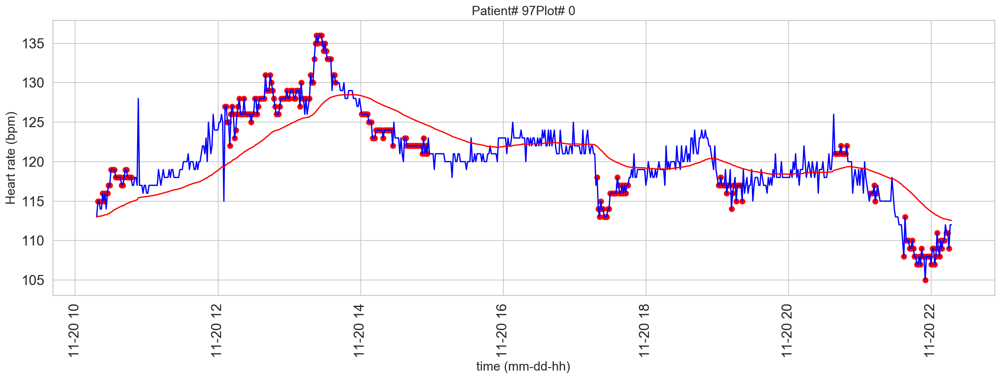

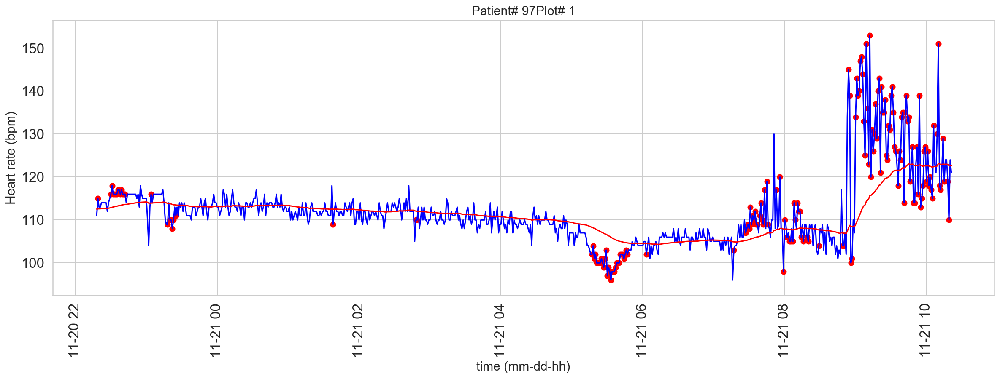

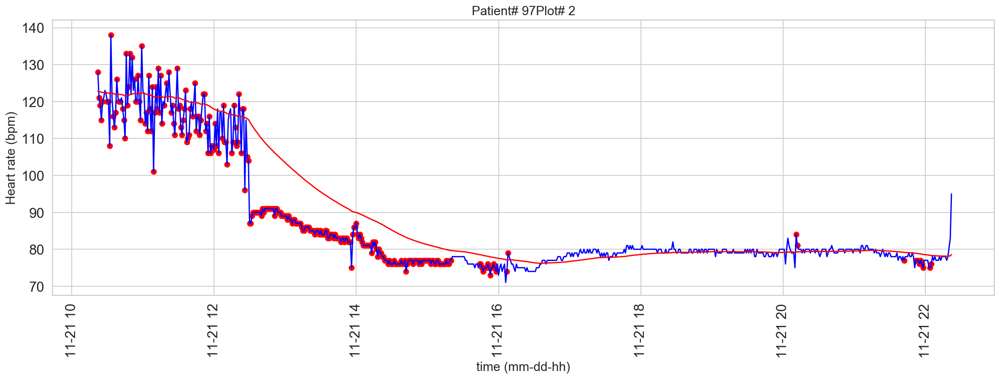

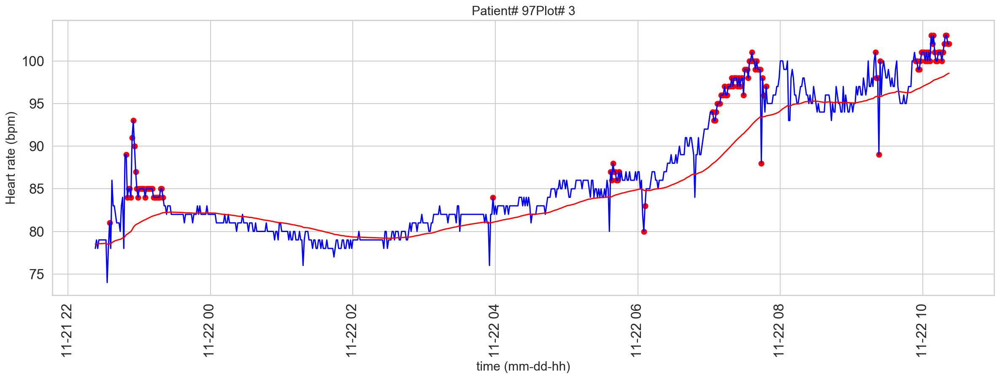

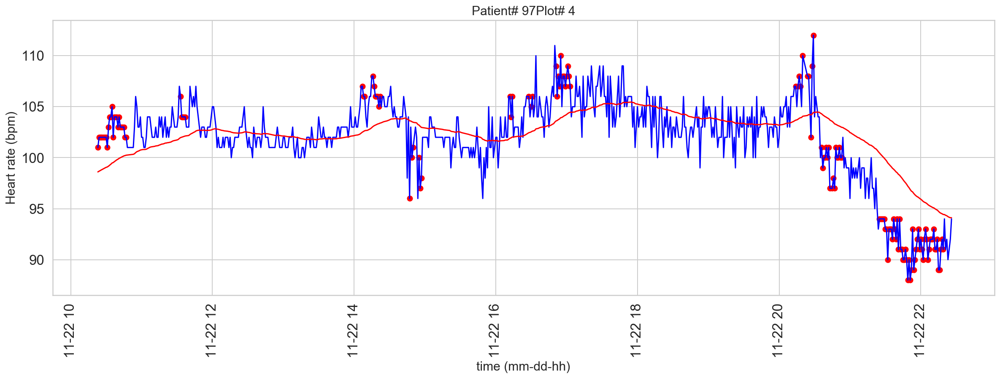

...

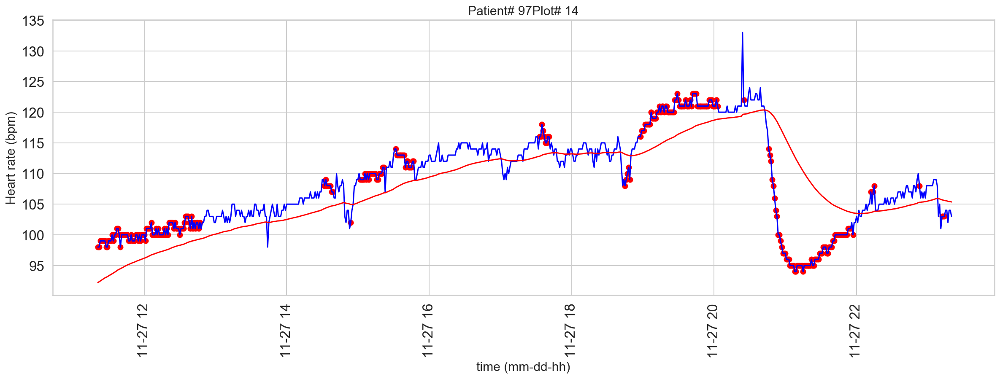

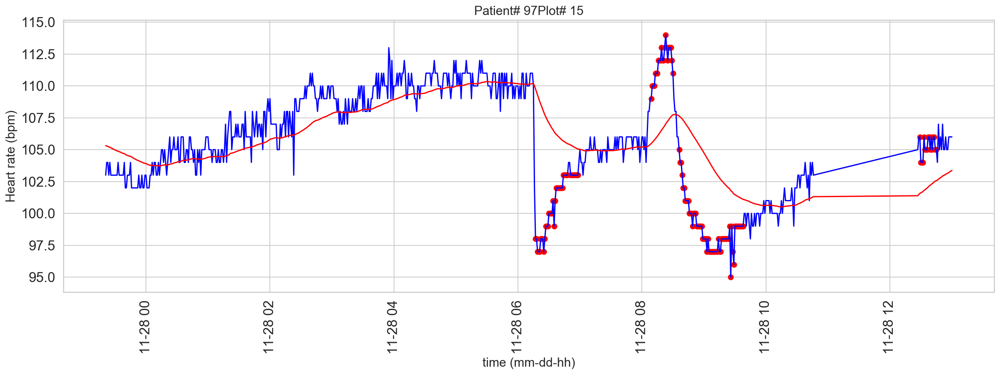

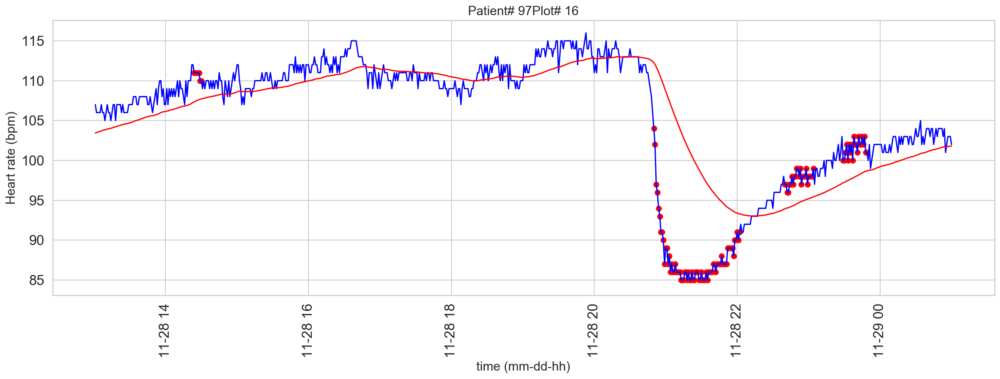

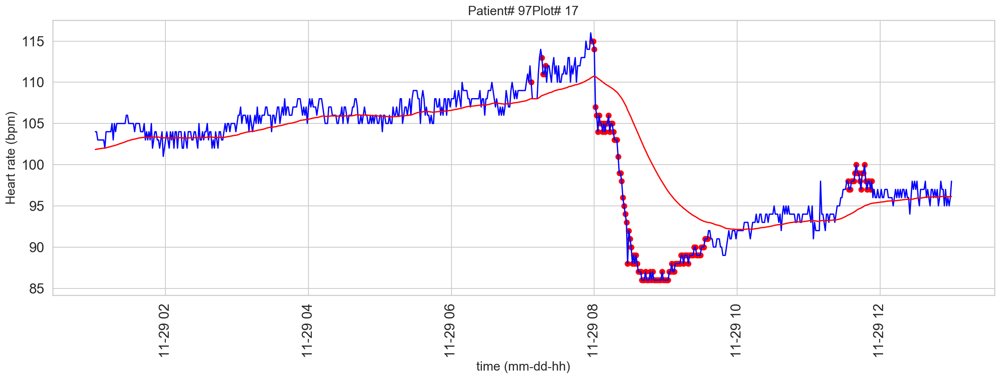

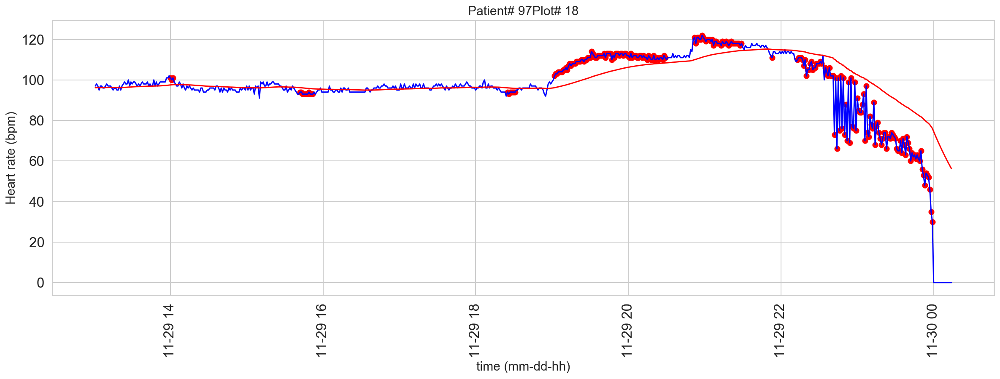

In [391]:
beta=0.98
day=0.5



for patient_number in [97]:
    patient_index=np.where(np.array(patient_numbers)==97)[0][0]
    
    
    
    aa=dataframe_collection[patient_number]
    df = pd.DataFrame()
    df['date'] =np.array(aa['Heart Rate ChartDate'].dropna())
    df['HR'] =np.array(aa['Heart Rate'].dropna())
    
    V=np.array(df.HR)
    
    for i in np.arange(len(V)-1)+1:
        V[i]=beta*V[i-1]+(1-beta)*V[i]

    df['average']=V
    avg_diff=np.mean(np.abs(V-np.array(df.HR)))
    flag=np.zeros(np.size(V))
                     
    for h in range(len(V)):
        if np.abs(V[h]-np.array(df.HR)[h])>0.6*avg_diff:
            flag[h]=np.array(df.HR)[h]

    predict2=np.zeros(len(flag))
    for pp in np.arange(len(flag)):
        if flag[pp]>0:
            predict2[pp]=1 
            
    df['flag']=flag    


    #kk=1
    #for s in np.arange(len(flag)-2)+1:
        #if np.sum(predict2[s:s+kk])<kk:
            #predict2[s]=0

    
    
    short_predict=predict2[TIME_STEPS:]
    ma_predict=np.zeros(len(predict))
    
    for q in range(len(predict)):
        if predict[q]==1:
            ma_predict[q]=int(1)
            for w in np.arange(len(ma_predict)-q-1)+1:
                if short_predict[q+w]==1:
                    ma_predict[q+w]=int(1)
                else:
                    break
                        
            
    predict2[TIME_STEPS:]=ma_predict
    df['predict2']=predict2
    
    
    labels=np.zeros(np.size(flag))
    for chunk in patient_group[patient_index]:
        labels[chunk[0]:chunk[1]]=1

    error=np.mean(np.abs(labels-predict2))
    fn=0
    fp=0
    for e in np.arange(len(labels)):
        if labels[e]>predict2[e]:
            fn=fn+1
        if predict2[e]>labels[e]:
            fp=fp+1
    
    
    print('Error')
    print(np.mean(np.abs(labels-predict2)))
    
    print('FN')
    print(fn/np.sum(labels))
        
    print('FP')
    print(fp/(np.size(labels)-np.sum(labels)))
    
    
    
    
    for plot_num in np.arange(50):
        m=int(24*60*day)*plot_num
        k=int(24*60*day)*(plot_num+1)
    
                           
                   
        if m<=np.size(V): 
            fig= plt.figure(figsize=(20,6))
            plt.plot(df.date.iloc[m:k],df.HR.iloc[m:k], color='blue')
            plt.plot(df.date.iloc[m:k],df.average.iloc[m:k], color='red')
                     
            flag_time=df.date.iloc[m:k]
            flag_value=df.flag.iloc[m:k]
            plt.scatter(flag_time[(df.predict2>0) & (flag_value>0)],flag_value[(df.predict2>0) & (flag_value>0)], color='red')
                     

            plt.title('Patient# %d' %patient_number+'Plot# %d' %plot_num, size=15)


            plt.xlabel('time (mm-dd-hh)', size=15)
            plt.xticks( rotation=90 )
            plt.ylabel('Heart rate (bpm)', size=15)
            plt.show()
        else:
            break


### Derivative

FN
0.44991001799640074
FP
0.45174229130107796


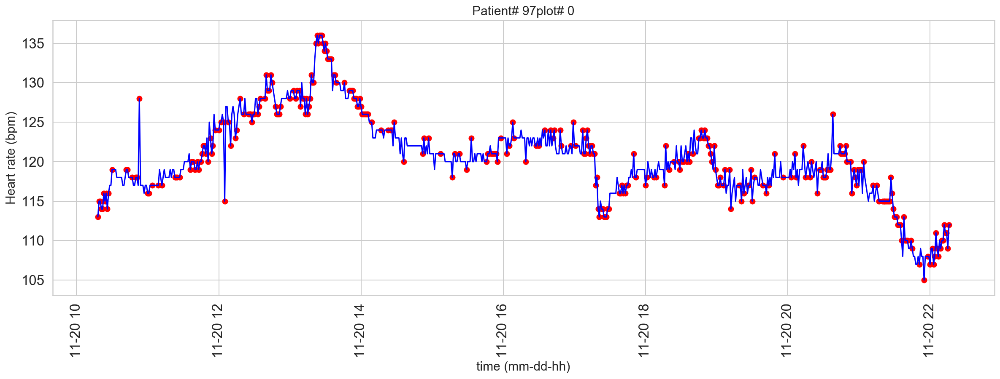

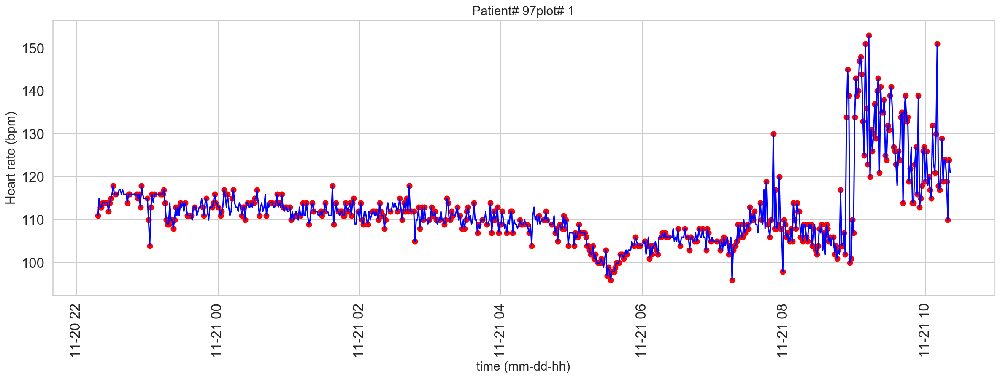

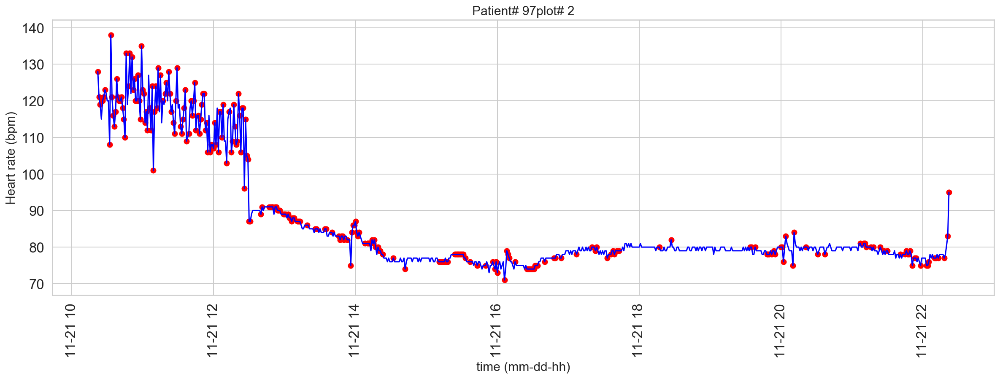

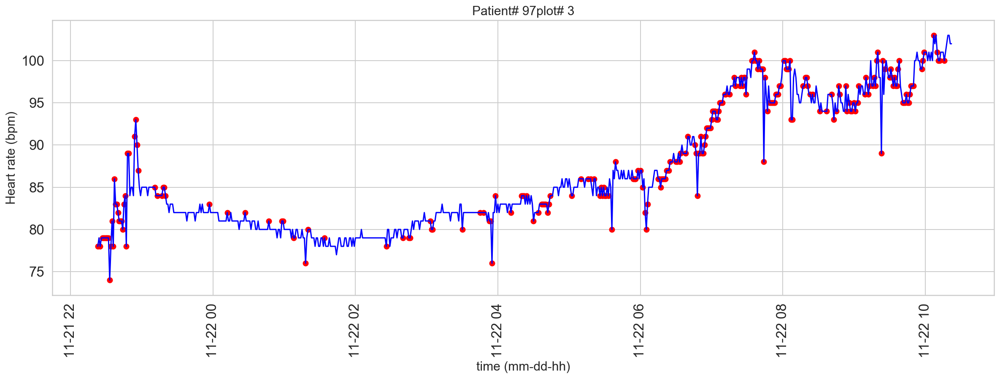

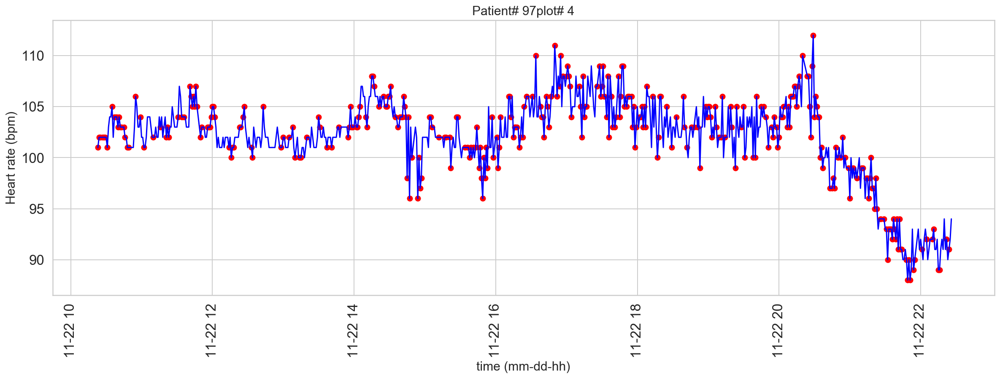

...

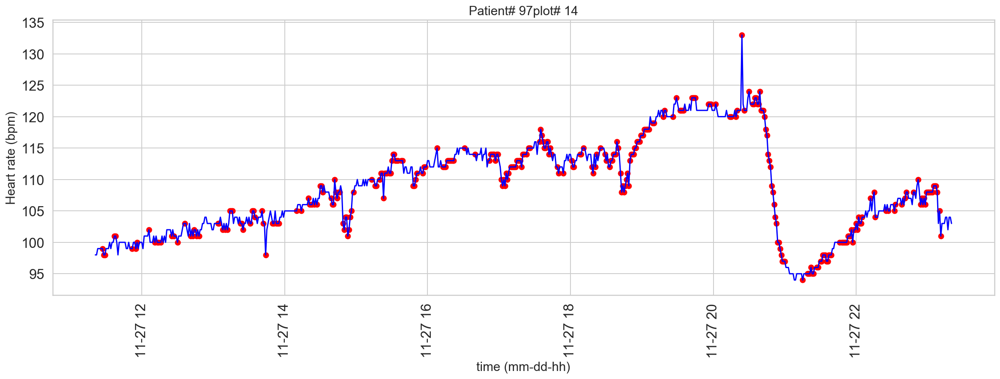

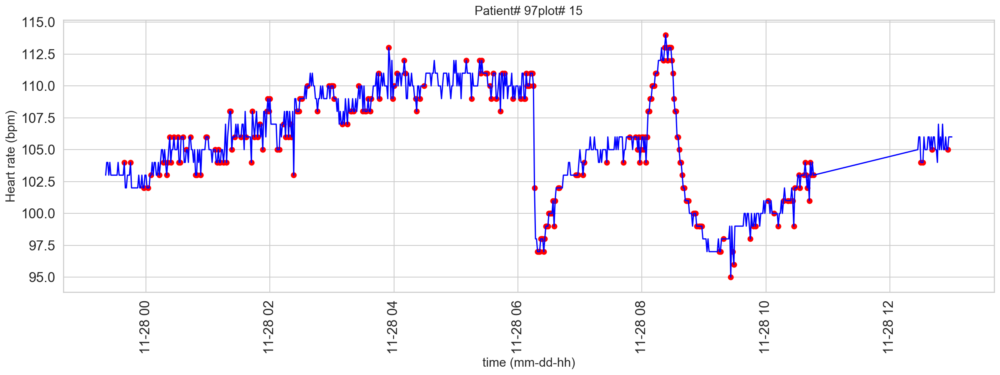

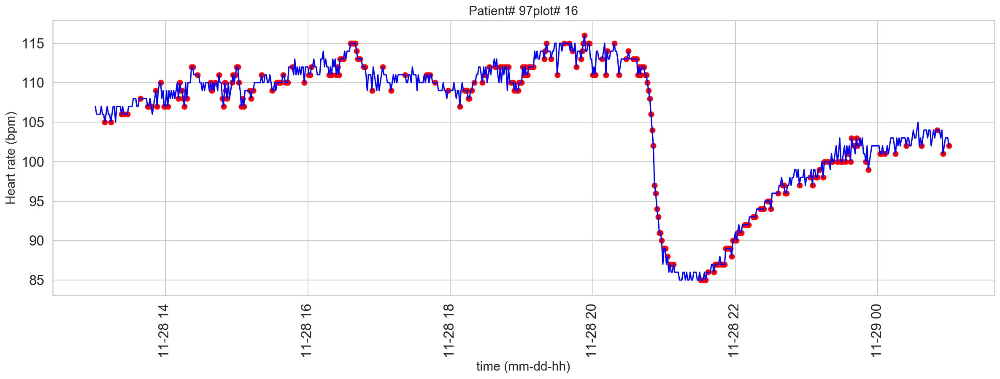

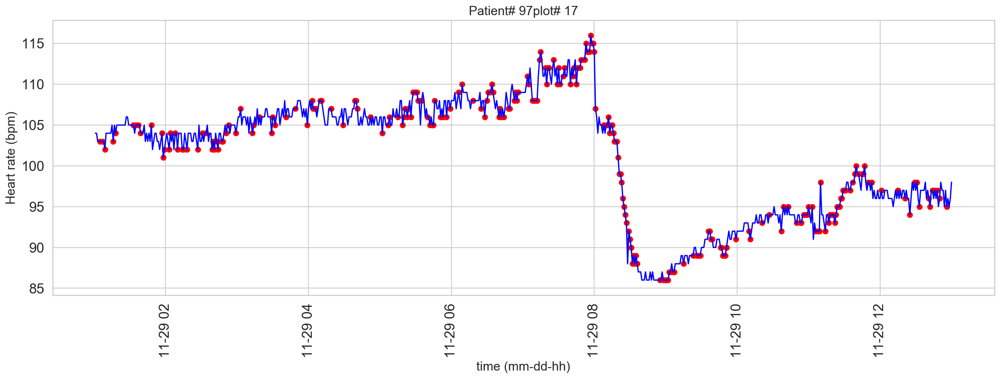

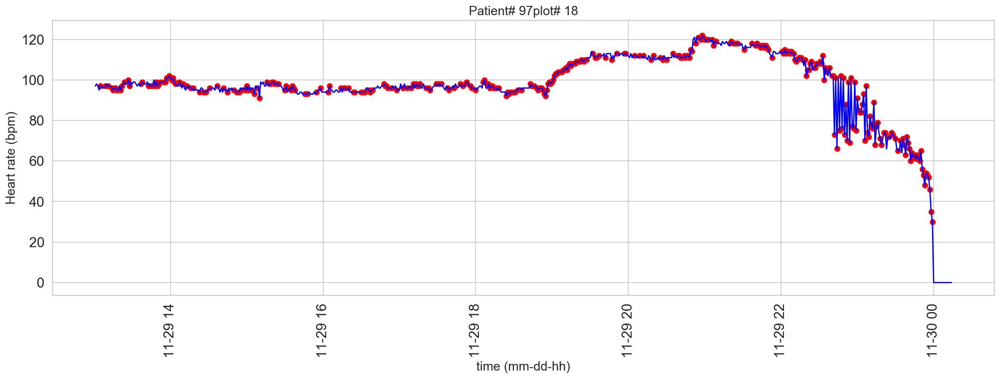

In [189]:
beta=0.95
day=0.5
derivative_factor=10


for patient_number in [97]:
    
    aa=dataframe_collection[patient_number]
    df = pd.DataFrame()
    df['date'] =np.array(aa['Heart Rate ChartDate'].dropna())
    df['HR'] =np.array(aa['Heart Rate'].dropna())
    HR=np.array(df['HR'] )
    
    derivative=np.zeros(len(df.HR))
    
    for i in range(len(derivative)-derivative_factor):
        derivative[i]=(np.abs(HR[i+derivative_factor]-HR[i]))/derivative_factor

    df['derivative']=derivative
    avg_der=np.mean(derivative)
    flag=np.zeros(len(df.HR))
                     
    for h in range(len(derivative)-derivative_factor):
        if derivative[h]>1*avg_der:
            flag[h]=np.array(df.HR)[h]
    df['flag']=flag
    

    labels=np.zeros(np.size(flag))
    for chunk in patient_group[patient_index]:
        labels[chunk[0]:chunk[1]]=1

    error=np.mean(np.abs(labels-flag))
    fn=0
    fp=0
    for e in np.arange(len(labels)):
        
        if labels[e]>flag[e]:
            fn=fn+1
            
        if flag[e]>labels[e]:
            fp=fp+1
    print('FN')
    print(fn/np.sum(labels))
        
    print('FP')
    print(fp/(np.size(labels)-np.sum(labels)))
    
    

    for plot_num in np.arange(50):
        m=int(24*60*day)*plot_num
        k=int(24*60*day)*(plot_num+1)
    
                           
                   
        if m<=np.size(V): 
            fig= plt.figure(figsize=(20,6))
            plt.plot(df.date.iloc[m:k],df.HR.iloc[m:k], color='blue')
            #plt.plot(df.date.iloc[m:k],df.average.iloc[m:k], color='red')
                     
            flag_time=df.date.iloc[m:k]
            flag_value=df.flag.iloc[m:k]
            plt.scatter(flag_time[flag_value>0],flag_value[flag_value>0], color='red')
                     

            plt.title('Patient# %d' %patient_number+ 'plot# %d' %plot_num  , size=15)


            plt.xlabel('time (mm-dd-hh)', size=15)
            plt.xticks( rotation=90 )
            plt.ylabel('Heart rate (bpm)', size=15)
            plt.show()
        else:
            break



## Matrix profile

In [299]:
import matrixprofile as mp

dataset = mp.datasets.load('motifs-discords-small')
window_size = 32

In [348]:
aa=dataframe_collection[97]
values=np.array(aa['Heart Rate'].dropna())


window_size = 100

plot_num=0
day=0.5
mm=int(24*60*day)*plot_num
kk=int(24*60*day)*(plot_num+1)

mm=0
kk=-1

vector=values[mm:kk]
labels=np.zeros(np.size(values))

for chunk in patient_group[29]:
        labels[chunk[0]:chunk[1]]=int(1)

#profile = mp.compute(vector, window_size)
#profile = mp.discover.discords(profile)


profile = mp.transform.apply_av(profile, "custom", labels[mm:kk])
profile = mp.discover.motifs(profile, k=1, use_cmp=True)

mp_adjusted = np.append(profile['mp'], np.zeros(profile['w'] - 1) + np.nan)

# Create a plot with three subplots
fig, axes = plt.subplots(2, 1, sharex=True, figsize=(20,7))
axes[0].plot(np.arange(len(profile['data']['ts'])), profile['data']['ts'])
axes[0].set_title('Raw Data', size=22)

#Plot the Matrix Profile
axes[1].plot(np.arange(len(mp_adjusted)), mp_adjusted)
axes[1].set_title('Matrix Profile', size=22)

for discord in profile['discords']:
    x = discord
    y = profile['mp'][discord]

    axes[1].plot(x, y, marker='*', markersize=10, c='r')

plt.show()

# We have to adjust the matrix profile to match the dimensions of the original
# time series
mp_adjusted = np.append(profile['mp'], np.zeros(profile['w'] - 1) + np.nan)

# Create a plot with three subplots
fig, ax = plt.subplots(1, 1, sharex=True, figsize=(20,7))
ax.plot(np.arange(len(profile['data']['ts'])), profile['data']['ts'])
ax.set_title('Raw Data', size=22)

for discord in profile['discords']:
    x = np.arange(discord, discord + profile['w'])
    y = profile['data']['ts'][discord:discord + profile['w']]

    ax.plot(x, y, c='r')

plt.show()

ValueError: Lengths of annotation vector and mp are different

In [ ]:
from matplotlib import pyplot
import matplotlib.pyplot as plt
import plotly.plotly as py
import plotly.tools as tls
# walk-forward validation on the test data
predictions = list()
for i in range(len(test_scaled_lstm)):
#make one-step forecast
    X, y = test_scaled_lstm[i, 0:-1], test_scaled_lstm[i, -1]
    yhat = forecast_lstm(lstm_model, 1, X)
    # invert scaling
    yhat = invert_scale(scaler, X, yhat)
    # invert differencing
    #yhat = inverse_difference(raw_values, yhat, len(test_scaled)+1-i)
    # store forecast
    predictions.append(10**yhat)
    expected = actual_log[len(train_lstm) + i ]
# line plot of observed vs predicted
figsize=(12, 7)
plt.figure(figsize=figsize)
pyplot.plot(actual_vals[-70:],label='Actuals')
pyplot.plot(predictions, color = "red",label='Predicted')
pyplot.legend(loc='upper right')
pyplot.show()

#### Plot belief, initial state dist and LOS

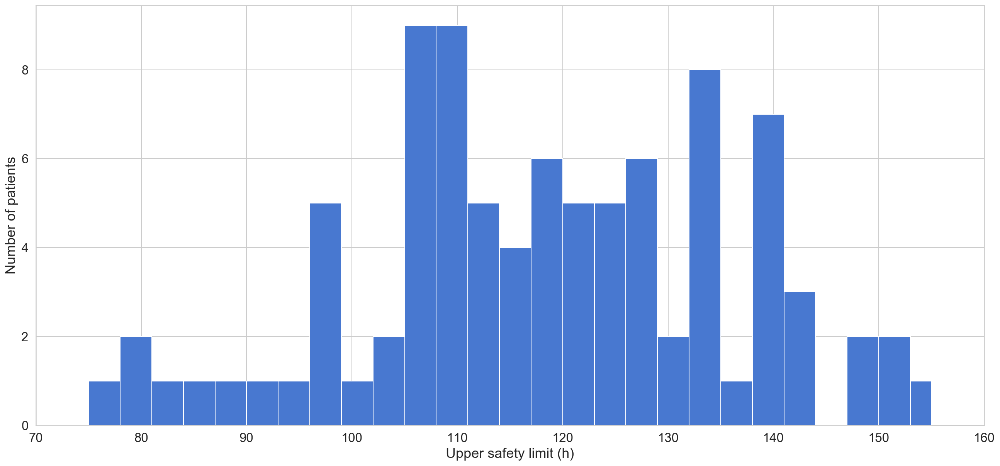

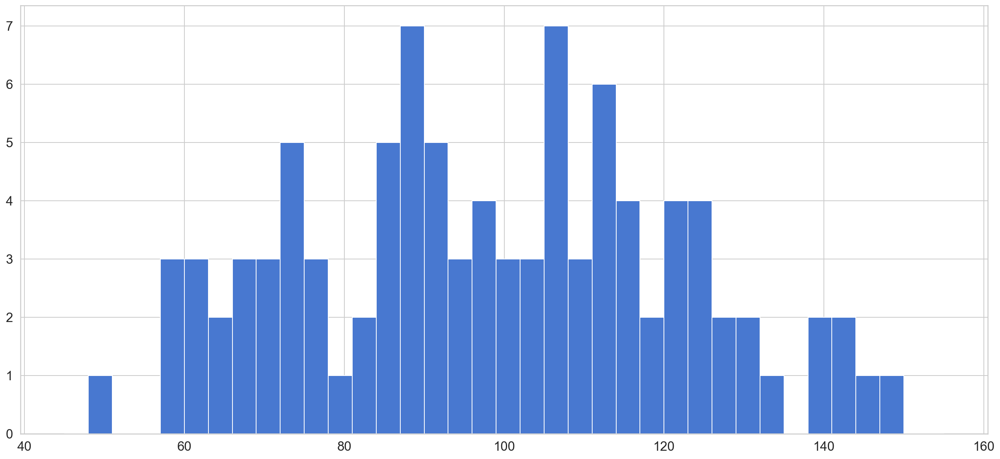

In [679]:

variable_of_interest='Heart Rate'
states=[3*i+46 for i in np.arange(37)]
header=[str(i) for i in states]
variable_of_interest='Heart Rate'
 
def bin(x):
    
    #if x<=40:
        #return int(40)
    #if x>=160:
        #return int(160)    
    if x%3==0:
        return int(x+1)
    if x%3==1:
        return int(x)
    if x%3==2:
        return int(x-1)


def F(f,i):
    return np.sum(f[0:i+1])
#################################
##### Belief and initial state dist
bins=states+[156]
bins=np.array(bins)-1

patients=range(1,100)
how_many_std=3
num_patients=np.size(patients)
true_thresholds=np.zeros(num_patients)
variable_of_interest='Heart Rate'

for patient_num in np.arange(num_patients):
    aa=dataframe_collection[patient_num]
    values=aa[variable_of_interest].dropna()
    threshold=np.mean(values)+how_many_std*np.std(values)
    true_thresholds[patient_num]=threshold
    
b=true_thresholds

y, x, _ = plt.hist(b,bins)
belief=y/np.sum(y)
plt.xlabel('Upper safety limit (h)')
plt.ylabel('Number of patients')
plt.xlim(70,160)
plt.show()

##### First state dist
VAL=np.array([])
LOSS=np.zeros(num_patients)
first_state=np.zeros(num_patients)
enterance=[]
mm=5
for i in np.arange(1,num_patients):
    aa=dataframe_collection[i]
    values=aa[variable_of_interest].dropna()
    first_state[i]=values[0]
    VAL=np.concatenate((VAL, values), axis=0)
y2,x2,_=plt.hist(first_state, bins)
initital_state_dist=y2/np.sum(y2)


#############################
####### policy

def W(k,i,r,m): 
    #global matrix_optimum_W
    #if k==T:
        #matrix_optimum_W=np.zeros((E,N,N+1,E,2))-2
    if k<=0 :
        matrix_optimum_W[k][i][r][m][1]=0
        return 0    
    if matrix_optimum_W[k][i][r][m][0]>=0:
        return matrix_optimum_W[k][i][r][m][0]   
    if i>r:
        L=0
        for j in np.arange(N):
            if P[i,j]>0:
                L=L+P[i,j]*W(k-1,j,r,m)
        C_NA=C_N*((F(f,i)-F(f,r))/(1-F(f,r))) + alpha* L
        if phi(m)<1-1e-6:
            if F(f,i)>=1-1e-6:     
                C_A=0
            else: 
                R=0
                for j in np.arange(N):
                    if P[i,j]>0:
                        R=R+P[i,j]*W(k-1,j,i,m+1)
                C_A=((1-F(f,i))/(1-F(f,r)))* (C_P+ alpha*R)
            optimum_value_function=min( C_NA, (1-phi(m))* C_A+phi(m)*C_NA )
            optimum_action=np.argmin([C_NA, (1-phi(m))* C_A+phi(m)*C_NA ])
        else:
            optimum_value_function=C_NA
            optimum_action=0     
    if i<=r:
        value=0
        for j in np.arange(N):
            if P[i,j]>0:
                value=value+P[i,j]*W(k-1,j,r,m)
        optimum_value_function=alpha*value
        optimum_action=0 
    matrix_optimum_W[k][i][r][m][0]=optimum_value_function
    matrix_optimum_W[k][i][r][m][1]=optimum_action
    return optimum_value_function







r=-1
i=2
m=1
alpha=1
N=np.size(belief)
f=belief
P=TPM

E=400
matrix_optimum_W=np.zeros((E,N,N+1,E,2))-2

### if phi=1-exp(-m), the Y-axis would go up to 8 in 1000 periods
def phi(m):
    p=1/(1+np.exp(5-0.1*m))
    if p>=1:
        p=1
    return p


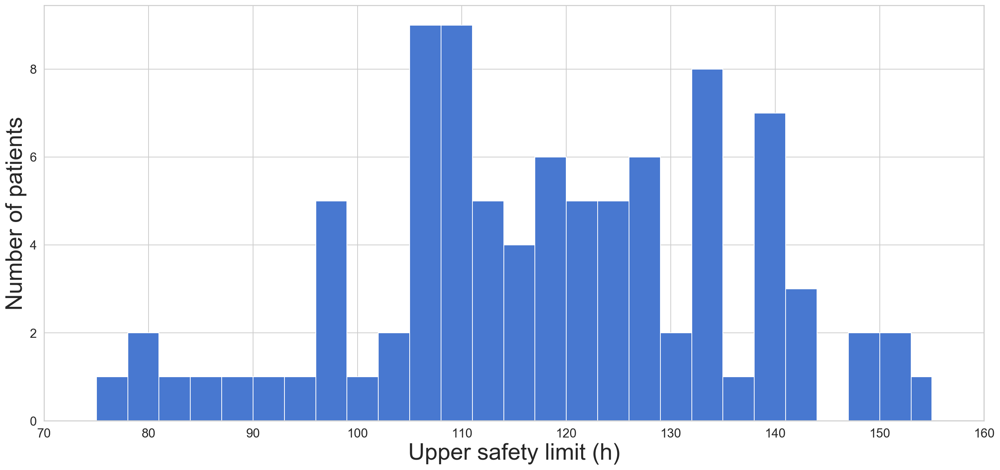

In [681]:
y, x, _ = plt.hist(b,bins)
belief=y/np.sum(y)
plt.xlabel('Upper safety limit (h)', size='30')
plt.ylabel('Number of patients', size='30')
plt.xlim(70,160)
plt.show()

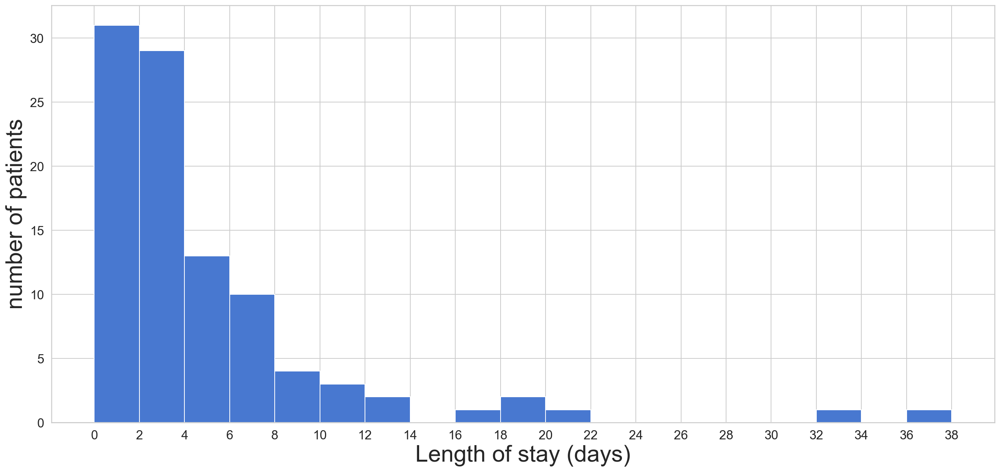

2017-12-05 04:49:00
2015-02-08 23:21:00


In [265]:
variable_of_interest='Heart Rate'        
num_patients=100
LOSS=np.zeros(num_patients)
enterance=[]
for i in np.arange(1,num_patients):

    aa=dataframe_collection[i]
    time=aa[variable_of_interest +' ChartDate'].dropna()
    LOS=time[np.size(time)-1]-time[0]
    enterance=enterance+[time[0]]
    #print(LOS)
    LOSS[i]=LOS.total_seconds()/(24*60*60)
  
y, x, _ =plt.hist(LOSS, bins=2*np.arange(20))
plt.xticks(2*np.arange(20))
#[0,5,10,15,20,25,30,35,40]
#plt.title('Histogram of LOS for cohort of patients', size=14)
plt.xlabel('Length of stay (days)', size=30)
plt.ylabel('number of patients', size=30)
plt.savefig('LOS_for_patients')
plt.show()
print(max(enterance))
print(min(enterance))

### How many periods

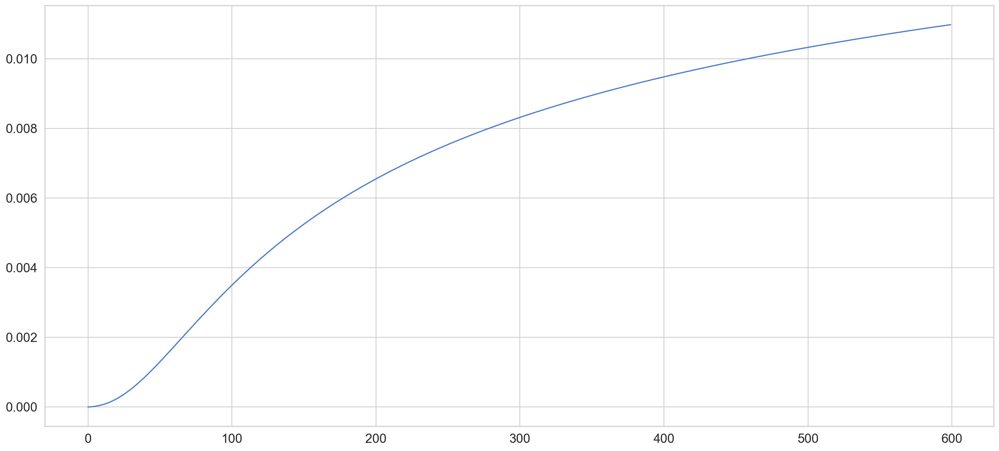

In [621]:
r=-1
i=2
m=1
alpha=1
N=np.size(belief)
f=belief
P=np.array(TPM)
C_N=1
C_P=0

E=1000
#matrix_optimum_W=np.zeros((E,N,N+1,E,2))-2

### if phi=1-exp(-m), the Y-axis would go up to 8 in 1000 periods
def phi(m):
    p=1/(1+np.exp(5-0.1*m))
    if p>=1:
        p=1
    return p

TT=600
y_shallow_phi=np.zeros(TT)

for T in np.arange(TT):        
    y_shallow_phi[T]=W(T,i,r,0)
    
plt.plot(np.arange(TT),y_shallow_phi)
plt.show()

In [752]:
alpha=np.exp(-1/(6.18*24*60))
alpha

0.9998876366620282

In [620]:
T=399
100*(y_shallow_phi[T]-y_shallow_phi[T-1])/y_shallow_phi[T-1]

0.10365532793855596

In [606]:
L=np.copy(y_shallow_phi)
(L[399]-L[100])/(3*L[100])

0.5688452169385714

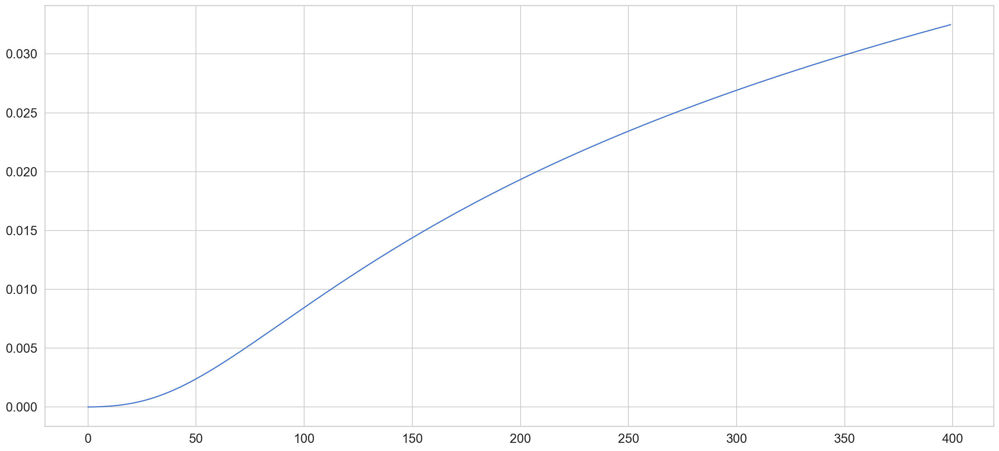

In [622]:
r=-1
i=2
m=1
alpha=1
N=np.size(belief)
f=belief
P=np.array(TPM)
C_N=1
C_P=0

E=500
matrix_optimum_W=np.zeros((E,N,N+1,E,2))-2

### if phi=1-exp(-m), the Y-axis would go up to 8 in 1000 periods
def phi(m):
    p=1/(1+np.exp(5-0.25*m))
    if p>=1:
        p=1
    return p

TT=400
y_shallow_phi=np.zeros(TT)

for T in np.arange(TT):        
    y_shallow_phi[T]=W(T,i,r,0)
    
plt.plot(np.arange(TT),y_shallow_phi)
plt.show()

In [627]:
T=399
100*(y_shallow_phi[T]-y_shallow_phi[T-1])/y_shallow_phi[T-1]

0.15290901259929443

### How many times patine exceeds 120 bpm

In [241]:
#exceed=np.zeros(num_patients)
#exceed_P=np.zeros(num_patients)
%store -r TPMML
P=TPMML
P=np.array(P)

num_experiment=10
experiments=np.zeros((2,num_experiment))
for exp in np.arange(num_experiment):
    
    count=0
    count_P=0
    counter_t=-1

    for patient_num in np.arange(1,100):
        #print(patient_num)
        aa=dataframe_collection[patient_num]
        values=aa[variable_of_interest].dropna()
        time=aa['Heart Rate ChartDate'].dropna()
    
        values=np.array(values)
        time=np.array(time)
    
        pred=all_predictions[patient_num]    
        values[pred>0]=-1 

        counter=-1
        done=-1
    
    
        for q in np.arange(np.size(values)):
            if (values[q]<=155)&(values[q]>=45):
                counter=counter+1
                counter_t=counter_t+1
                if bin(values[q])>=bin(120):
                    count=count+1
            
                if counter==0:
                    done=done+1
                    if done==0:
                        init=np.where(np.array(states)==bin(values[q]))[0][0]
            
                if counter>=0:
                    index=np.random.choice(np.arange(37), p=P[init,:])
                    i=states[index]
                    if bin(i)>=bin(120):
                        count_P=count_P+1
                    init=index
  

    total_time=counter_t
    experiments[0,exp]=100*count/total_time
    experiments[1,exp]=100*count_P/total_time
    
    


print('Real patient excceds 120 bpm at following number of time')
#print(100*count/total_time)
print(np.mean(experiments[0,:]))
print('Simulated patient excceds 120 bpm at following number of time')
#print(100*count_P/total_time)
print(np.mean(experiments[1,:]))

Real patient excceds 120 bpm at following number of time
4.231303328757996
Simulated patient excceds 120 bpm at following number of time
3.985776322232122
